In [ ]:
import tensorflow.keras as keras
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Flatten, Dense, Lambda, Reshape
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.datasets import mnist
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras import backend 
from tensorflow.keras.utils import to_categorical
from keras.layers.merge import concatenate as concat

import numpy as np
import matplotlib.pyplot as plt

In [ ]:
from tensorflow.python.framework.ops import disable_eager_execution
disable_eager_execution()

In [ ]:
import os
import warnings
import tensorflow as tf
warnings.filterwarnings("ignore")
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

Loading MNIST digit dataset

In [ ]:
(train_data, train_lable), (test_data, test_lable) = mnist.load_data()
onehot_train_lable = to_categorical(train_lable)

Image Preprocessing : Reshape and Normalization

In [ ]:
train_data = train_data.reshape(train_data.shape[0], 28, 28, 1)
test_data = test_data.reshape(test_data.shape[0], 28, 28, 1)
input_shape = (28, 28, 1)

train_data = train_data.astype('float32') /255
test_data = test_data.astype('float32') /255

In [ ]:
valid_idx = np.random.choice(range(len(test_data)), 100)
valid_data = test_data[valid_idx]
valid_lable = test_lable[valid_idx]

In [ ]:
onehot_valid_lable = to_categorical(valid_lable)

**Encoder**

Encoder construction by using imported layers in previous parts. Then mean and standard deviation values of flatten samples in latent space can be calculated in order to produce new outputs. Encoding part includes 2D convolution layers whose filter number can be optimized. The relu function is employed to behave non-linear besides preventing gradient vanishing. 
Batch Normalization is utilized to maintain mean and standard deviation of each convolution layer inputs at 0 and 1, respectively. 

Encoder parameters should be learned and optimized in order to reduce expectation loss which is defined as (mean+exp(std/2)*epsilon). 

Finally, we pass input through layers to produce new data by means of std and mean values.

In [ ]:
# Encoder
input = Input(shape=input_shape)
conv1 = Conv2D(filters=256, kernel_size=3, strides=2, padding='same', activation='relu')(input)
batch_Normalization1 = BatchNormalization()(conv1)
conv2 = Conv2D(filters=128, kernel_size=3, strides=2, padding='same', activation='relu')(batch_Normalization1)
batch_Normalization2 = BatchNormalization()(conv2)
flatten = Flatten()(batch_Normalization2)
FC1 = Dense(20, activation='relu')(flatten)
batch_Normalization3 = BatchNormalization()(FC1)
mean = Dense(2 , name='latent_mu')(batch_Normalization3)
standard_deviation = Dense(2 , name='latent_sigma')(batch_Normalization3)

Instructions for updating:
Colocations handled automatically by placer.


In [ ]:
def sample_reparameterize(args):
  mean, standard_deviation = args
  batch = backend.shape(mean)[0]
  dim = backend.int_shape(mean)[1]
  epsilon = backend.random_normal(shape=(batch, dim))
  return mean+backend.exp(standard_deviation/2)*epsilon

In [ ]:
sample = Lambda(sample_reparameterize, output_shape=(2, ))([mean, standard_deviation])
encoder = Model(input, [mean, standard_deviation, sample])
encoder.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 28, 28, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 14, 14, 256)  2560        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 14, 14, 256)  1024        conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 7, 7, 128)    295040      batch_normalization[0][0]        
______________________________________________________________________________________________

**Decoder**

Decoder part use deconvolution layers to produce new distinct data which is related to specific classes. 
Finally, we pass input samples through layers to produce new output data. these samples have been produced in Reparameterization trick which is related to the last encoder layer.
Sigmoid activation function is employed for last decoder layer due to capability of NN to calculate binary cross-entropy loss.


In [ ]:
# Decoder Definition
conv_shape = backend.int_shape(batch_Normalization2)
Decoder_input = Input(shape=(2, ))
deconv1 = Dense(conv_shape[1] * conv_shape[2] * conv_shape[3], activation='relu')(Decoder_input)
batch_normalization4 = BatchNormalization()(deconv1)
deconv2 = Reshape((conv_shape[1], conv_shape[2], conv_shape[3]))(batch_normalization4)
deconv3 = Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', activation='relu')(deconv2)
batch_normalization5 = BatchNormalization()(deconv3)
deconv4 = Conv2DTranspose(filters=256, kernel_size=3, strides=2, padding='same', activation='relu')(batch_normalization5)
batch_normalization6 = BatchNormalization()(deconv4)
output = Conv2DTranspose(filters=1, kernel_size=3, activation='sigmoid', padding='same')(batch_normalization6)

In [ ]:
decoder = Model(Decoder_input, output)
decoder.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 2)]               0         
_________________________________________________________________
dense_1 (Dense)              (None, 6272)              18816     
_________________________________________________________________
batch_normalization_3 (Batch (None, 6272)              25088     
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 14, 14, 128)       147584    
_________________________________________________________________
batch_normalization_4 (Batch (None, 14, 14, 128)       512       
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 28, 28, 256)       2951

**Variational AutoEncoder**

Encoder output consists of mean, std and sample which we require the last one in order to create new output which is different from real train data but specified in recognizable classes.

In order to compile model, we need KL-divergance besides binary crossentropy loss to reach a continuous and complete latent space to combine differnt features for high needed creativity. Total loss includes 50 percent of each loss which can be differed for any problem. 

In [ ]:
def kl_reconstruction_loss(true, pred):

  reconstruction_loss = binary_crossentropy(backend.flatten(true), backend.flatten(pred))*784
  kl_loss = 1 + standard_deviation - backend.square(mean) - backend.exp(standard_deviation)
  kl_loss = backend.sum(kl_loss, axis=-1)
  kl_loss *= -0.5
  return backend.mean(reconstruction_loss + kl_loss)

## A CallBack for Performace Check
here we write a callback to plot the generted numbers for a constant sample of size 100 after each epoch, so we can monitor the improvement procedure in the network. this call back is written for both VAEs and C-VAEs which will be specified using the conditional argument in the constructor.

In [ ]:
class PerformanceCheck(keras.callbacks.Callback):

    def __init__(self, conditional):

        super(keras.callbacks.Callback, self).__init__()
        self.conditional = conditional

    def on_epoch_end(self, epoch, logs=None):

        figure1 = np.zeros((28*10, 28*10, 1))
        figure2 = np.zeros((28*10, 28*10, 1))
        grid_x = np.linspace(-4, 4, 10)
        grid_y = np.linspace(-4, 4, 10)[::-1]

        for i, _ in enumerate(grid_y):
            for j, _ in enumerate(grid_x):

                if self.conditional:
                    generated = self.model.predict([valid_data[i*10+j].reshape((1, 28*28)), onehot_valid_lable[i*10+j].reshape((1, 10))])
                else:
                    sample = valid_data[i*10+j].reshape(1, 28, 28, 1)
                    generated = self.model.predict(sample)
                    
                digit = generated[0].reshape(28, 28, 1)
                figure1[i*28:(i+1)*28, j*28:(j+1)*28] = digit
                figure2[i*28:(i+1)*28, j*28:(j+1)*28] = valid_data[i*10+j].reshape(28, 28, 1)

        plt.figure(figsize=(10, 10))
        plt.title('generated')
        
        plt.imshow(figure1.reshape(280, 280), cmap="Greys_r")
        plt.show()

        plt.figure(figsize=(10, 10))
        plt.title('original')

        plt.imshow(figure2.reshape(280, 280), cmap="Greys_r")
        plt.show()

## Train and Test
we train the VAE in this cell and using the above callback we can monitor the process of generating numbers after each epoch. 

Train on 48000 samples, validate on 12000 samples
Epoch 1/50
48000/48000 [==============================] - ETA: 0s - loss: 232.9334

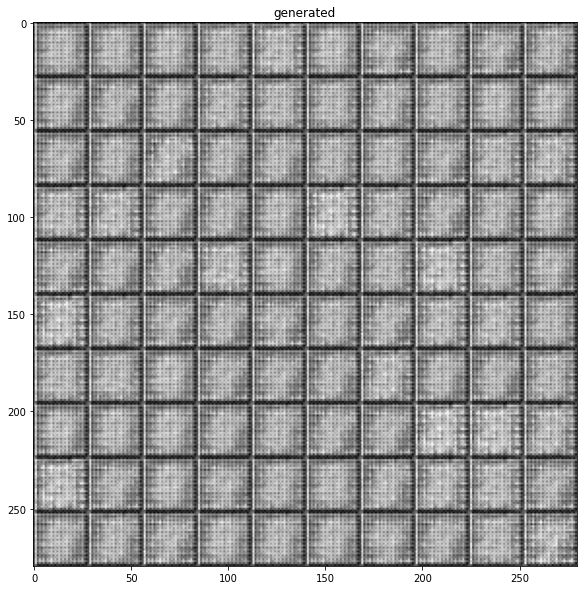

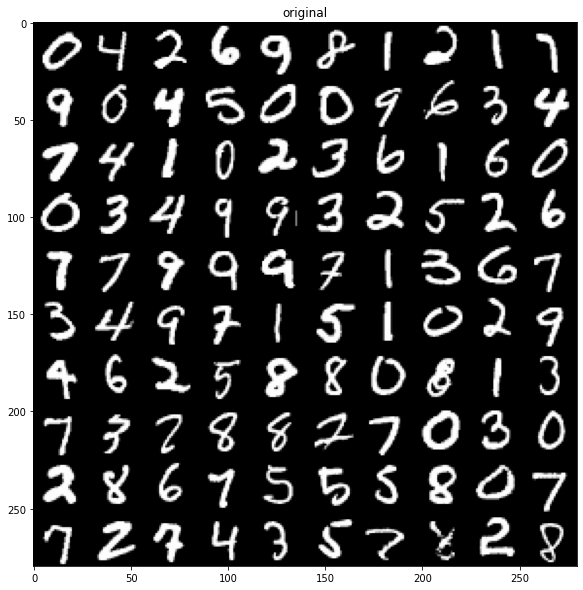

48000/48000 [==============================] - 31s 646us/sample - loss: 232.9334 - val_loss: 294.1882
Epoch 2/50
48000/48000 [==============================] - ETA: 0s - loss: 172.9548

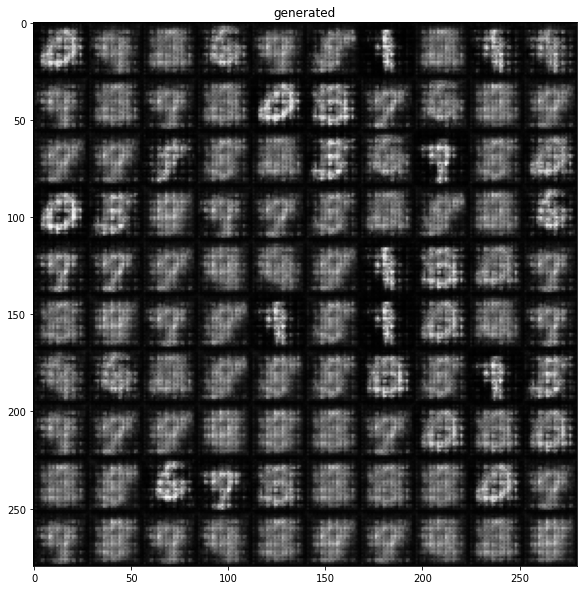

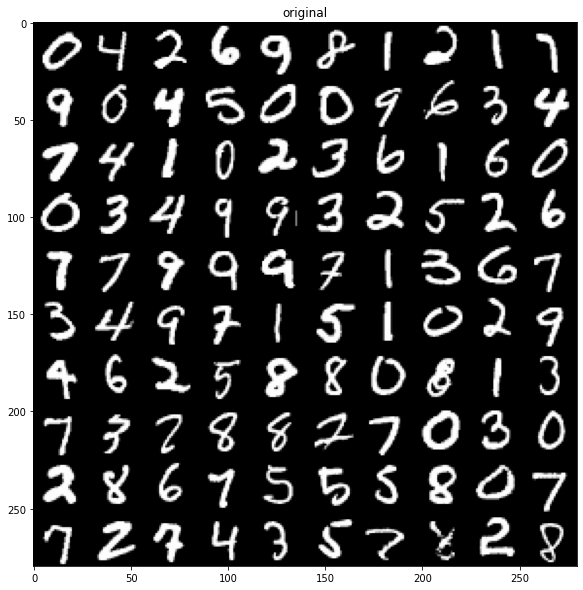

48000/48000 [==============================] - 26s 552us/sample - loss: 172.9548 - val_loss: 224.8382
Epoch 3/50
48000/48000 [==============================] - ETA: 0s - loss: 163.5443

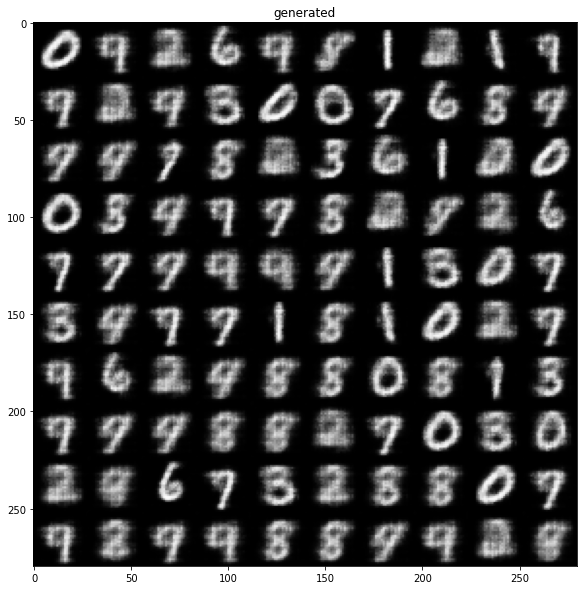

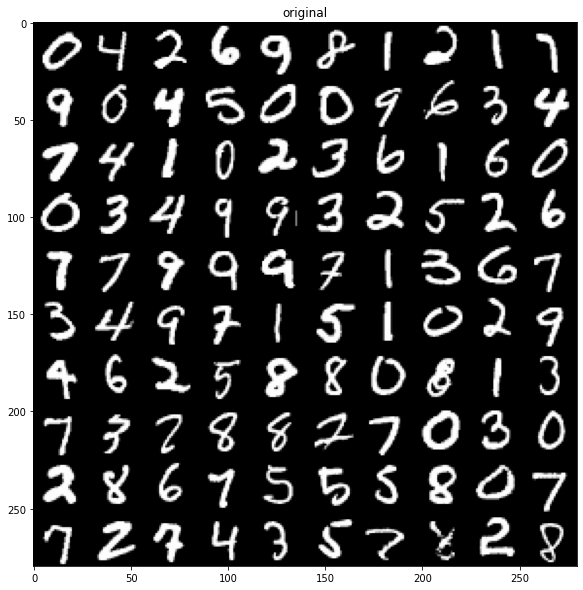

48000/48000 [==============================] - 27s 559us/sample - loss: 163.5443 - val_loss: 167.9133
Epoch 4/50
48000/48000 [==============================] - ETA: 0s - loss: 157.5353

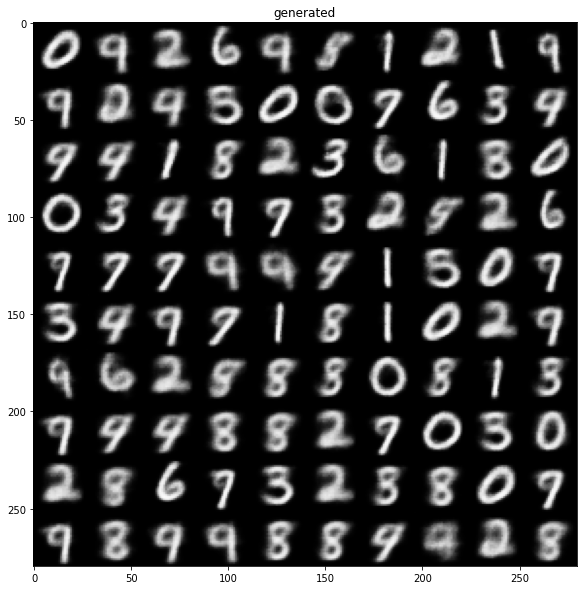

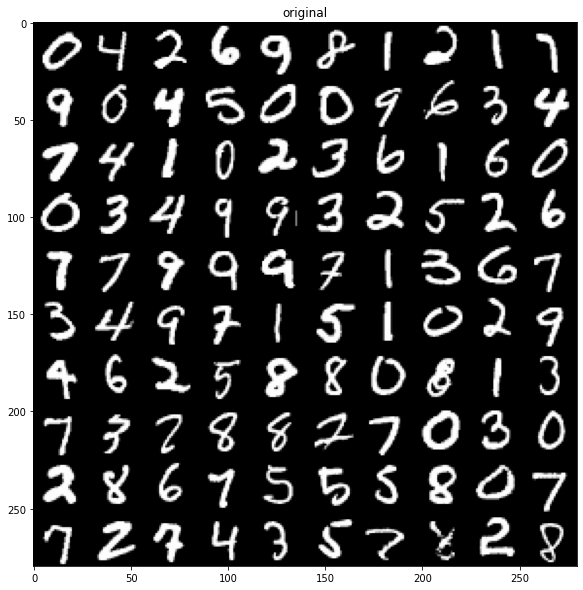

48000/48000 [==============================] - 27s 561us/sample - loss: 157.5353 - val_loss: 155.7861
Epoch 5/50
48000/48000 [==============================] - ETA: 0s - loss: 154.6285

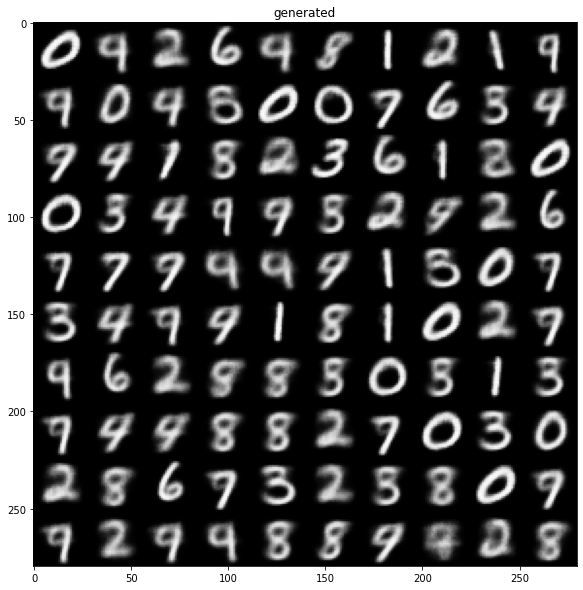

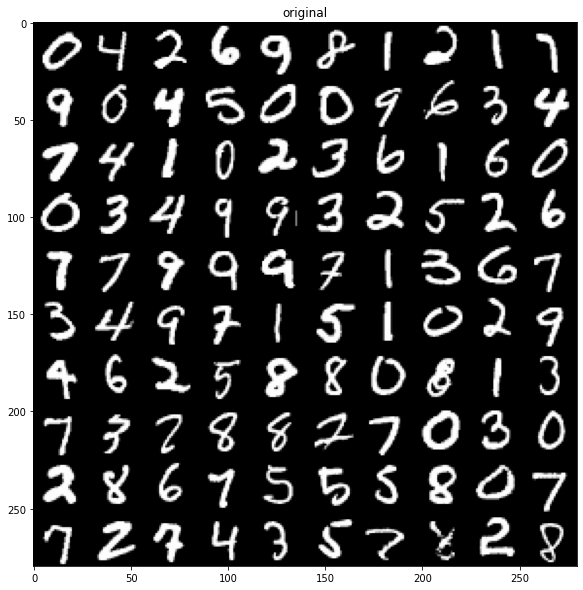

48000/48000 [==============================] - 27s 567us/sample - loss: 154.6285 - val_loss: 153.0722
Epoch 6/50
48000/48000 [==============================] - ETA: 0s - loss: 153.0520

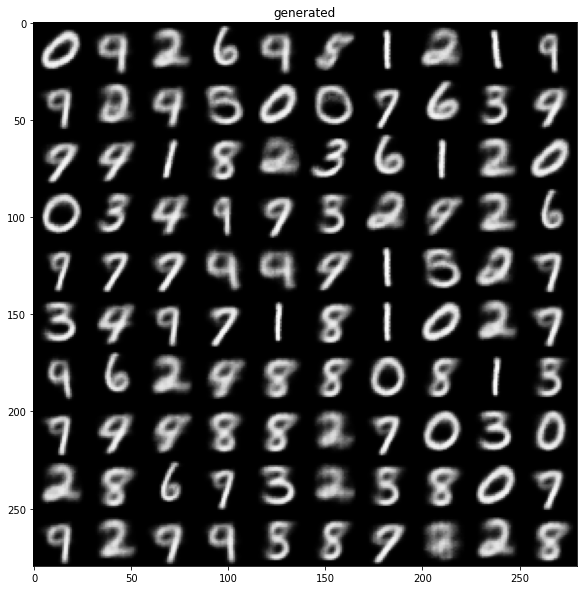

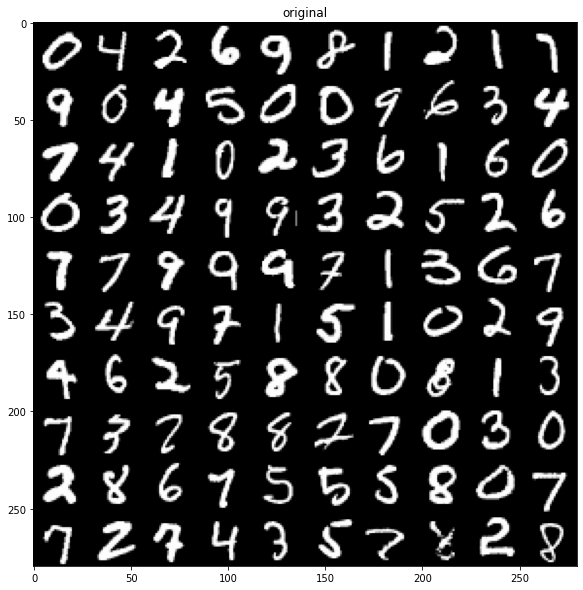

48000/48000 [==============================] - 27s 564us/sample - loss: 153.0520 - val_loss: 152.4607
Epoch 7/50
48000/48000 [==============================] - ETA: 0s - loss: 151.8521

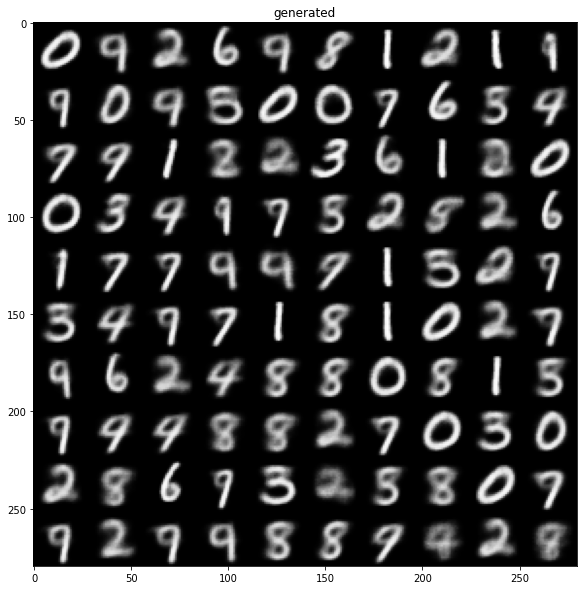

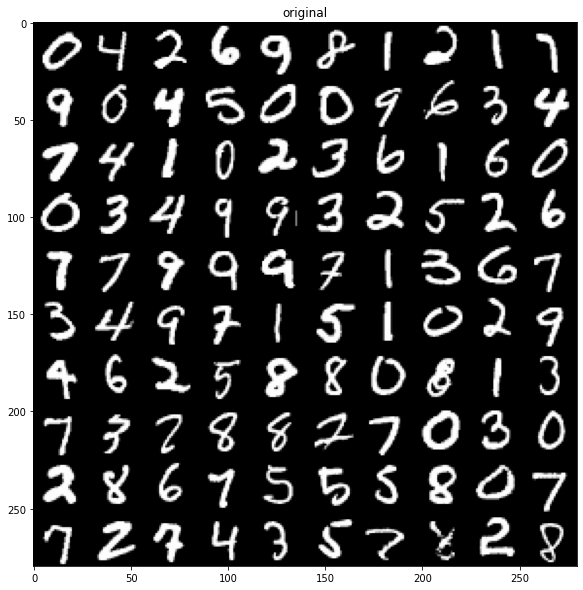

48000/48000 [==============================] - 27s 559us/sample - loss: 151.8521 - val_loss: 153.2901
Epoch 8/50
48000/48000 [==============================] - ETA: 0s - loss: 151.2972

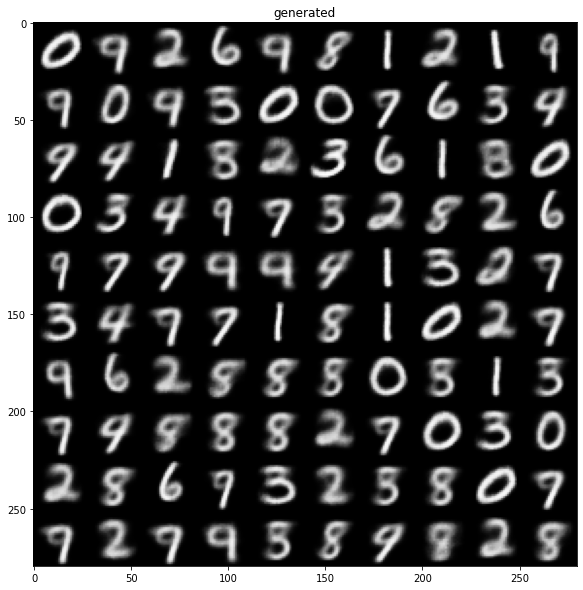

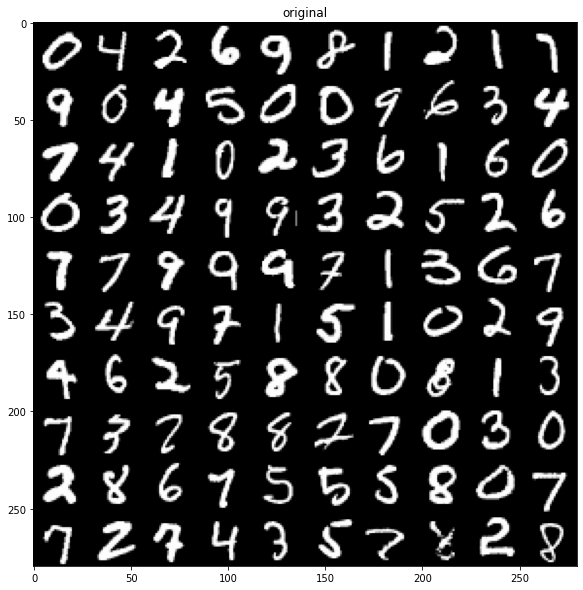

48000/48000 [==============================] - 27s 564us/sample - loss: 151.2972 - val_loss: 149.4212
Epoch 9/50
48000/48000 [==============================] - ETA: 0s - loss: 150.4253

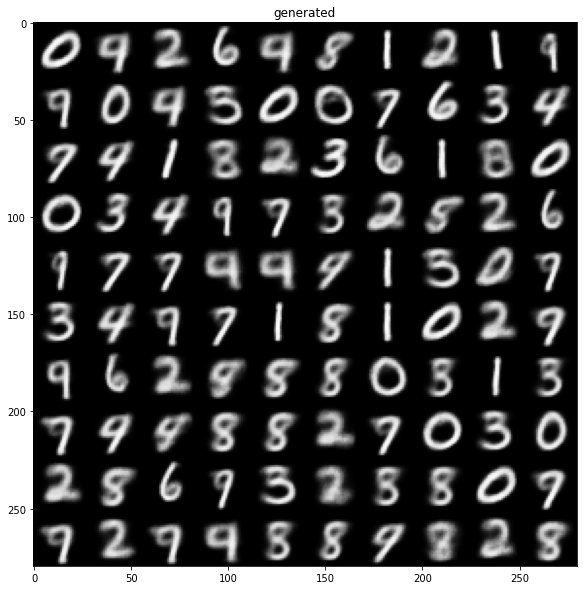

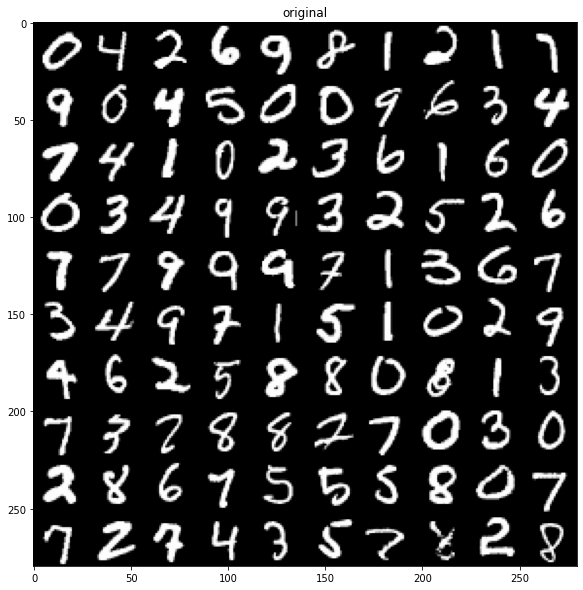

48000/48000 [==============================] - 27s 565us/sample - loss: 150.4253 - val_loss: 150.4619
Epoch 10/50
48000/48000 [==============================] - ETA: 0s - loss: 150.4061

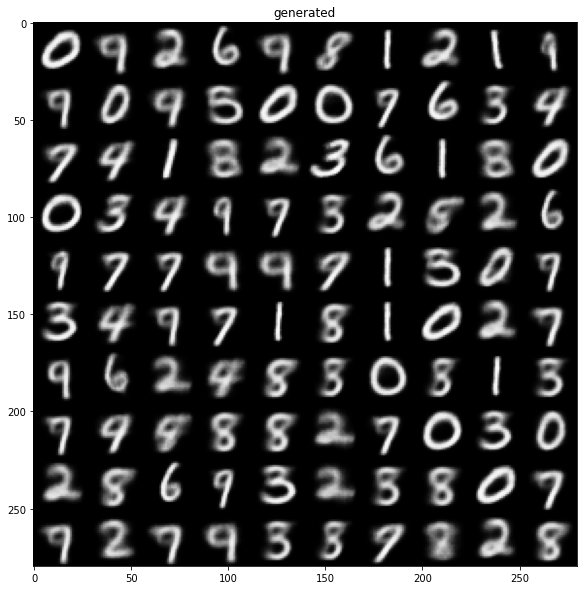

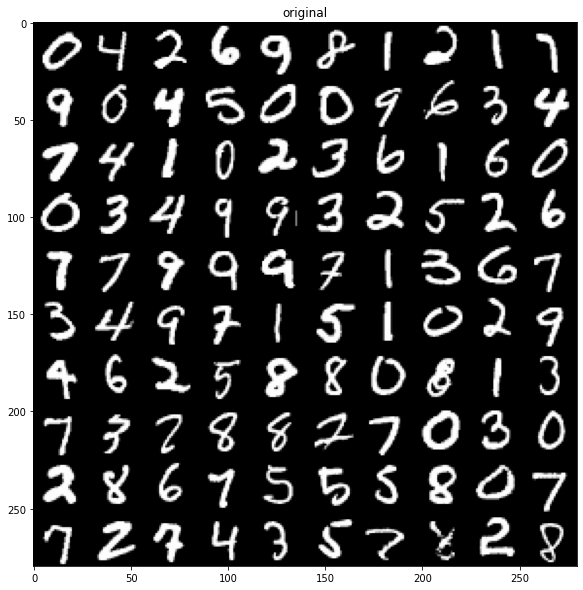

48000/48000 [==============================] - 27s 566us/sample - loss: 150.4061 - val_loss: 149.6930
Epoch 11/50
48000/48000 [==============================] - ETA: 0s - loss: 150.0650

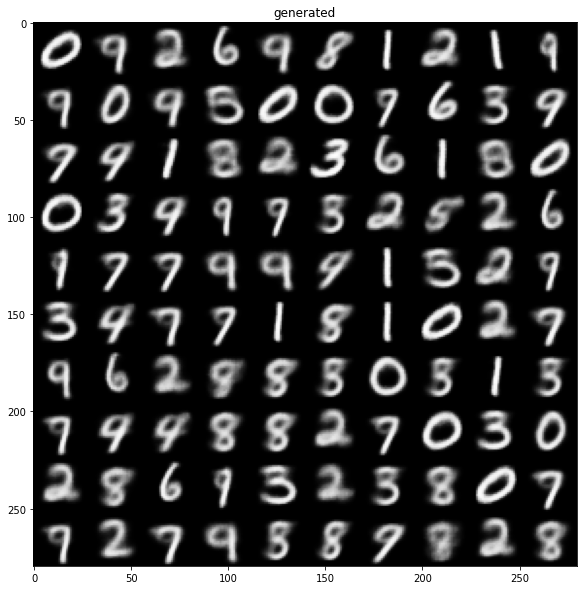

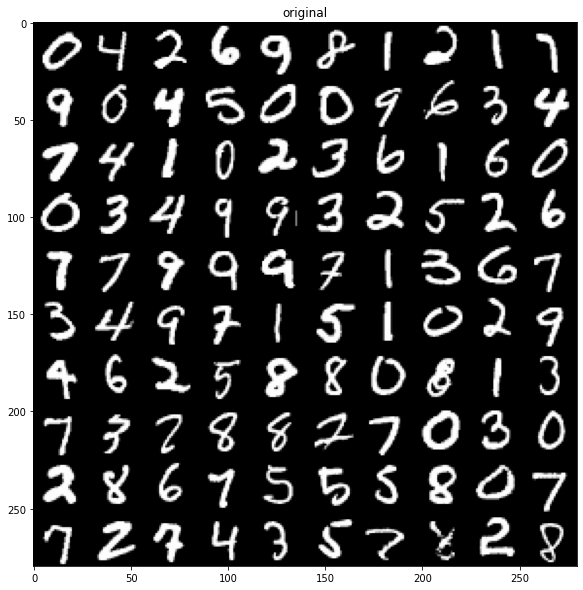

48000/48000 [==============================] - 27s 567us/sample - loss: 150.0650 - val_loss: 151.2314
Epoch 12/50
48000/48000 [==============================] - ETA: 0s - loss: 149.3230

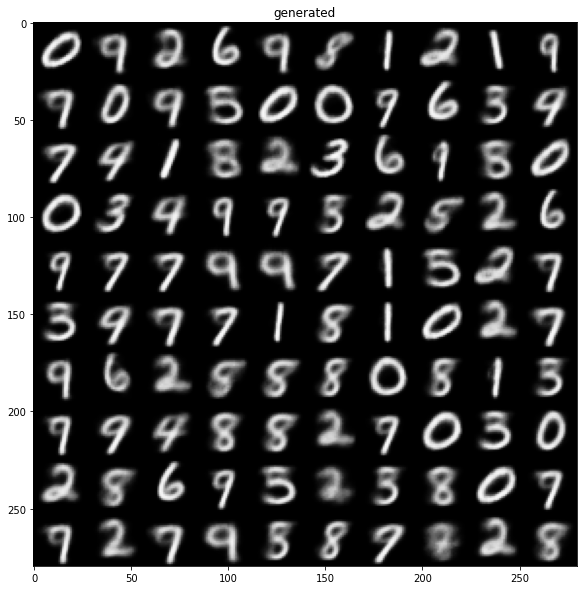

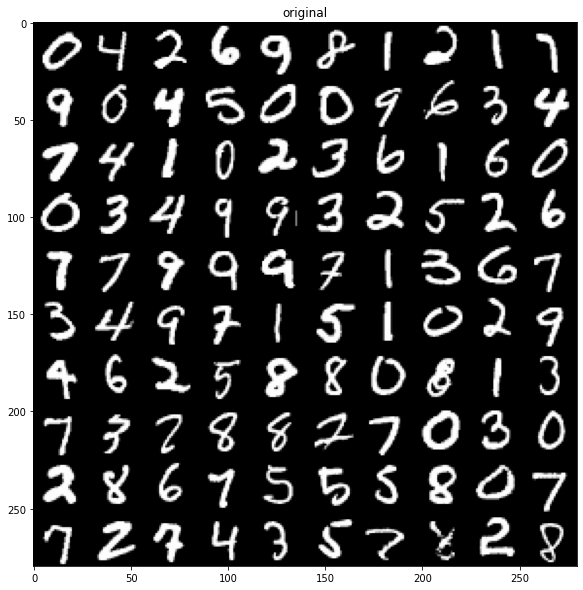

48000/48000 [==============================] - 27s 564us/sample - loss: 149.3230 - val_loss: 150.1087
Epoch 13/50
48000/48000 [==============================] - ETA: 0s - loss: 148.9005

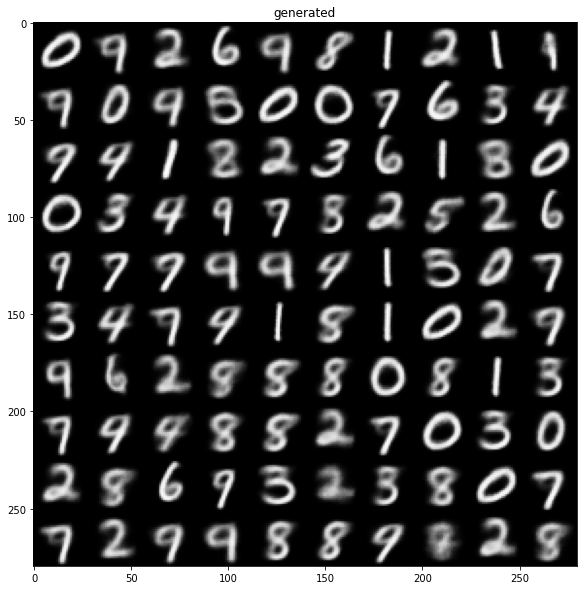

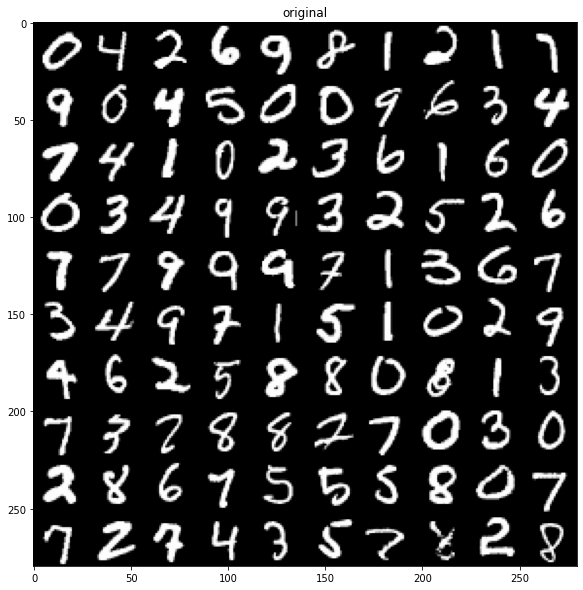

48000/48000 [==============================] - 27s 568us/sample - loss: 148.9005 - val_loss: 148.1108
Epoch 14/50
48000/48000 [==============================] - ETA: 0s - loss: 148.3659

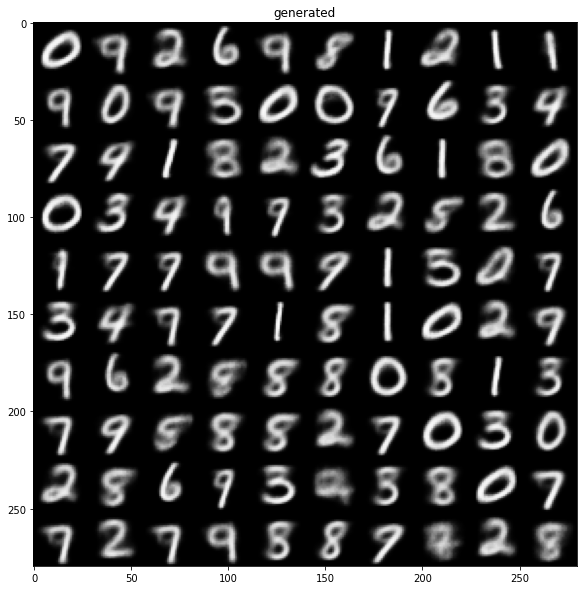

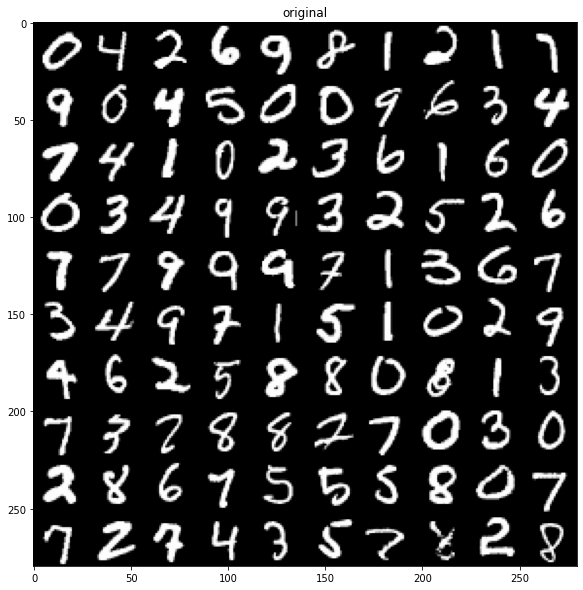

48000/48000 [==============================] - 27s 562us/sample - loss: 148.3659 - val_loss: 150.3008
Epoch 15/50
48000/48000 [==============================] - ETA: 0s - loss: 148.1821

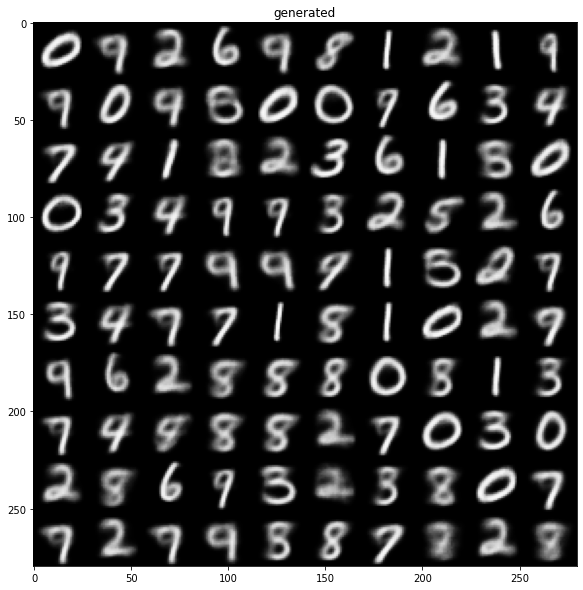

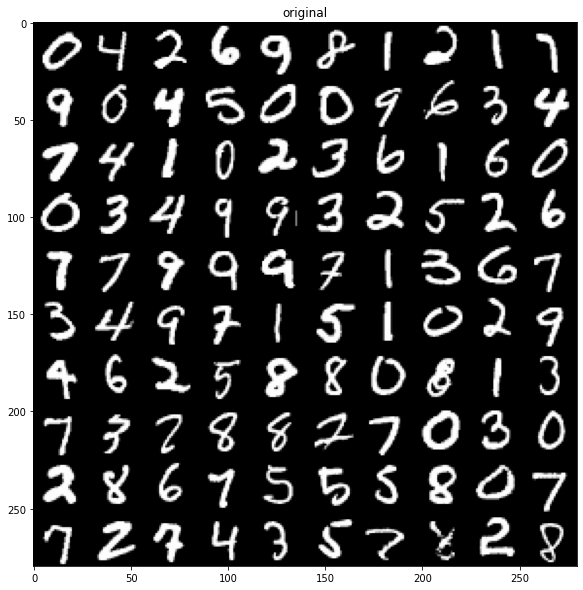

48000/48000 [==============================] - 27s 567us/sample - loss: 148.1821 - val_loss: 149.0522
Epoch 16/50
48000/48000 [==============================] - ETA: 0s - loss: 147.6548

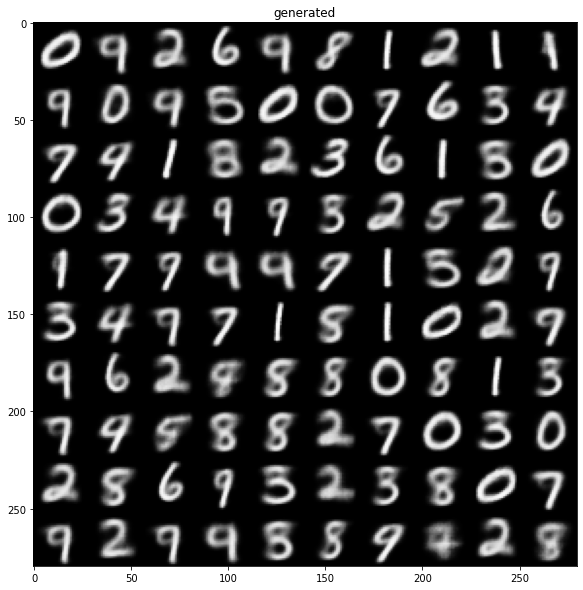

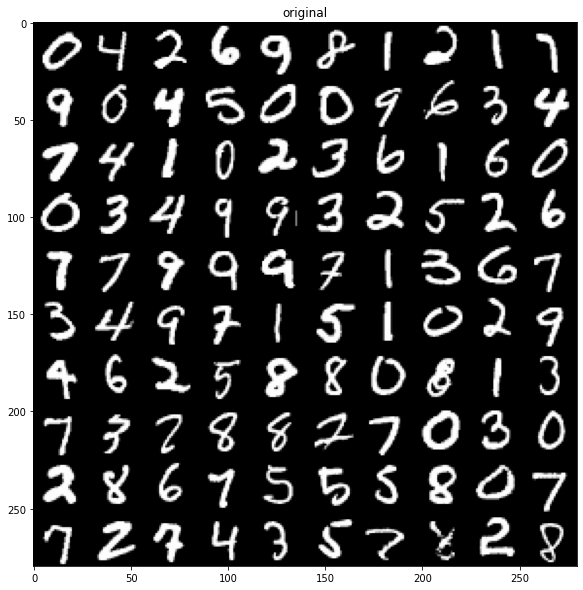

48000/48000 [==============================] - 27s 566us/sample - loss: 147.6548 - val_loss: 148.6545
Epoch 17/50
48000/48000 [==============================] - ETA: 0s - loss: 147.6806

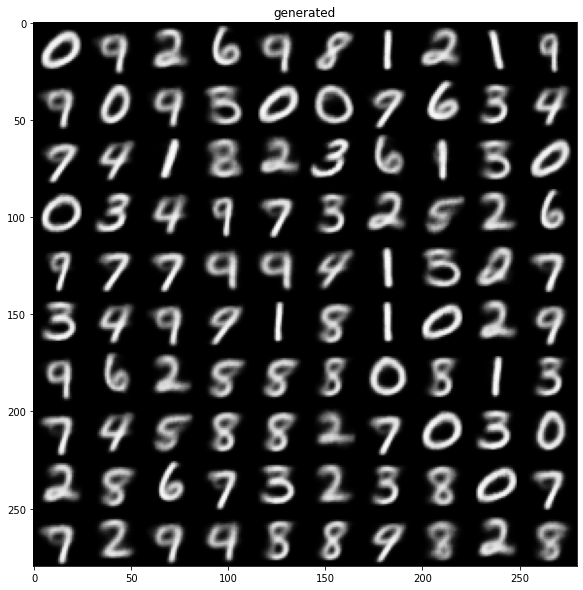

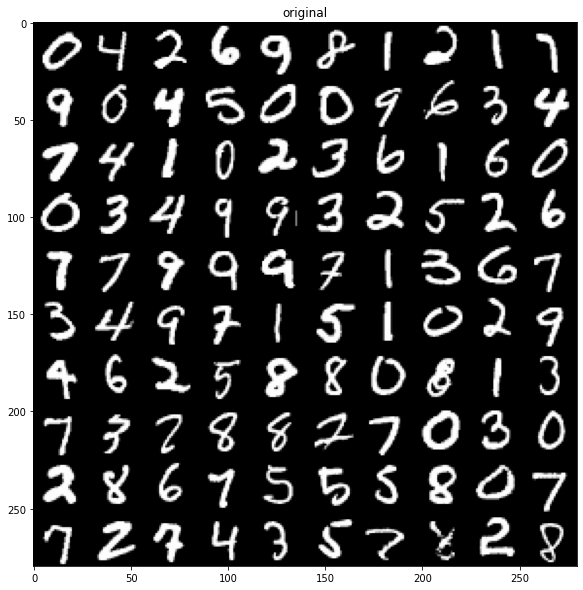

48000/48000 [==============================] - 27s 565us/sample - loss: 147.6806 - val_loss: 147.8957
Epoch 18/50
48000/48000 [==============================] - ETA: 0s - loss: 147.1336

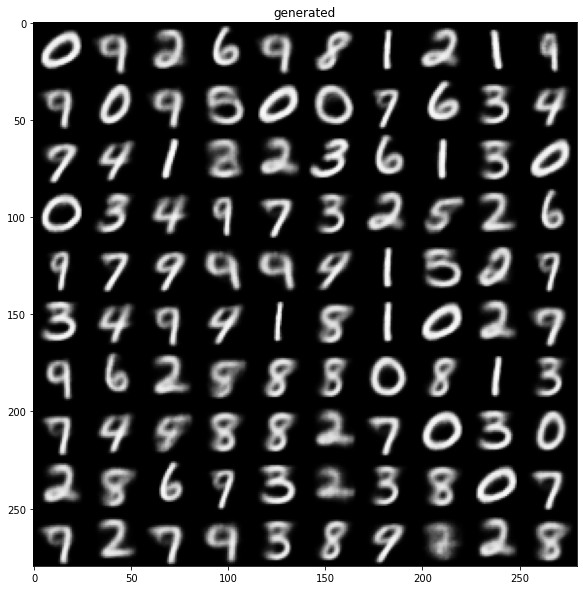

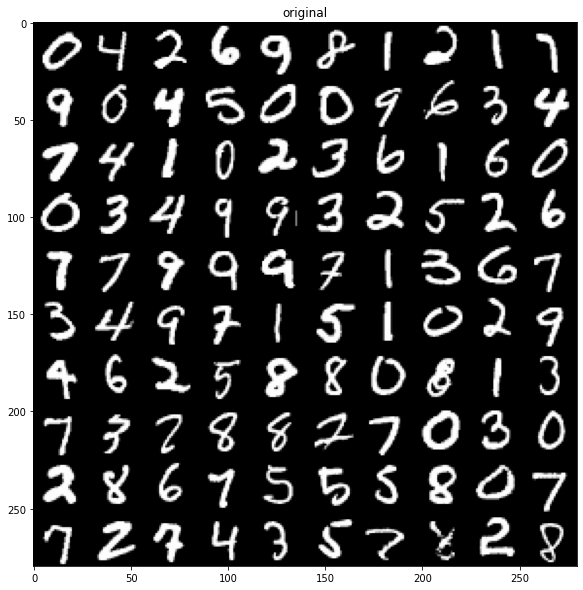

48000/48000 [==============================] - 27s 567us/sample - loss: 147.1336 - val_loss: 148.7578
Epoch 19/50
48000/48000 [==============================] - ETA: 0s - loss: 147.5257

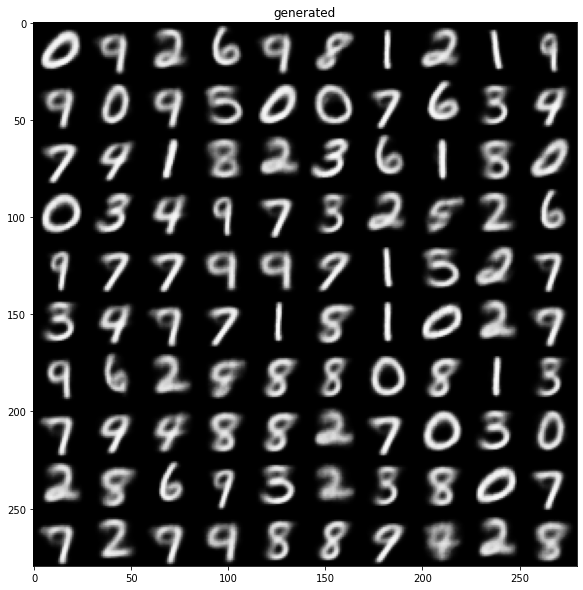

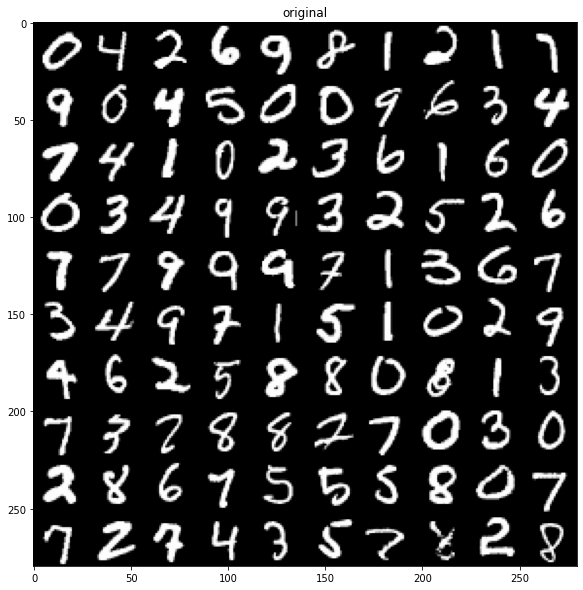

48000/48000 [==============================] - 27s 568us/sample - loss: 147.5257 - val_loss: 147.3800
Epoch 20/50
48000/48000 [==============================] - ETA: 0s - loss: 146.8944

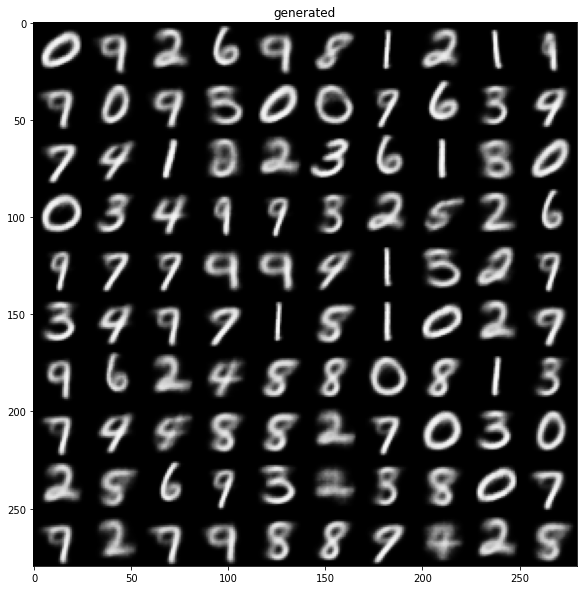

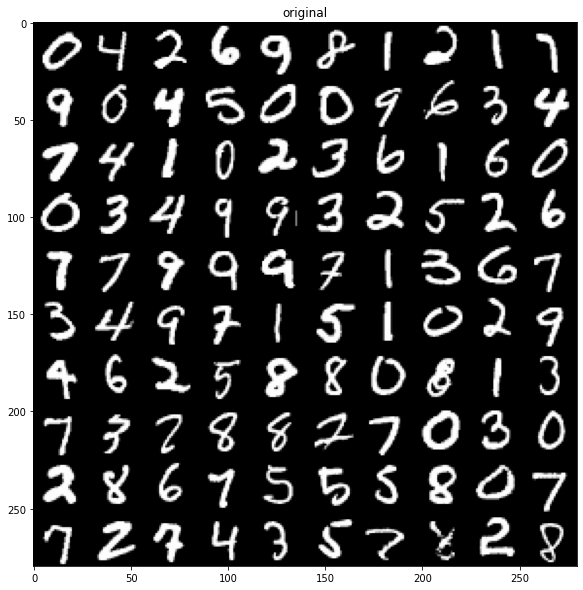

48000/48000 [==============================] - 27s 563us/sample - loss: 146.8944 - val_loss: 150.6407
Epoch 21/50
48000/48000 [==============================] - ETA: 0s - loss: 146.8479

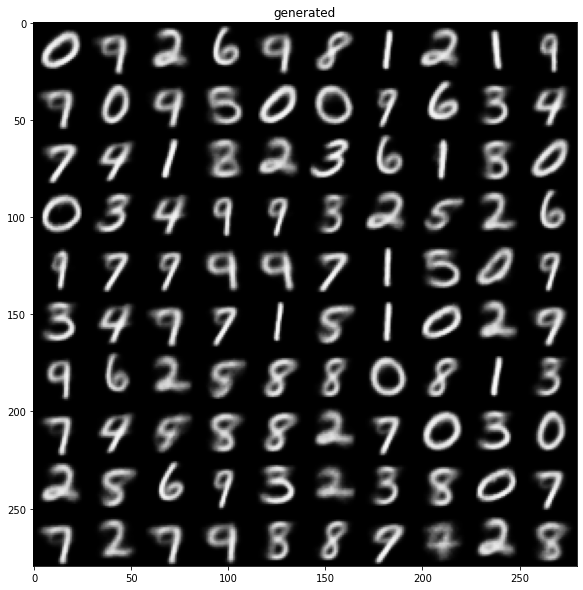

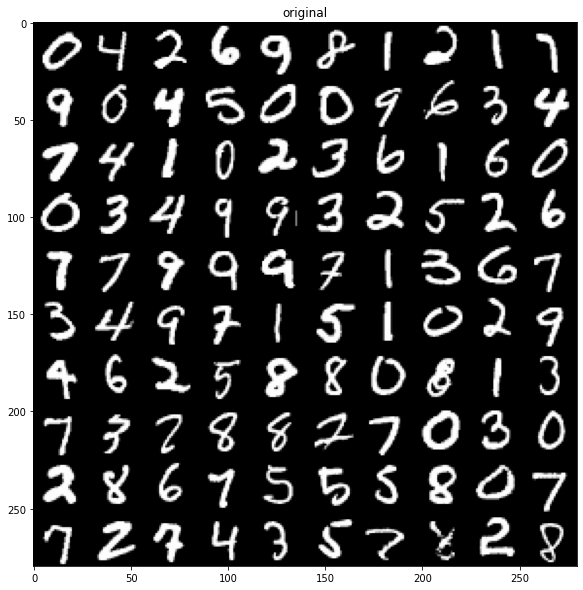

48000/48000 [==============================] - 27s 566us/sample - loss: 146.8479 - val_loss: 151.4592
Epoch 22/50
48000/48000 [==============================] - ETA: 0s - loss: 146.6096

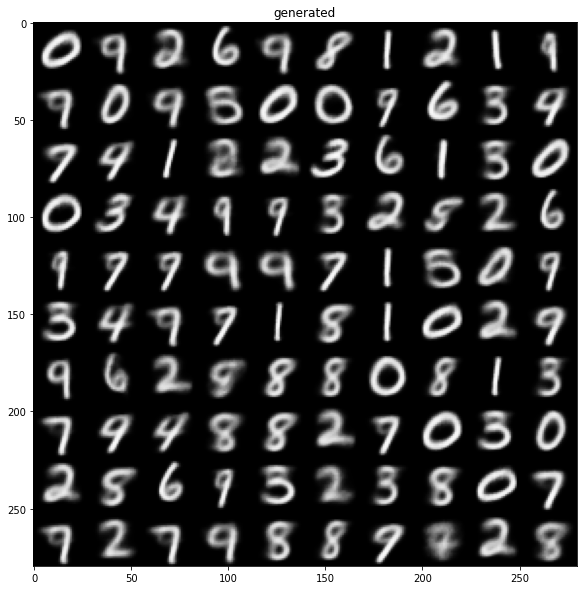

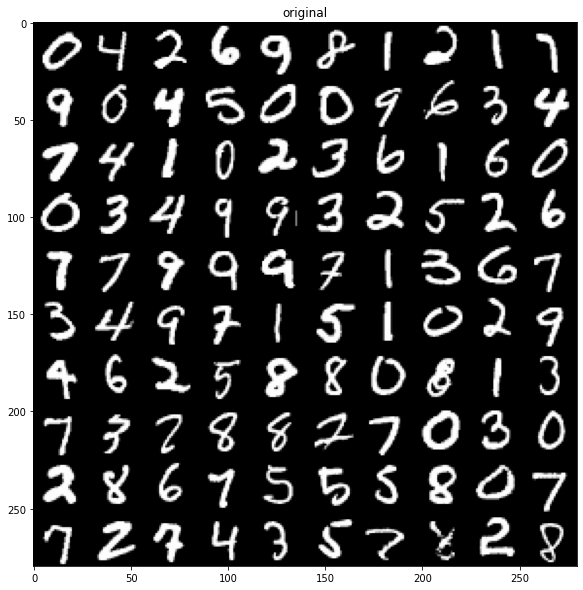

48000/48000 [==============================] - 27s 569us/sample - loss: 146.6096 - val_loss: 149.7593
Epoch 23/50
48000/48000 [==============================] - ETA: 0s - loss: 146.1833

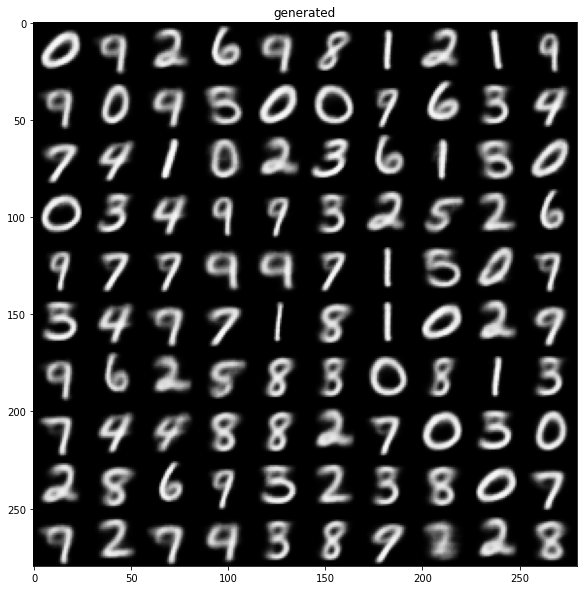

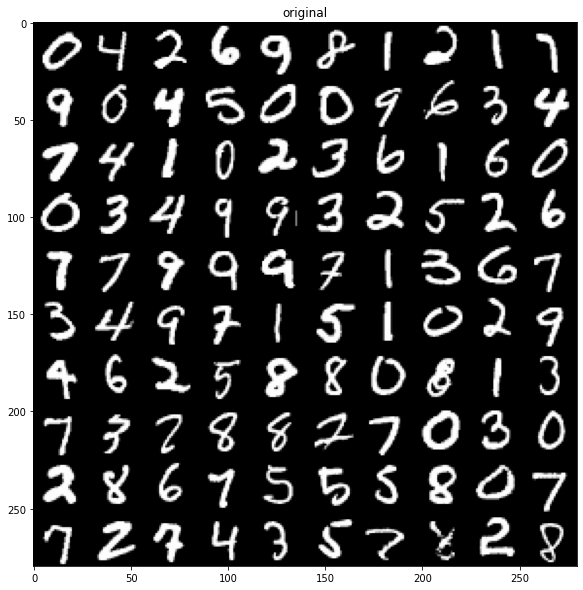

48000/48000 [==============================] - 27s 566us/sample - loss: 146.1833 - val_loss: 147.0090
Epoch 24/50
48000/48000 [==============================] - ETA: 0s - loss: 146.0013

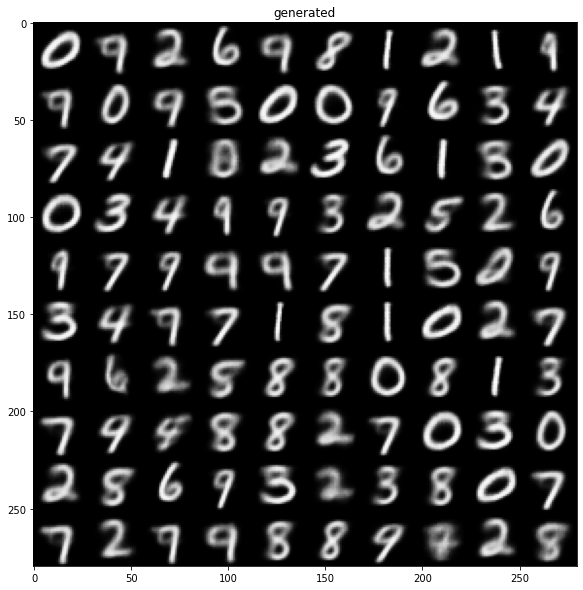

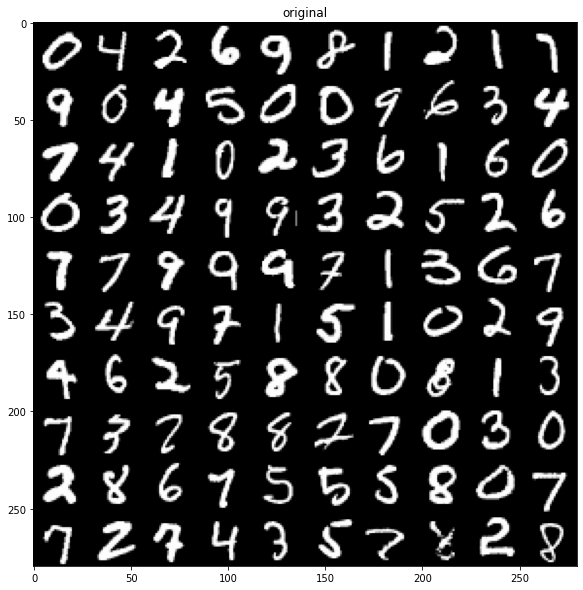

48000/48000 [==============================] - 28s 575us/sample - loss: 146.0013 - val_loss: 148.3201
Epoch 25/50
48000/48000 [==============================] - ETA: 0s - loss: 146.6021

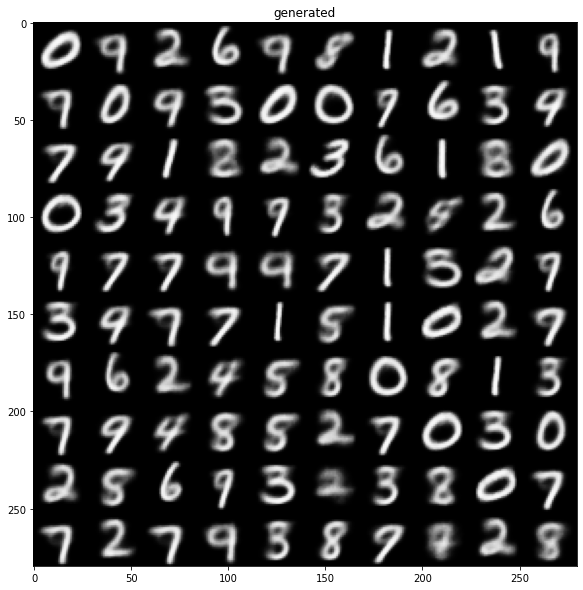

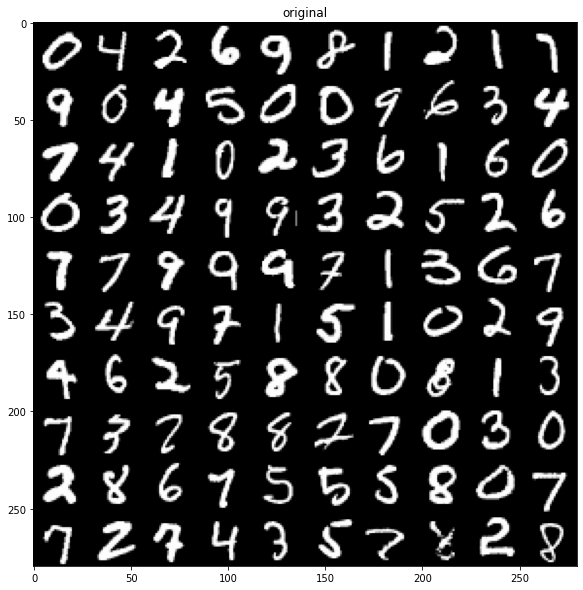

48000/48000 [==============================] - 27s 570us/sample - loss: 146.6021 - val_loss: 149.6996
Epoch 26/50
48000/48000 [==============================] - ETA: 0s - loss: 146.7571

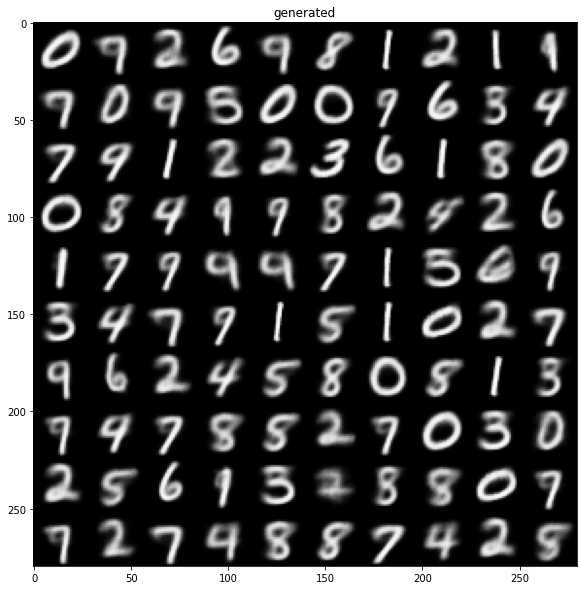

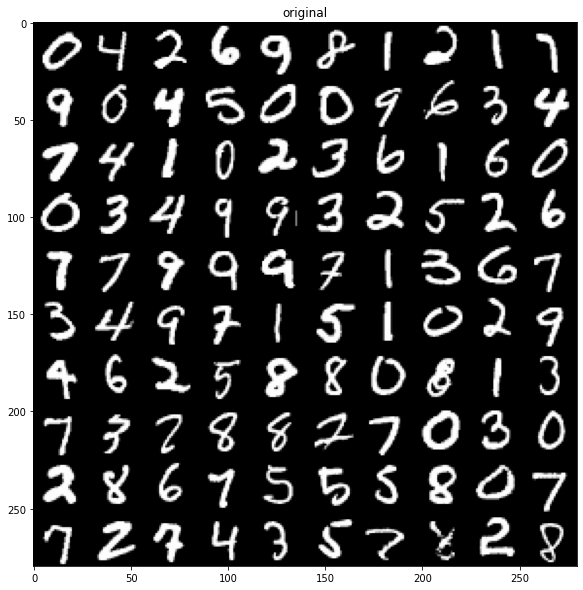

48000/48000 [==============================] - 28s 581us/sample - loss: 146.7571 - val_loss: 156.1875
Epoch 27/50
48000/48000 [==============================] - ETA: 0s - loss: 146.0796

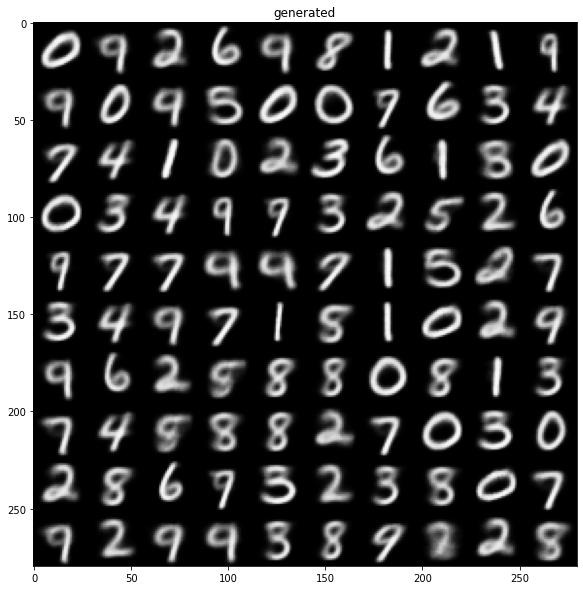

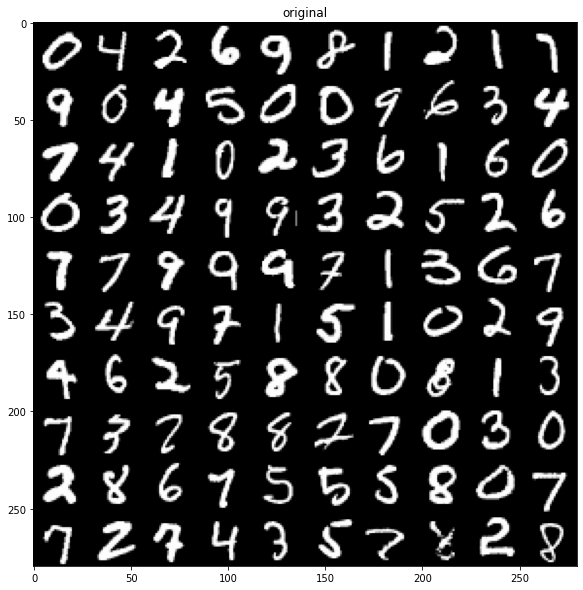

48000/48000 [==============================] - 28s 579us/sample - loss: 146.0796 - val_loss: 147.1825
Epoch 28/50
48000/48000 [==============================] - ETA: 0s - loss: 145.6572

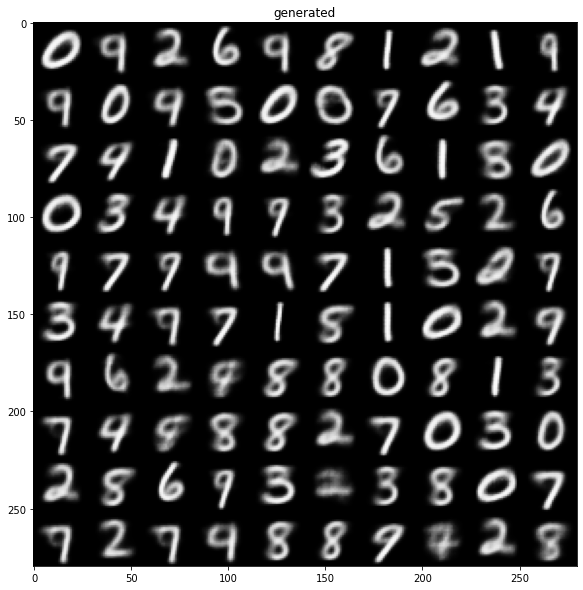

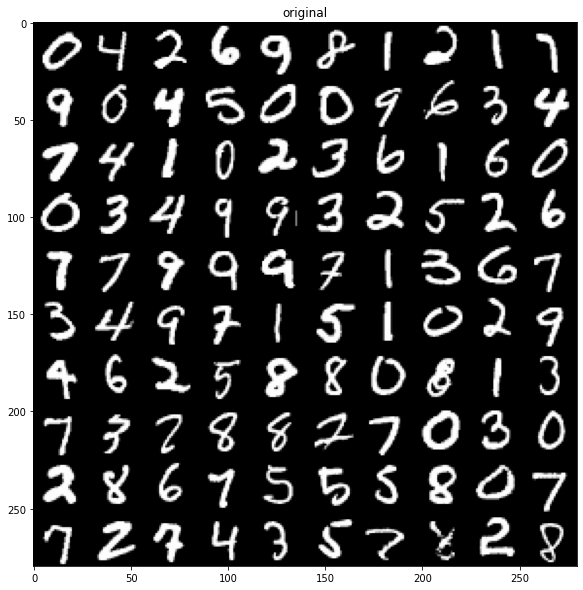

48000/48000 [==============================] - 28s 578us/sample - loss: 145.6572 - val_loss: 147.0885
Epoch 29/50
48000/48000 [==============================] - ETA: 0s - loss: 145.2444

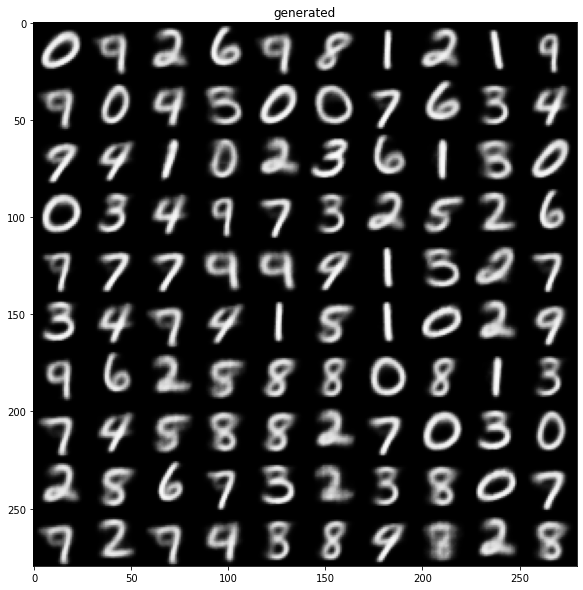

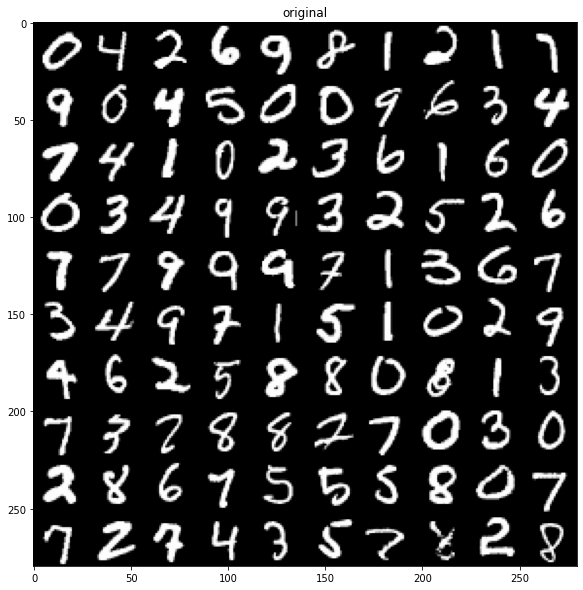

48000/48000 [==============================] - 28s 582us/sample - loss: 145.2444 - val_loss: 146.4600
Epoch 30/50
48000/48000 [==============================] - ETA: 0s - loss: 145.0910

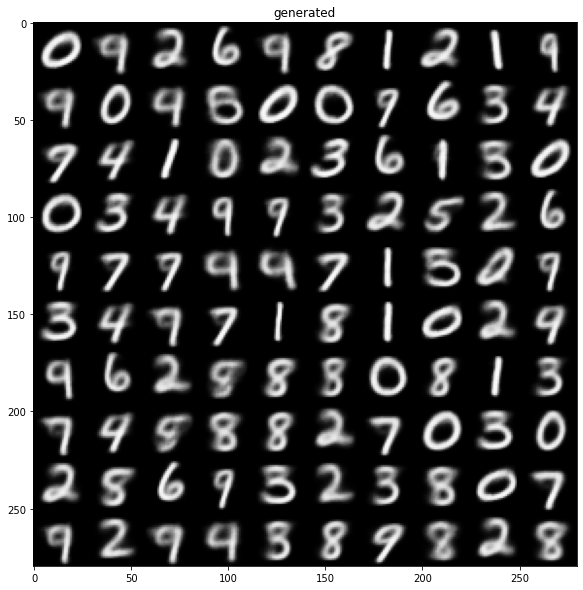

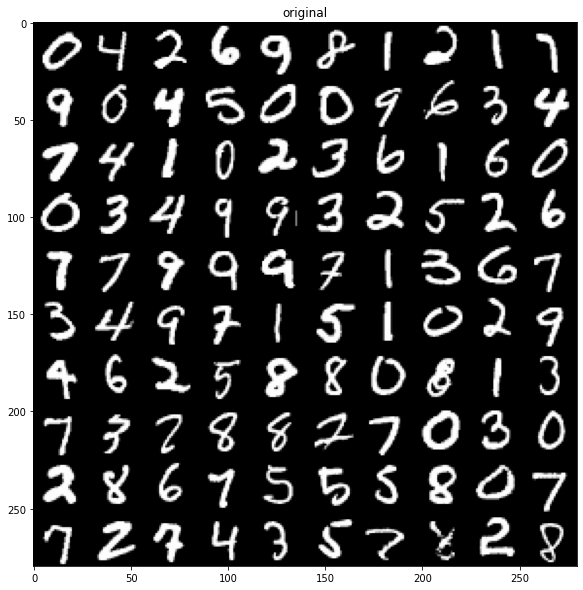

48000/48000 [==============================] - 28s 583us/sample - loss: 145.0910 - val_loss: 148.2946
Epoch 31/50
48000/48000 [==============================] - ETA: 0s - loss: 145.2465

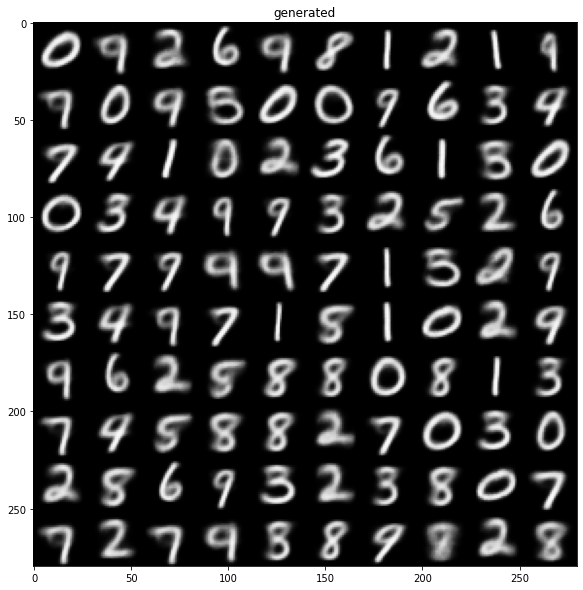

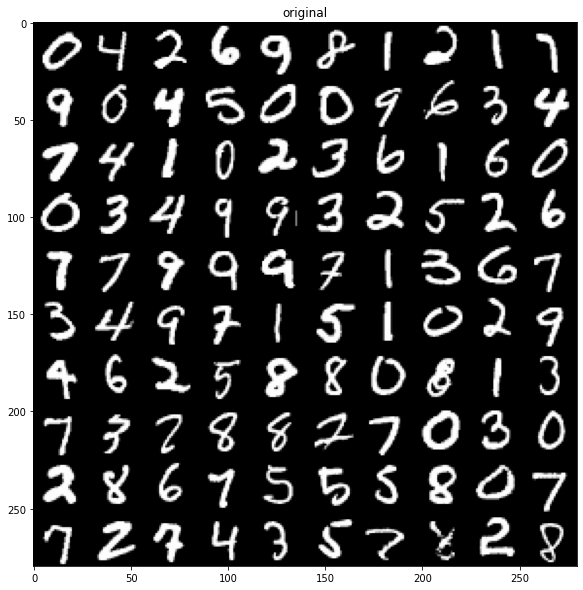

48000/48000 [==============================] - 28s 576us/sample - loss: 145.2465 - val_loss: 146.7828
Epoch 32/50
48000/48000 [==============================] - ETA: 0s - loss: 145.0272

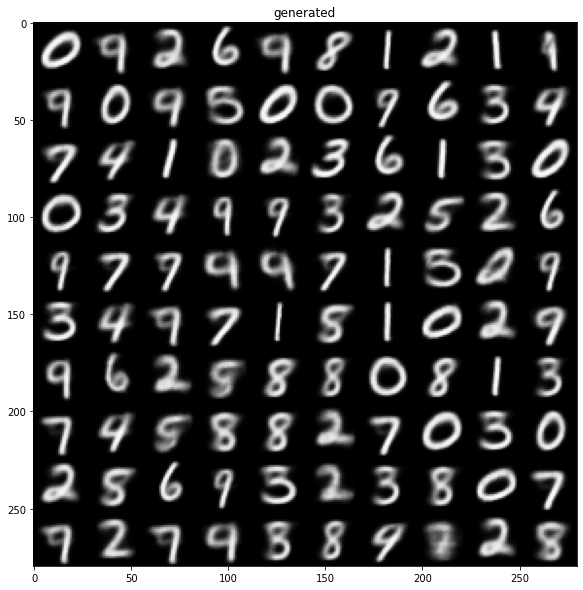

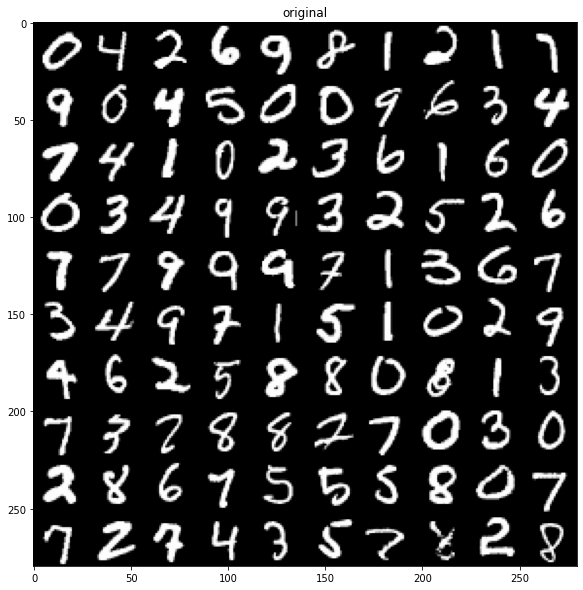

48000/48000 [==============================] - 28s 580us/sample - loss: 145.0272 - val_loss: 148.1150
Epoch 33/50
48000/48000 [==============================] - ETA: 0s - loss: 144.9794

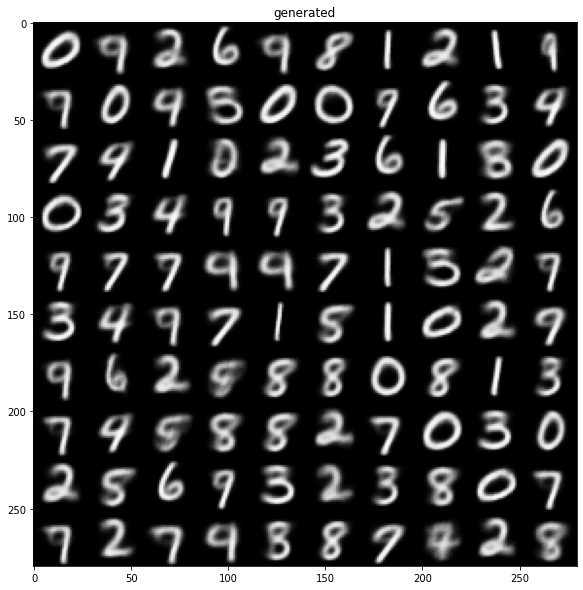

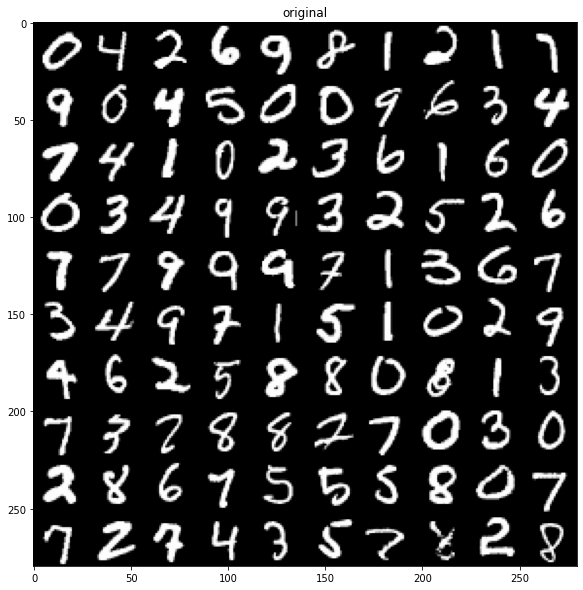

48000/48000 [==============================] - 28s 580us/sample - loss: 144.9794 - val_loss: 146.9629
Epoch 34/50
48000/48000 [==============================] - ETA: 0s - loss: 144.3686

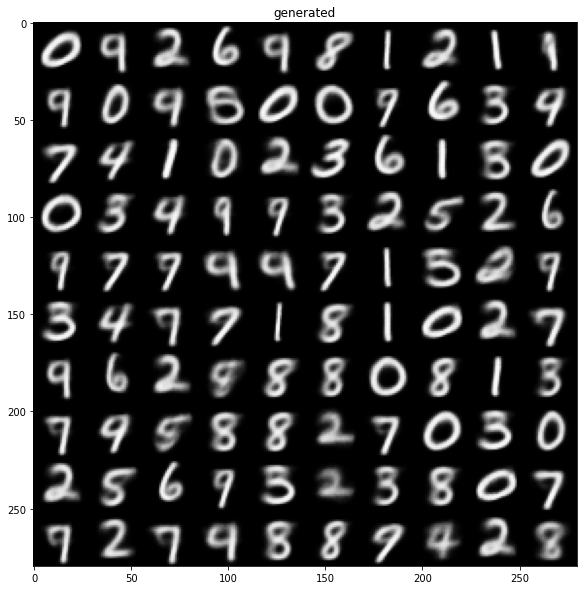

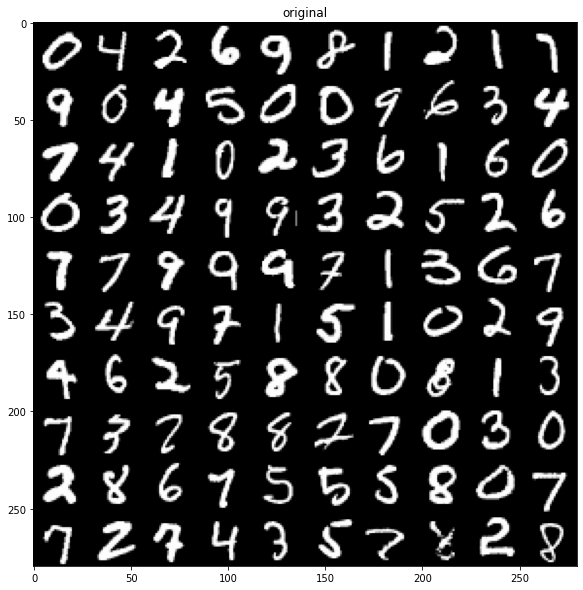

48000/48000 [==============================] - 28s 584us/sample - loss: 144.3686 - val_loss: 147.8031
Epoch 35/50
48000/48000 [==============================] - ETA: 0s - loss: 144.4966

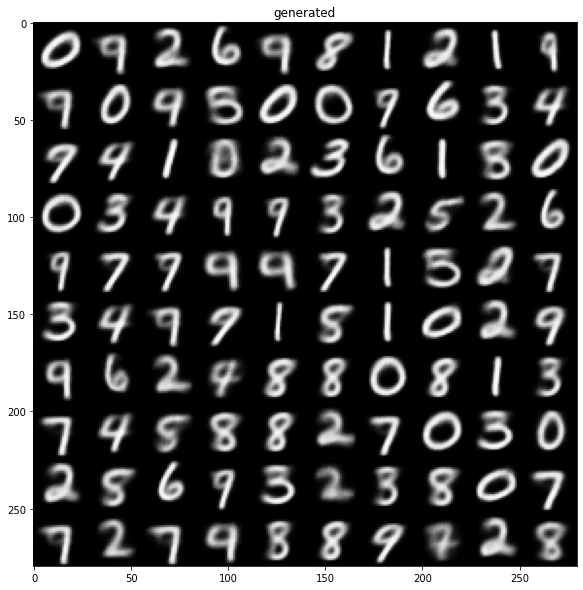

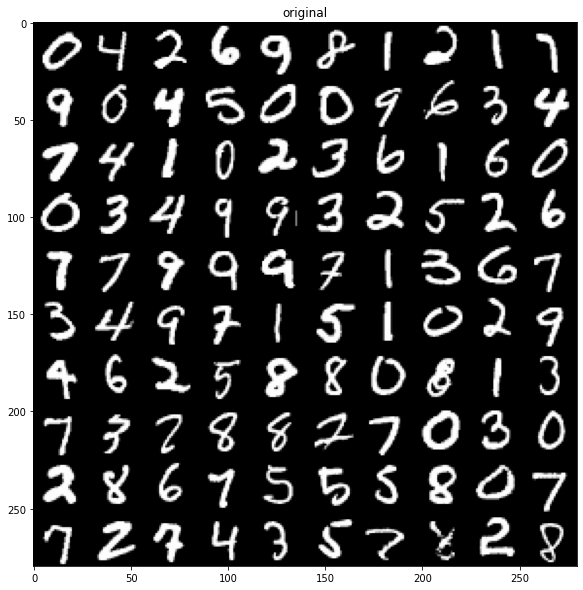

48000/48000 [==============================] - 28s 582us/sample - loss: 144.4966 - val_loss: 145.9300
Epoch 36/50
48000/48000 [==============================] - ETA: 0s - loss: 144.2924

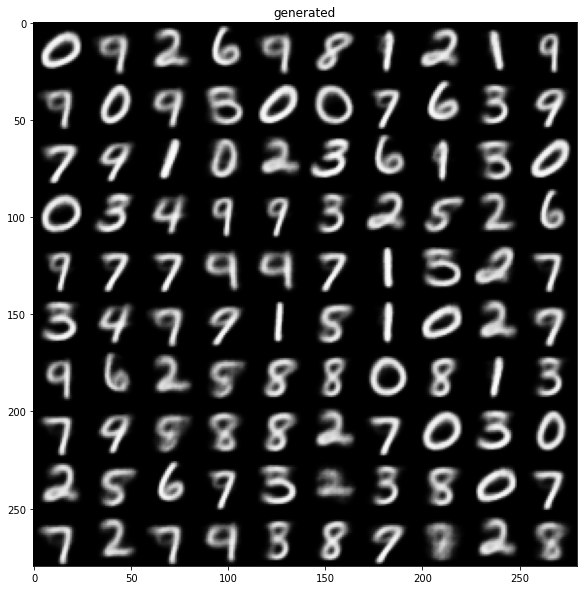

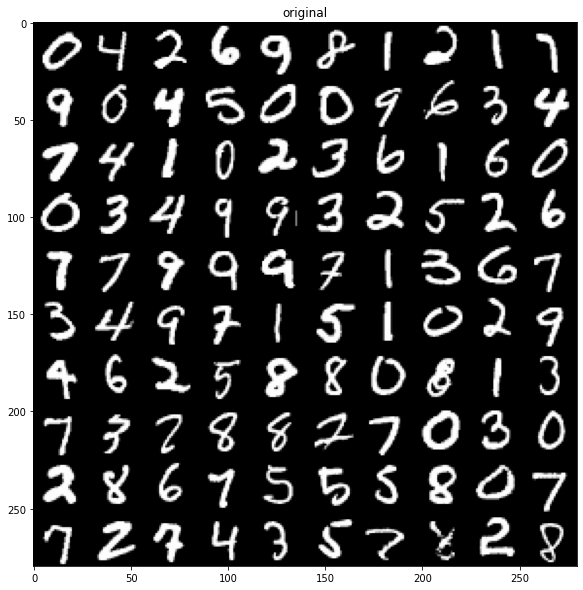

48000/48000 [==============================] - 28s 576us/sample - loss: 144.2924 - val_loss: 147.5086
Epoch 37/50
48000/48000 [==============================] - ETA: 0s - loss: 144.1504

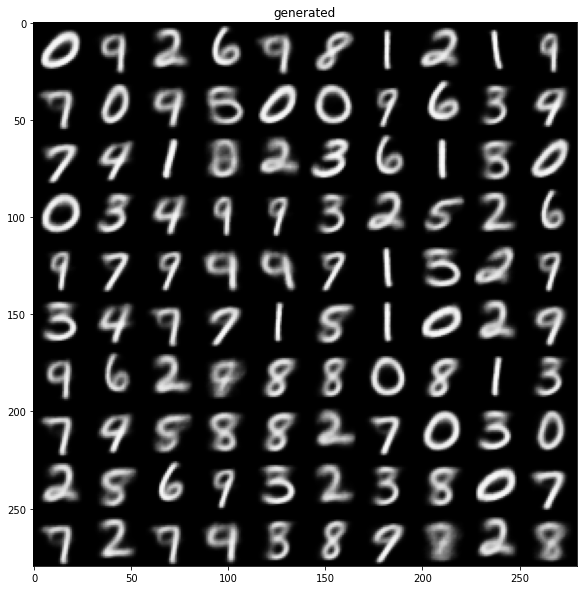

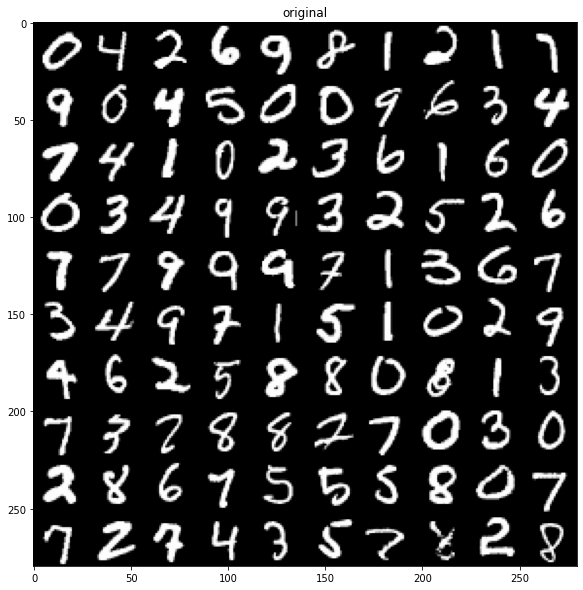

48000/48000 [==============================] - 28s 584us/sample - loss: 144.1504 - val_loss: 146.4329
Epoch 38/50
48000/48000 [==============================] - ETA: 0s - loss: 144.3293

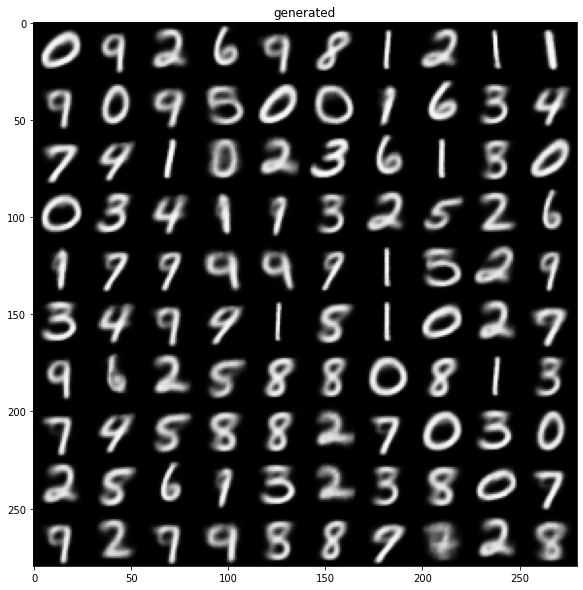

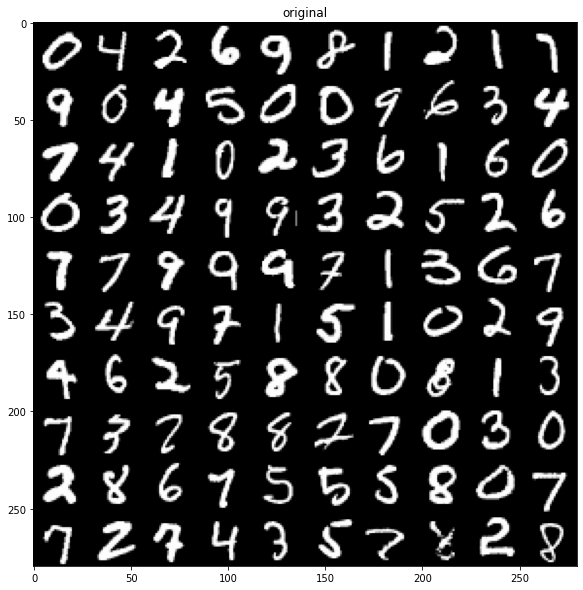

48000/48000 [==============================] - 28s 578us/sample - loss: 144.3293 - val_loss: 152.9662
Epoch 39/50
48000/48000 [==============================] - ETA: 0s - loss: 143.7760

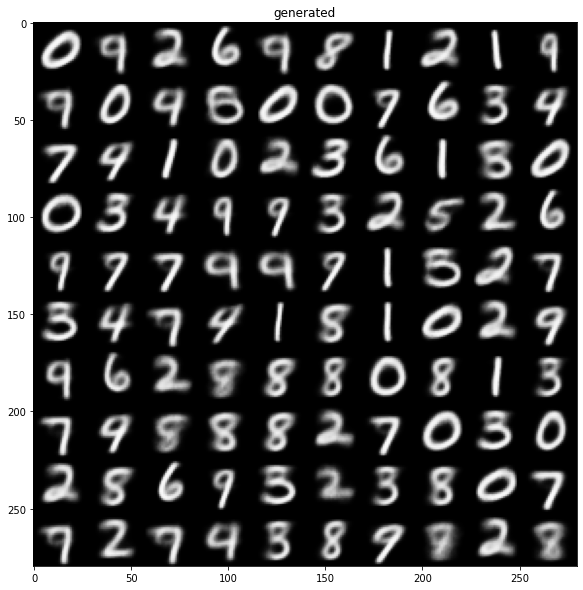

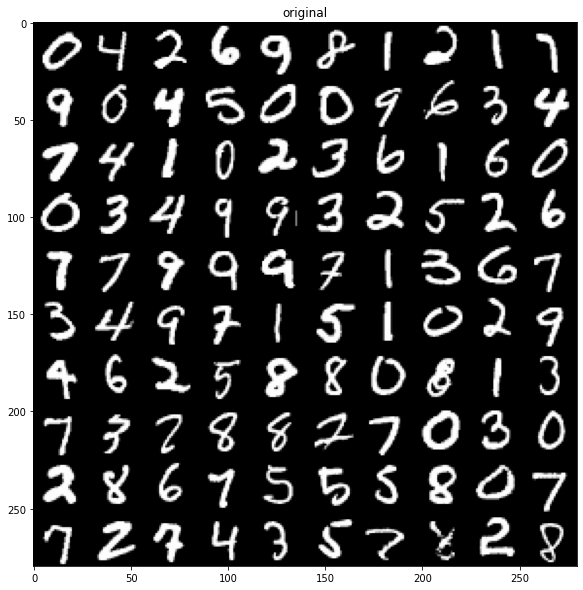

48000/48000 [==============================] - 28s 582us/sample - loss: 143.7760 - val_loss: 146.5419
Epoch 40/50
48000/48000 [==============================] - ETA: 0s - loss: 143.6306

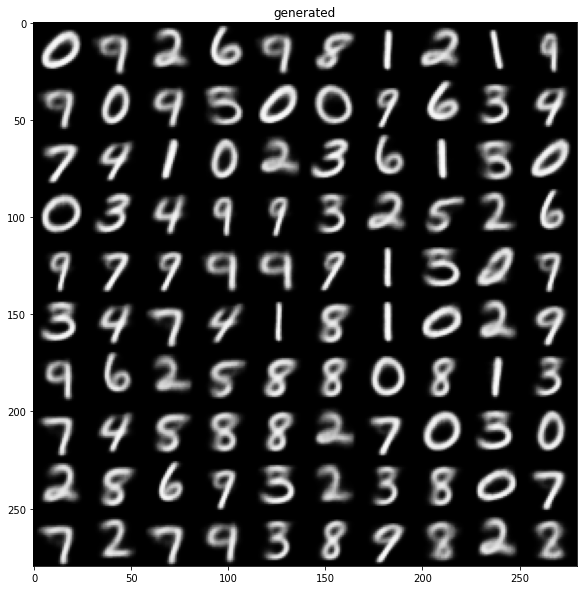

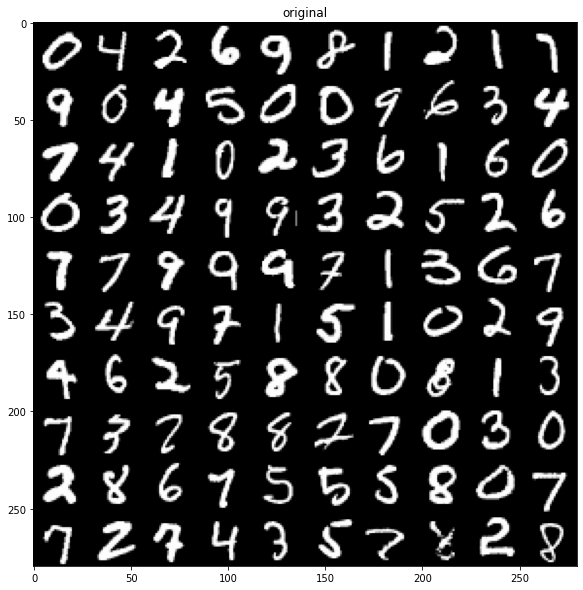

48000/48000 [==============================] - 28s 581us/sample - loss: 143.6306 - val_loss: 146.1980
Epoch 41/50
48000/48000 [==============================] - ETA: 0s - loss: 143.8564

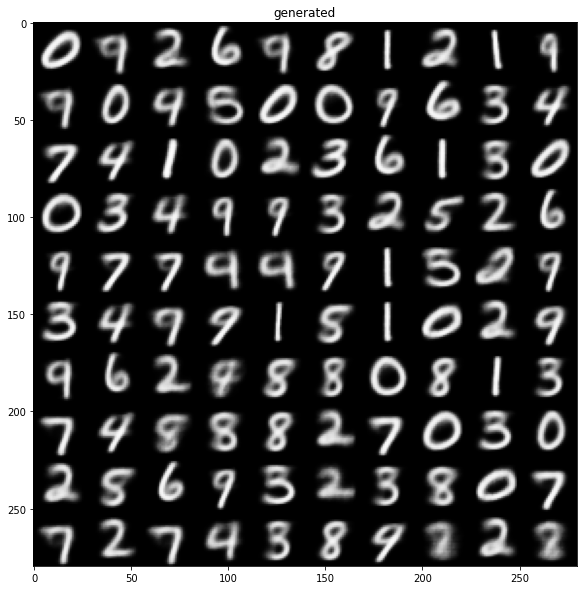

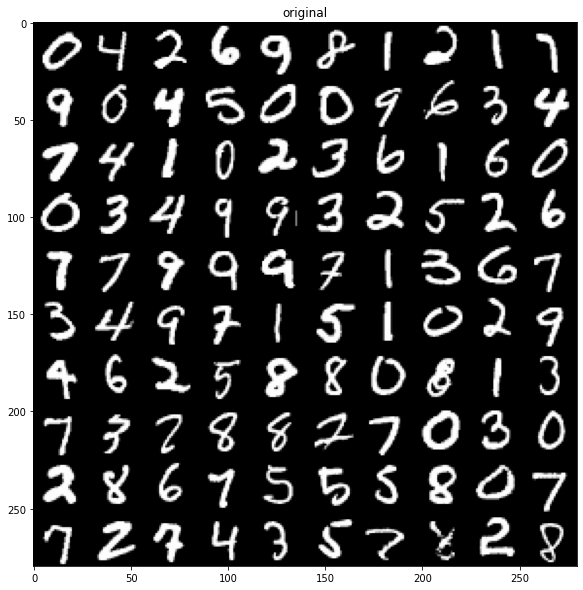

48000/48000 [==============================] - 28s 580us/sample - loss: 143.8564 - val_loss: 146.4865
Epoch 42/50
48000/48000 [==============================] - ETA: 0s - loss: 143.0752

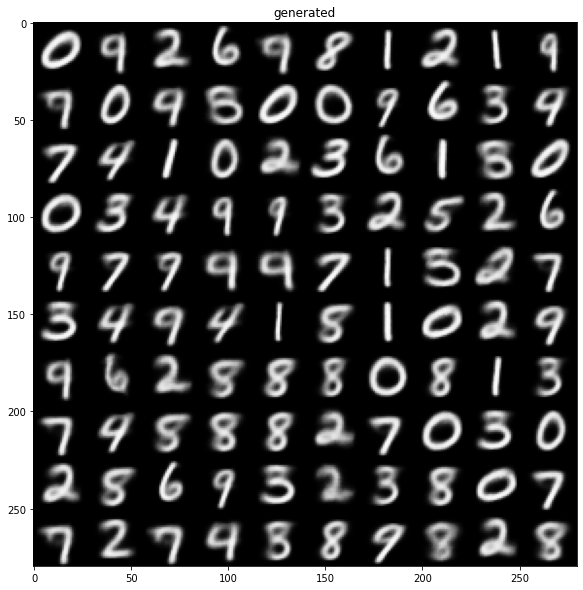

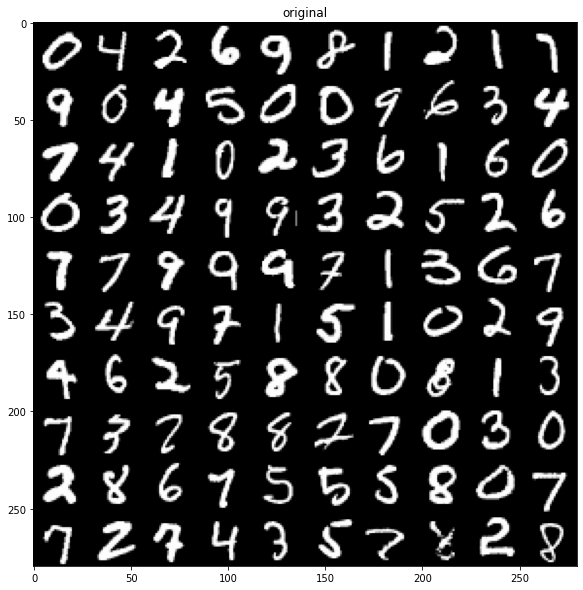

48000/48000 [==============================] - 28s 579us/sample - loss: 143.0752 - val_loss: 145.8577
Epoch 43/50
48000/48000 [==============================] - ETA: 0s - loss: 143.9119

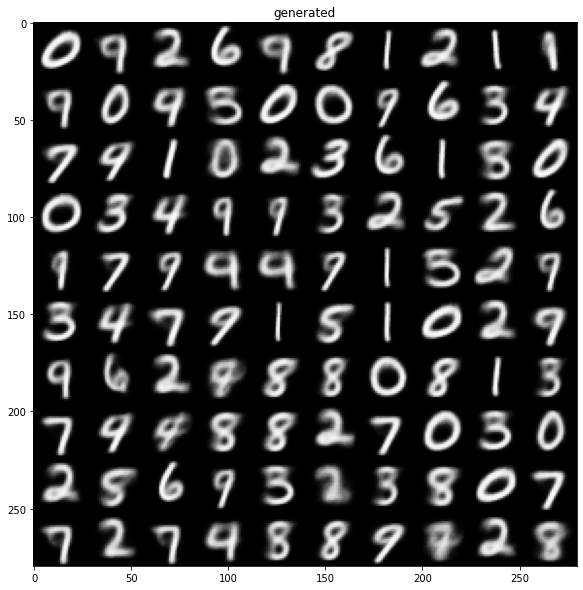

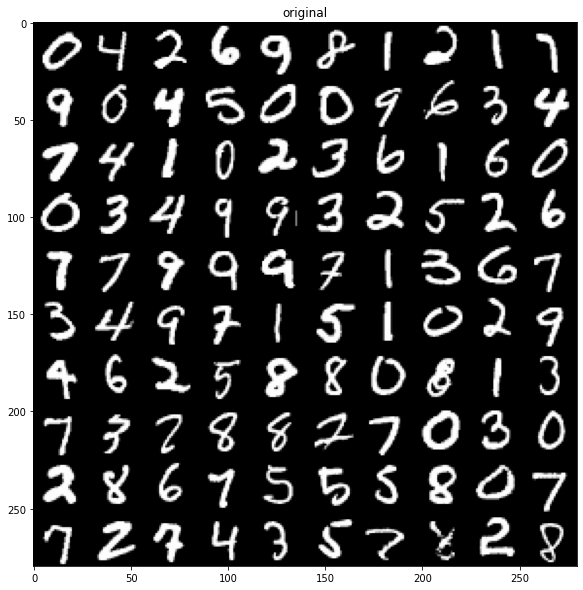

48000/48000 [==============================] - 28s 581us/sample - loss: 143.9119 - val_loss: 148.5266
Epoch 44/50
48000/48000 [==============================] - ETA: 0s - loss: 143.4865

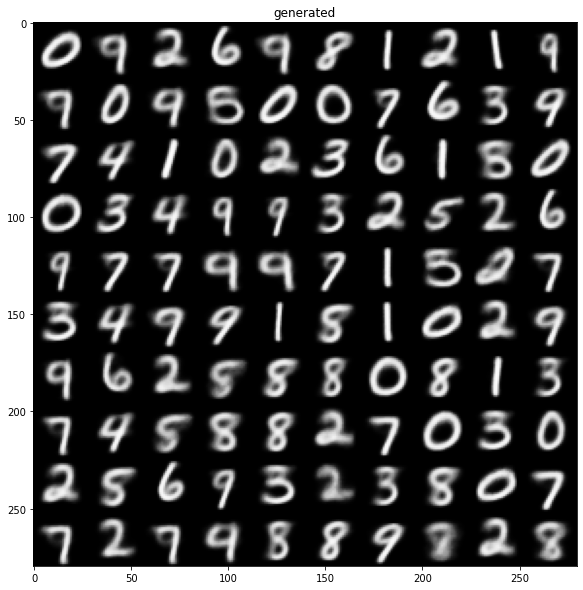

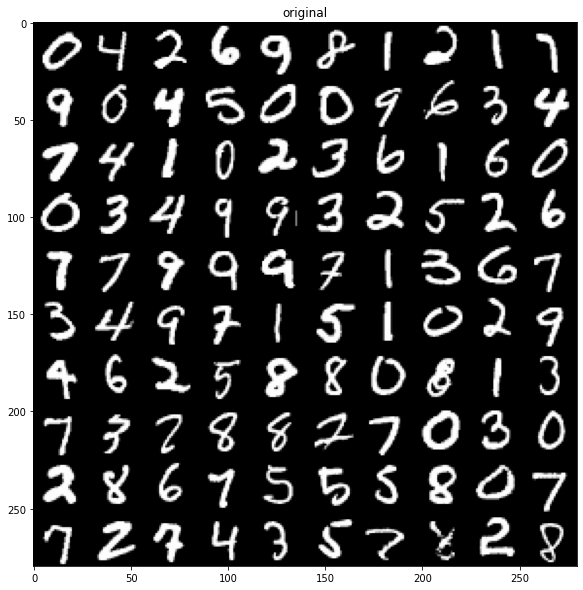

48000/48000 [==============================] - 28s 578us/sample - loss: 143.4865 - val_loss: 145.9300
Epoch 45/50
48000/48000 [==============================] - ETA: 0s - loss: 143.0182

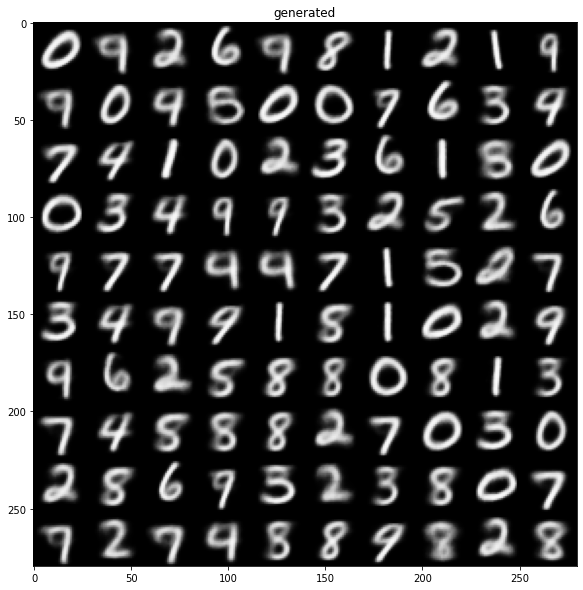

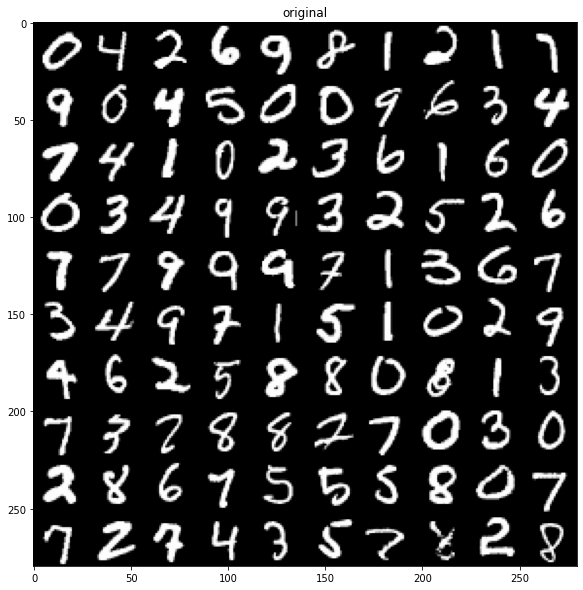

48000/48000 [==============================] - 28s 582us/sample - loss: 143.0182 - val_loss: 146.4309
Epoch 46/50
48000/48000 [==============================] - ETA: 0s - loss: 143.3888

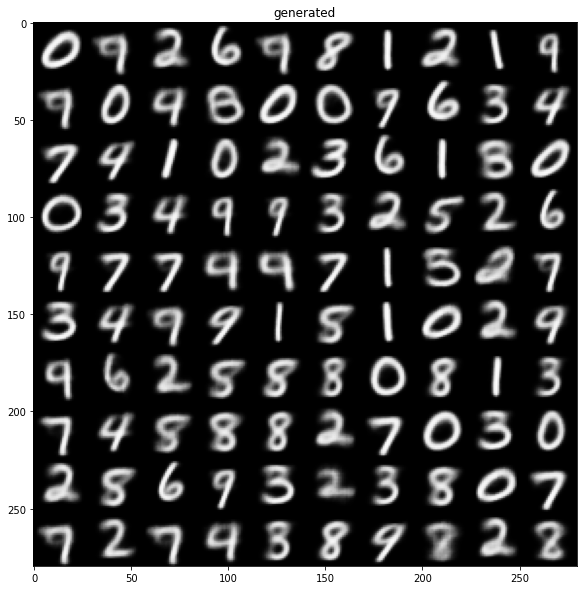

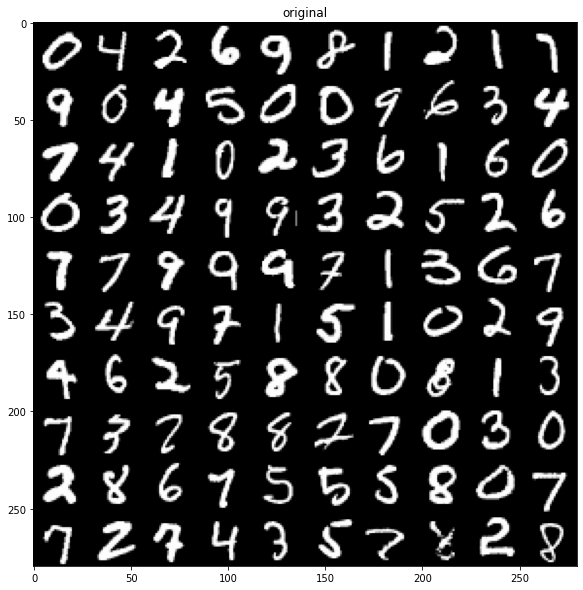

48000/48000 [==============================] - 28s 578us/sample - loss: 143.3888 - val_loss: 145.9425
Epoch 47/50
48000/48000 [==============================] - ETA: 0s - loss: 143.0714

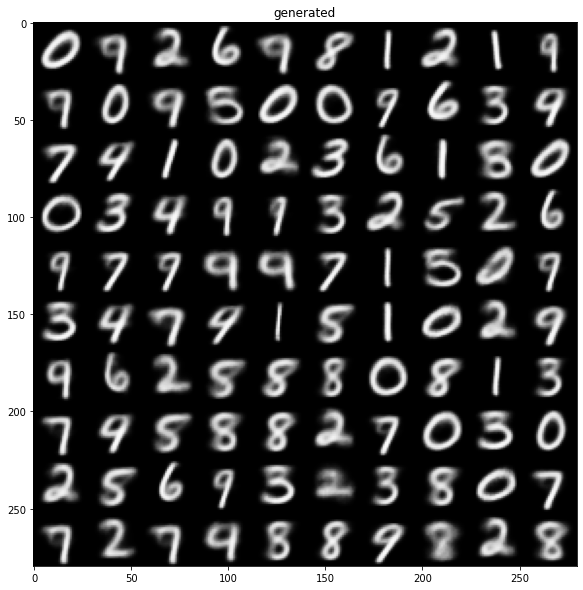

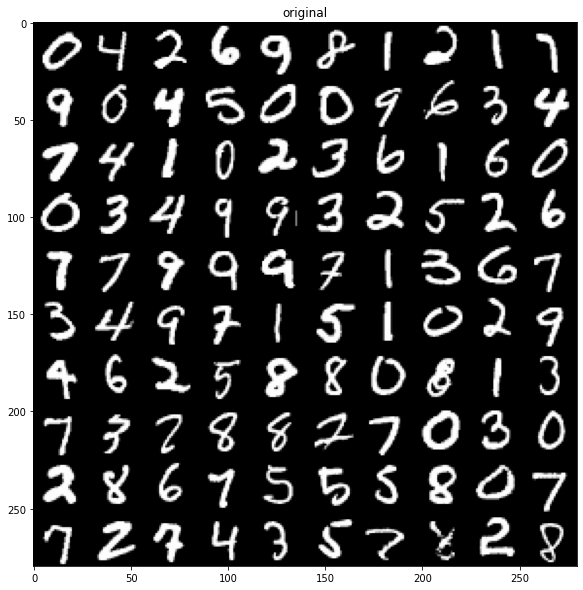

48000/48000 [==============================] - 28s 580us/sample - loss: 143.0714 - val_loss: 146.5649
Epoch 48/50
48000/48000 [==============================] - ETA: 0s - loss: 143.0573

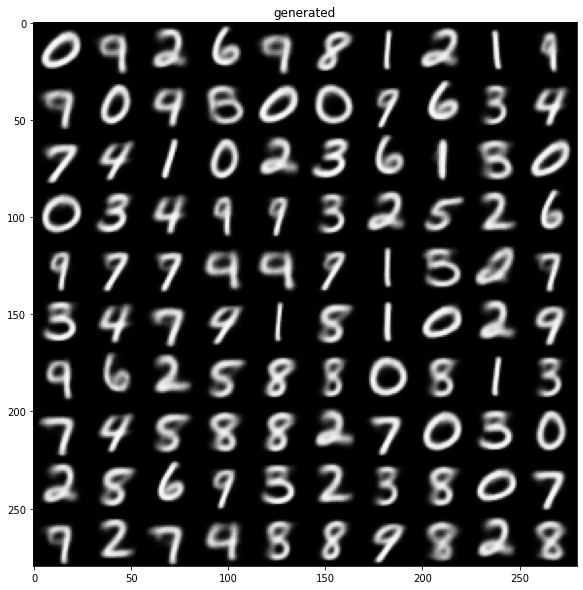

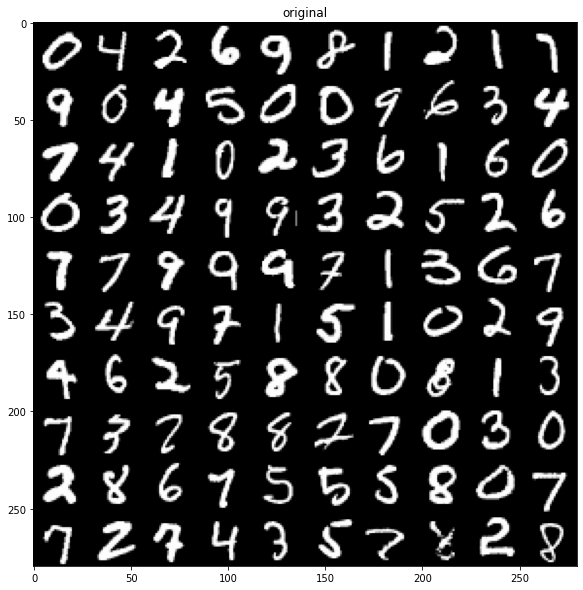

48000/48000 [==============================] - 28s 581us/sample - loss: 143.0573 - val_loss: 147.1464
Epoch 49/50
48000/48000 [==============================] - ETA: 0s - loss: 142.5909

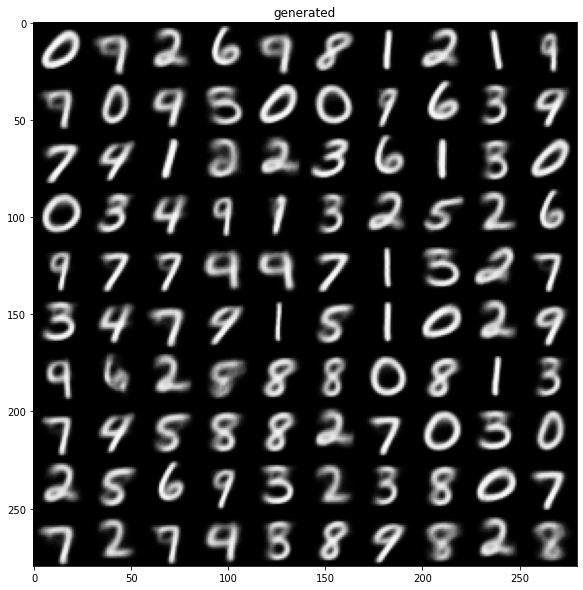

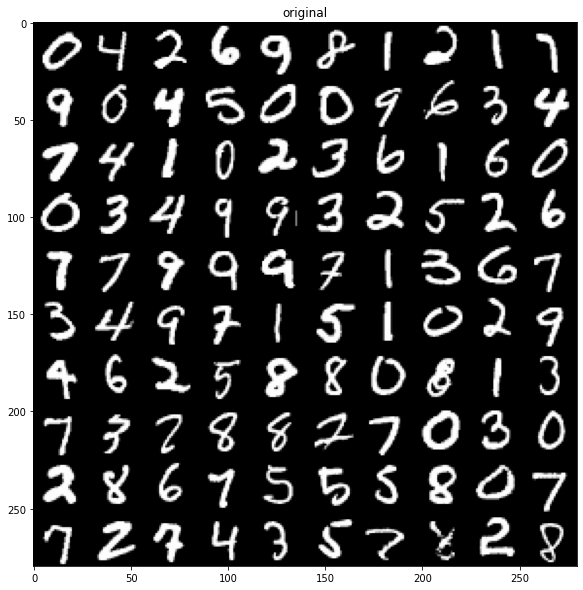

48000/48000 [==============================] - 28s 574us/sample - loss: 142.5909 - val_loss: 146.4311
Epoch 50/50
48000/48000 [==============================] - ETA: 0s - loss: 142.3917

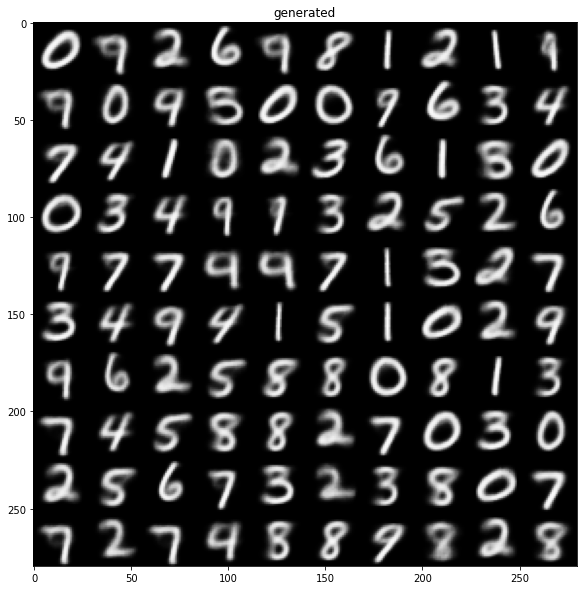

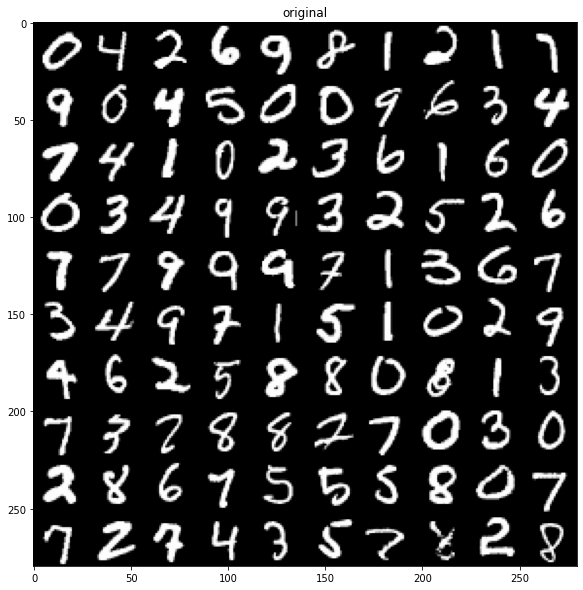

48000/48000 [==============================] - 28s 588us/sample - loss: 142.3917 - val_loss: 146.4823


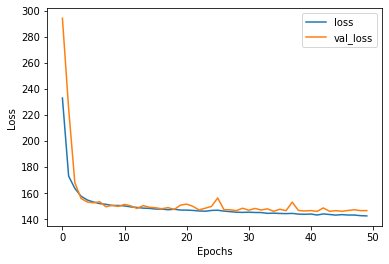

In [ ]:
VAE_outputs = decoder(encoder(input)[2])
VAE = Model(input, VAE_outputs)

VAE.compile(optimizer='adam', loss=kl_reconstruction_loss, experimental_run_tf_function=False)
Trained_model = VAE.fit(train_data, train_data, epochs = 50, batch_size = 256, validation_split = 0.2, callbacks=[PerformanceCheck(False)])

history = Trained_model.history
losses=history['loss']
val_losses=history['val_loss']

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.plot(losses)
plt.plot(val_losses)
plt.legend(['loss','val_loss'])


**Visualization**

First, we try to visualize latent space to see the continuty and completness of clustering. By changing parameters or loss function definition, it can be determined that retrieving process may result in cosistent output data or not.

Visualization is divided to 2 main parts:


1.   Inputs mapped onto latent space
2.   output samples from latent space



In [ ]:
def vizualization_latent_space(encoder, x, y):
#   train_data, train_lable = data
  mu,_,_ = encoder.predict(x)
  print(mu.shape)
  print(y.shape)
  plt.figure(figsize=(12, 10))
  plt.scatter(mu[:, 0], mu[:, 1], c=y)
  plt.xlabel('z - dim 1')
  plt.ylabel('z - dim 2')
  plt.colorbar()
  plt.show()

(60000, 2)
(60000,)


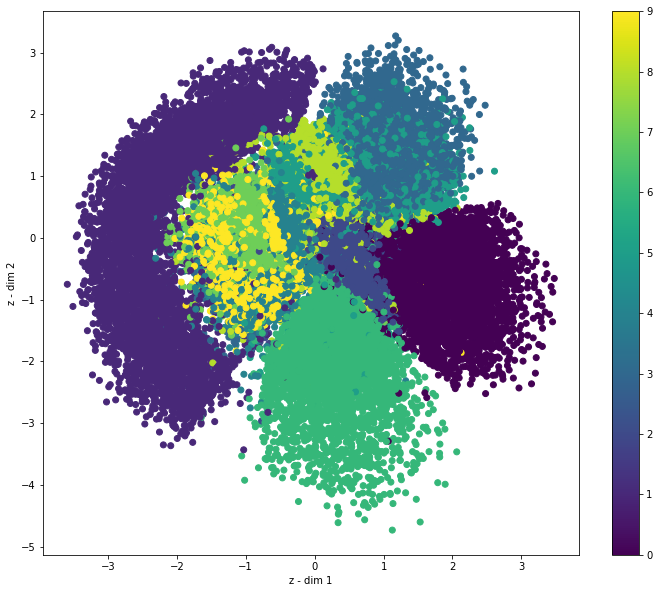

In [ ]:
vizualization_latent_space(encoder, train_data, train_lable)

In [ ]:
def vizualization_decoded(decoder, conditional=False, condition=None):

    num_samples = 10
    figure = np.zeros((28*num_samples, 28* num_samples, 1))
    grid_x = np.linspace(-4, 4, num_samples)
    grid_y = np.linspace(-4, 4, num_samples)[::-1]

    if conditional:
        label = np.array([[1 if i == condition else 0 for i in range(10)]], dtype=np.float32)

    for i, yi in enumerate(grid_y):
        for j, xi in enumerate(grid_x):
            z_sample = np.array([[xi, yi]])
            if conditional:
                z_sample = concat([z_sample, label])
                x_decoded = decoder.predict(z_sample, steps=1)
            else:
                x_decoded = decoder.predict(z_sample)
            digit = x_decoded[0].reshape(28, 28, 1)
            figure[i*28:(i+1)*28, j*28:(j+1)*28] = digit

    plt.figure(figsize=(10, 10))

    start_range = 28 // 2
    end_range = num_samples *28 + start_range + 1
    pixel_range = np.arange(start_range, end_range, 28)
    sample_range_x = np.round(grid_x, 1)
    sample_range_y = np.round(grid_y, 1)
    plt.xticks(pixel_range, sample_range_x)
    plt.yticks(pixel_range, sample_range_y)

    plt.xlabel('z - dim 1')
    plt.ylabel('z - dim 2')

    fig_shape = np.shape(figure)
    if fig_shape[2] == 1:
        figure = figure.reshape((fig_shape[0], fig_shape[1]))

    plt.imshow(figure.reshape((280, 280)), cmap="Greys_r")
    plt.show()

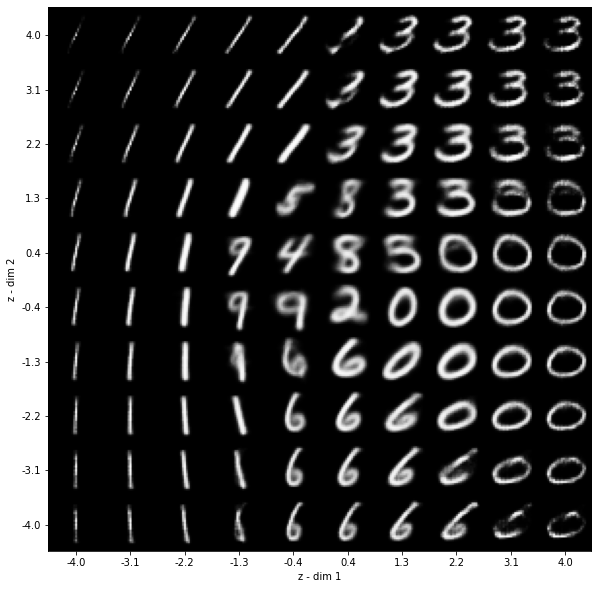

In [ ]:
vizualization_decoded(decoder)

# Conditional-VAEs

## reshaping the data
we reshape the data here to be able to concat the conditions for generating numbers. the condition is actually the lable of a sample which is presented as a one-hot vector.

we here concat the mnist inputs with their lables, so the size of the concated input is 28*28 + 10

In [ ]:
train_data = train_data.reshape((-1, 28*28))
valid_data = valid_data.reshape((-1, 28*28))
n_x = train_data.shape[1]
n_y = onehot_train_lable.shape[1]

In [ ]:
x = Input(shape=(n_x,))
y = Input(shape=(n_y,))

inputs = concat([x, y])

## Encoder
we used a simple architecture for this part, its just some fully connected layers that the input is the concated one we explained above and the output is a 2-D output that we will concat this 2-D output with the lable of the feeded sample to generate conditional fake numbers, too.

In [ ]:
encoder = Dense(512, activation='relu')(inputs)
mean = Dense(2, activation='linear')(encoder)
standard_deviation = Dense(2, activation='linear')(encoder)

sample = Lambda(sample_reparameterize, output_shape=(2, ))([mean, standard_deviation])
samplec = concat([sample, y])

## Decoder
the decoder architecture is also a fully-connected architecture that will generate some fake numbers. 

In [ ]:
decoder_hidden = Dense(512, activation='relu')
decoder_out = Dense(28*28, activation='sigmoid')
h_p = decoder_hidden(samplec)
outputs = decoder_out(h_p)

##C-VAE
the overall model has two different input, the image and the label. we didn't completely merge them because we didn't want the model to predict the lable two, we just wanted to use them as a condition to affect the generated result.

In [ ]:
C_VAE = Model([x, y], outputs)
encoder = Model([x, y], [mean, standard_deviation, sample])

d_in = Input(shape=(2+n_y,))
d_h = decoder_hidden(d_in)
d_out = decoder_out(d_h)
decoder = Model(d_in, d_out)

## Train and Test
here we train the C-VAE and we can monitor the conditioned-generated fake numbers in this network using the callback that we explained. 

at the end, the loss function of train and test set has been reported.

Train on 48000 samples, validate on 12000 samples
Epoch 1/50
47872/48000 [============================>.] - ETA: 0s - loss: 208.6763

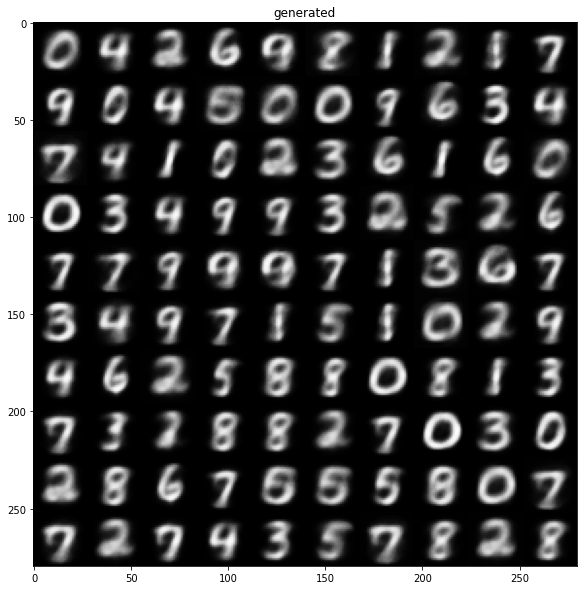

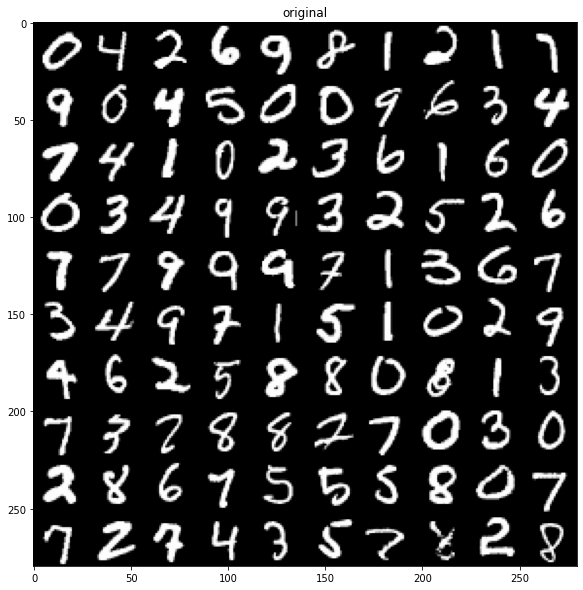

48000/48000 [==============================] - 4s 84us/sample - loss: 208.5529 - val_loss: 162.6943
Epoch 2/50
46336/48000 [===========================>..] - ETA: 0s - loss: 155.4670

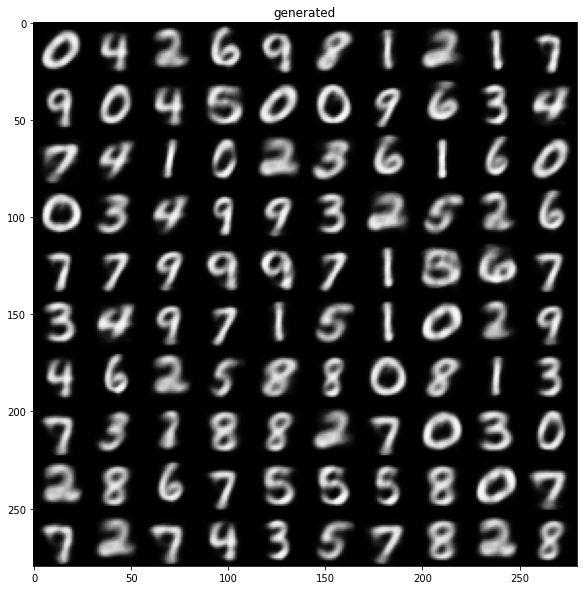

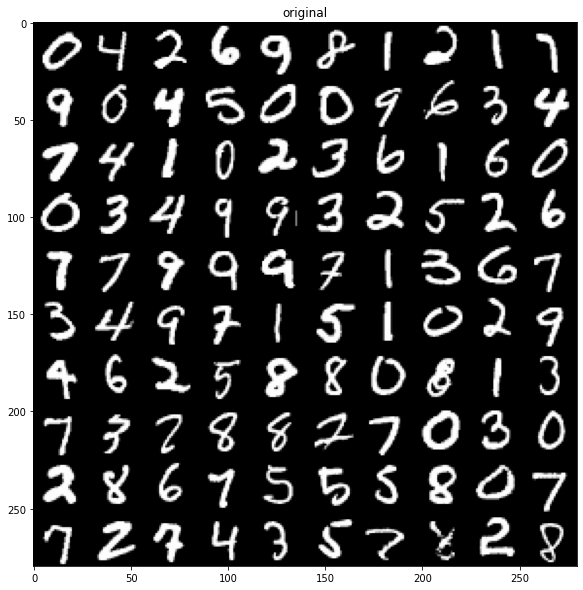

48000/48000 [==============================] - 2s 38us/sample - loss: 155.1961 - val_loss: 147.7745
Epoch 3/50
46592/48000 [============================>.] - ETA: 0s - loss: 146.0430

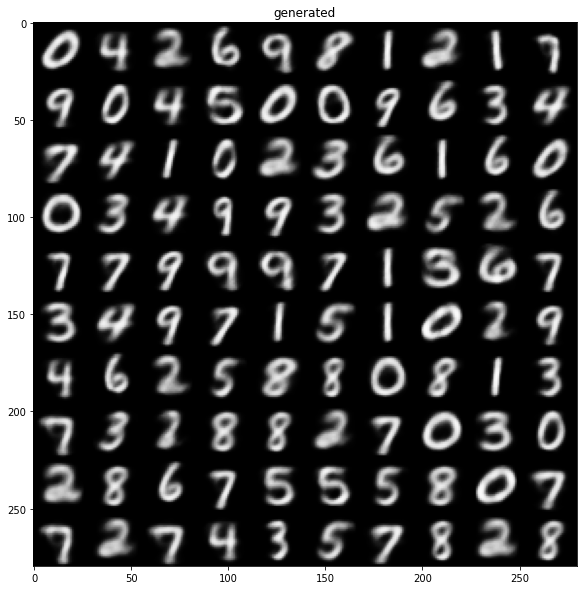

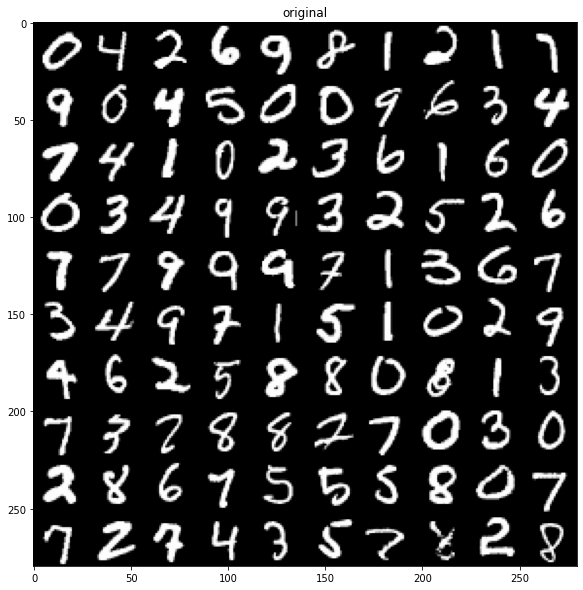

48000/48000 [==============================] - 2s 39us/sample - loss: 145.9666 - val_loss: 143.1695
Epoch 4/50
48000/48000 [==============================] - ETA: 0s - loss: 142.6238

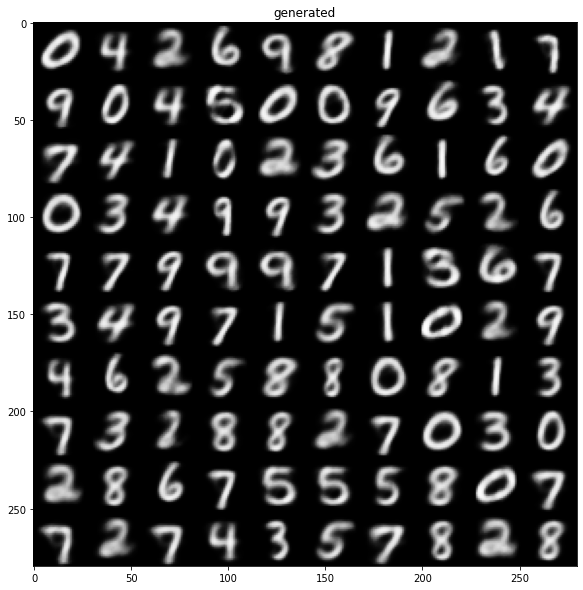

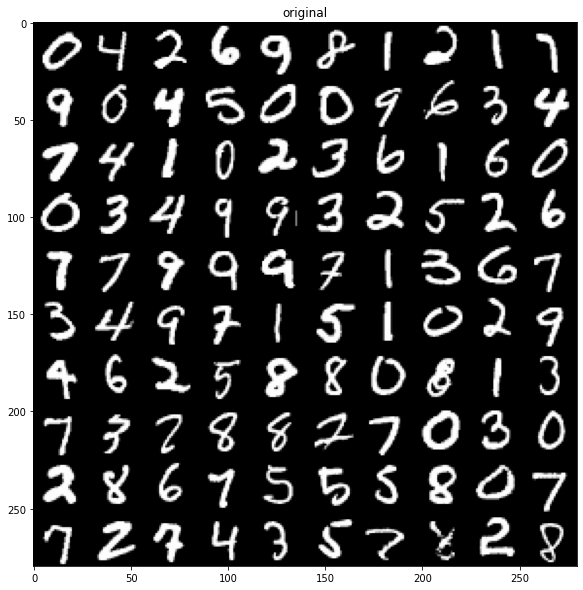

48000/48000 [==============================] - 2s 42us/sample - loss: 142.6238 - val_loss: 140.7815
Epoch 5/50
47872/48000 [============================>.] - ETA: 0s - loss: 140.7015

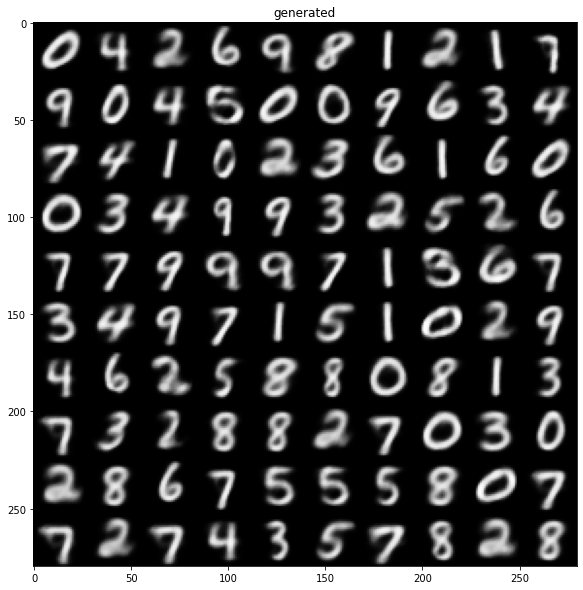

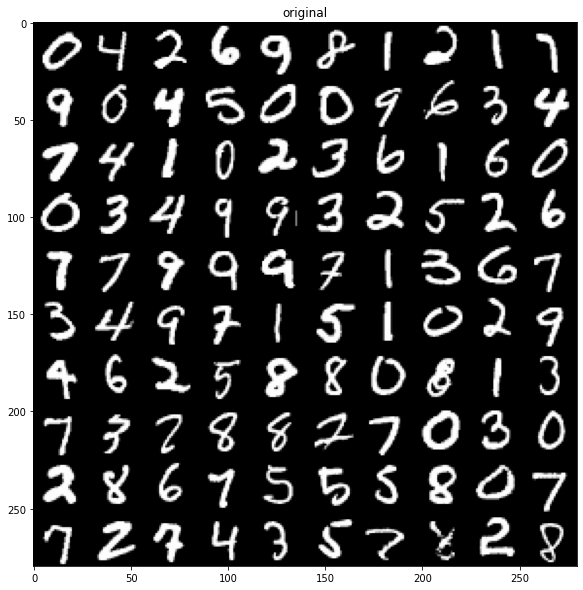

48000/48000 [==============================] - 2s 44us/sample - loss: 140.7086 - val_loss: 139.3395
Epoch 6/50
46336/48000 [===========================>..] - ETA: 0s - loss: 139.5101

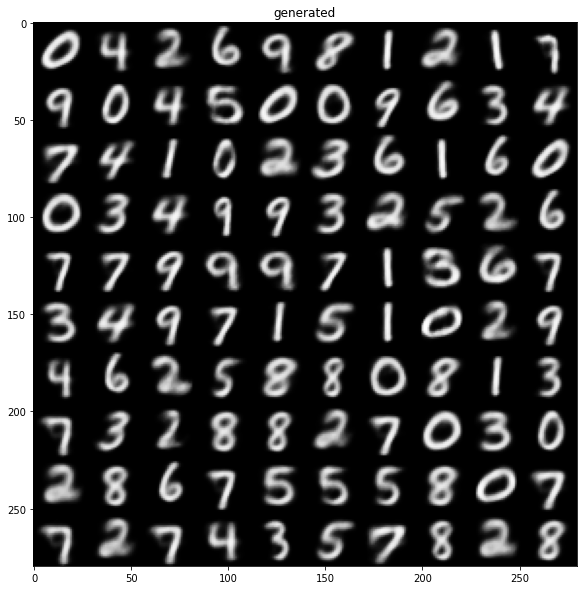

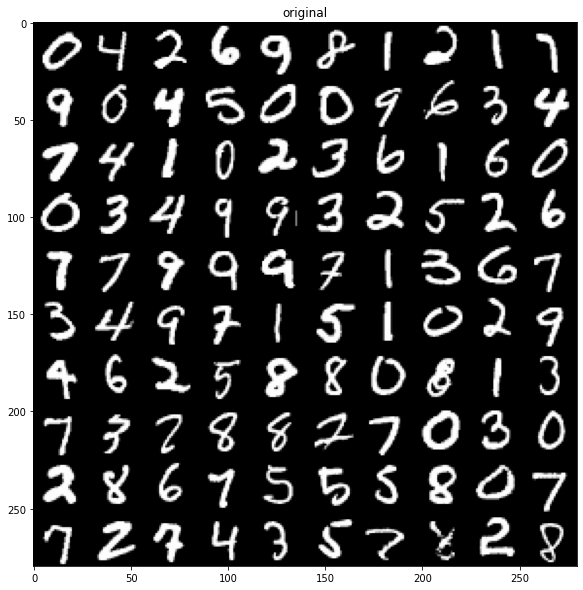

48000/48000 [==============================] - 2s 40us/sample - loss: 139.4375 - val_loss: 138.3181
Epoch 7/50
48000/48000 [==============================] - ETA: 0s - loss: 138.4388

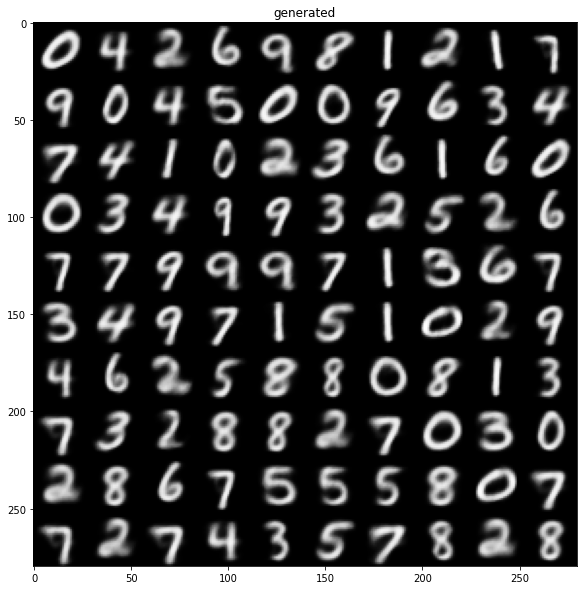

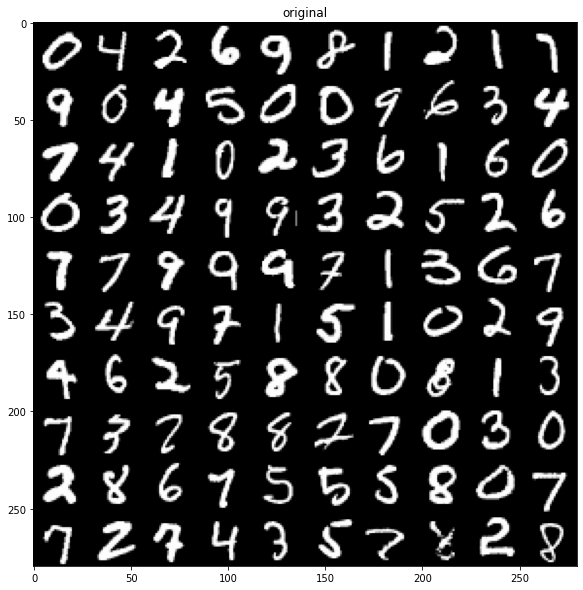

48000/48000 [==============================] - 2s 41us/sample - loss: 138.4388 - val_loss: 137.5752
Epoch 8/50
47104/48000 [============================>.] - ETA: 0s - loss: 137.5167

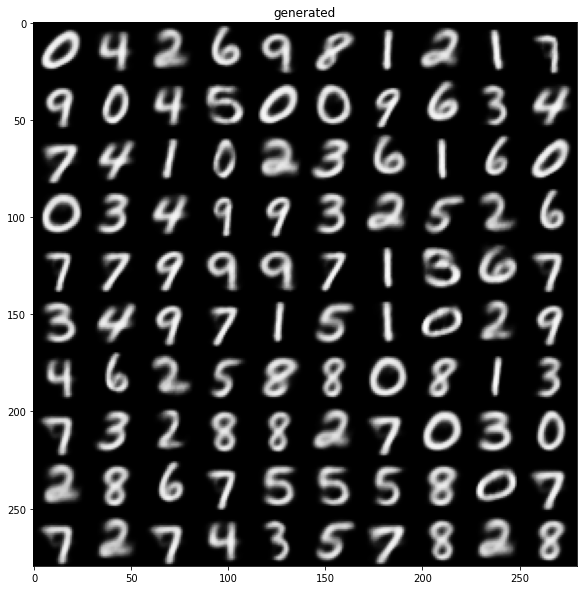

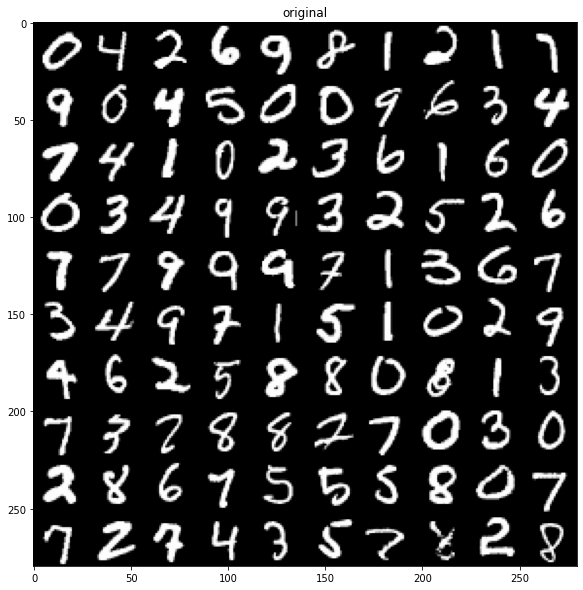

48000/48000 [==============================] - 2s 42us/sample - loss: 137.5820 - val_loss: 137.0430
Epoch 9/50
47872/48000 [============================>.] - ETA: 0s - loss: 136.9171

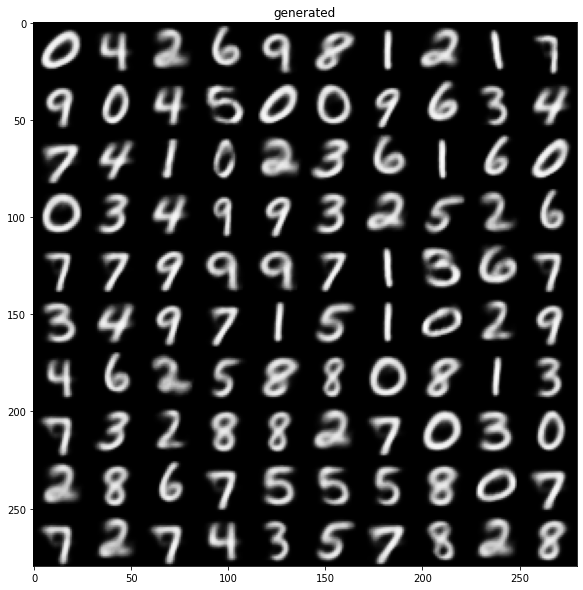

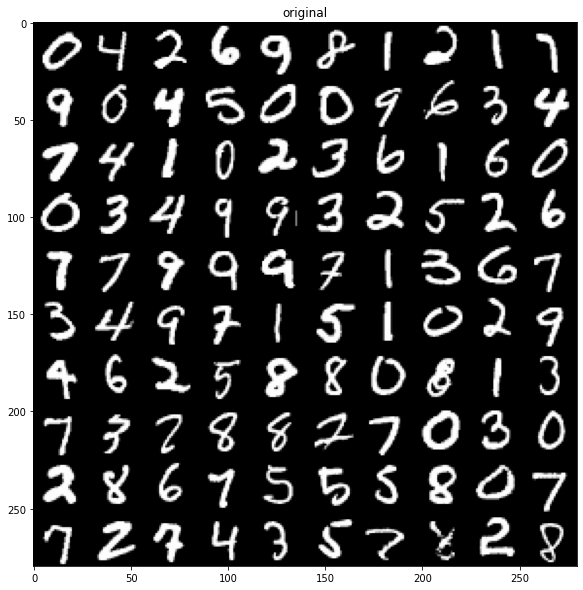

48000/48000 [==============================] - 2s 42us/sample - loss: 136.9162 - val_loss: 136.2729
Epoch 10/50
47872/48000 [============================>.] - ETA: 0s - loss: 136.3041

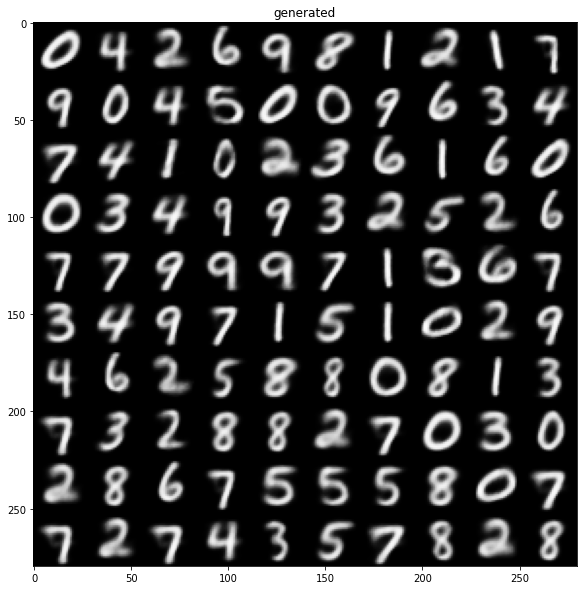

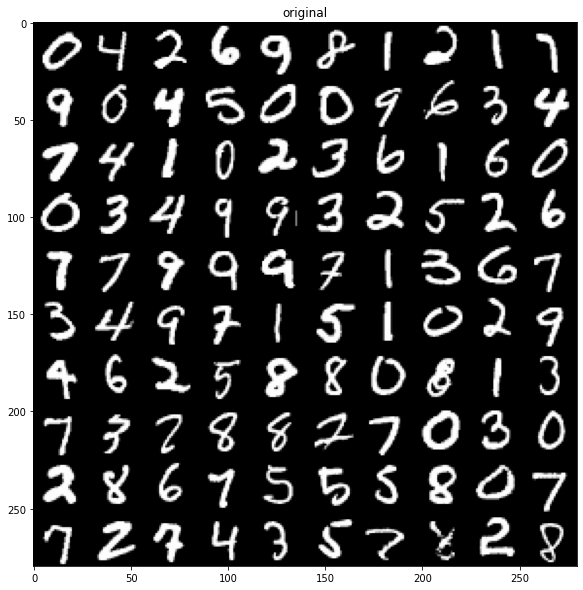

48000/48000 [==============================] - 2s 42us/sample - loss: 136.2874 - val_loss: 136.0519
Epoch 11/50
47616/48000 [============================>.] - ETA: 0s - loss: 135.7427

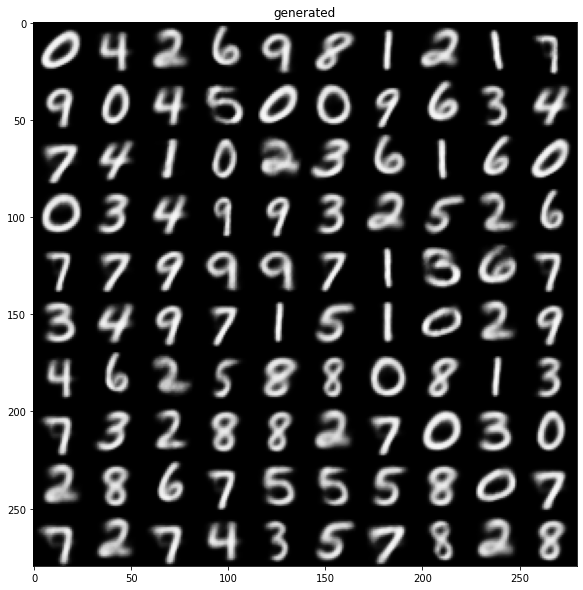

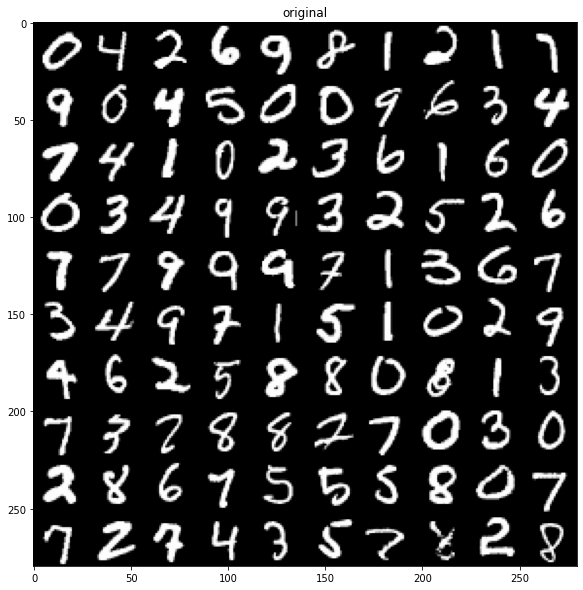

48000/48000 [==============================] - 2s 43us/sample - loss: 135.7455 - val_loss: 135.2918
Epoch 12/50
47872/48000 [============================>.] - ETA: 0s - loss: 135.2200

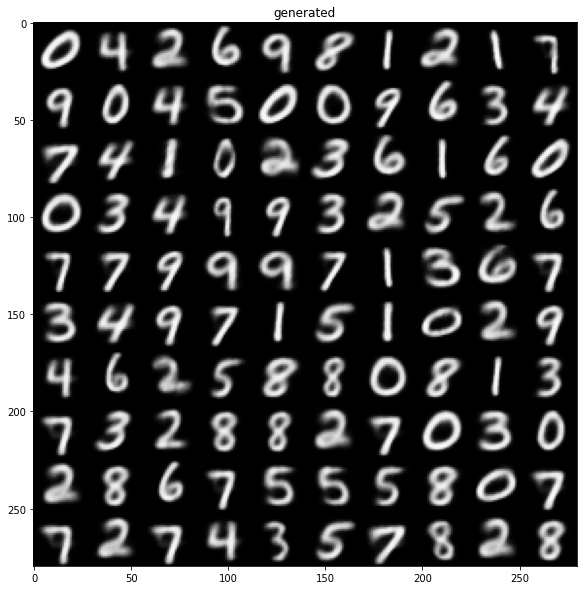

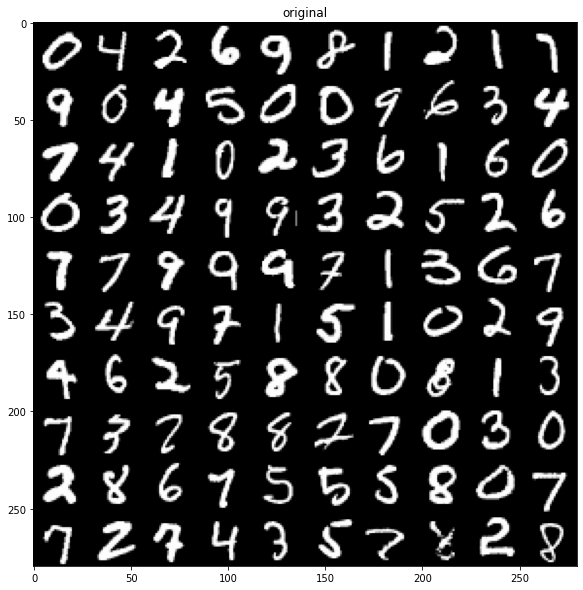

48000/48000 [==============================] - 2s 46us/sample - loss: 135.2333 - val_loss: 134.9515
Epoch 13/50
47616/48000 [============================>.] - ETA: 0s - loss: 134.7827

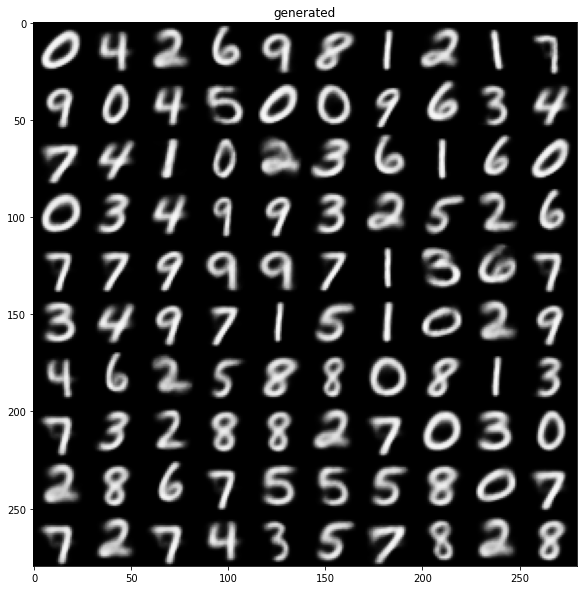

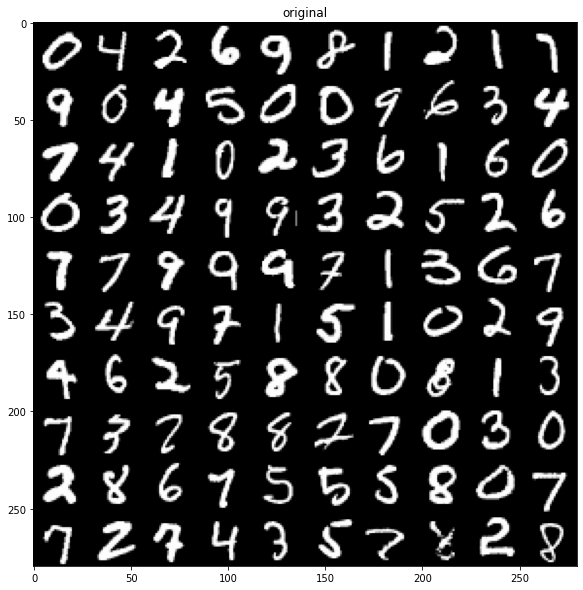

48000/48000 [==============================] - 2s 46us/sample - loss: 134.7834 - val_loss: 134.5811
Epoch 14/50
47104/48000 [============================>.] - ETA: 0s - loss: 134.4334

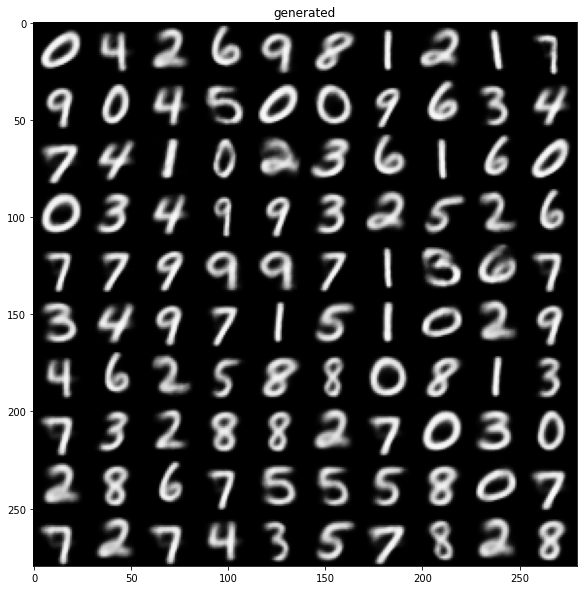

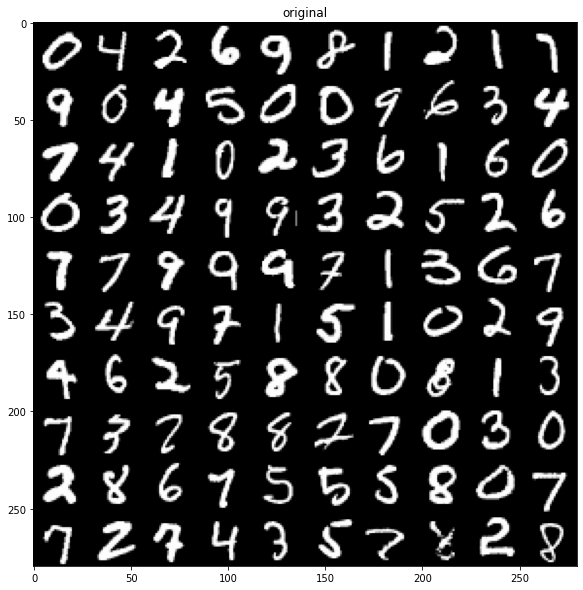

48000/48000 [==============================] - 2s 47us/sample - loss: 134.4036 - val_loss: 134.1967
Epoch 15/50
47104/48000 [============================>.] - ETA: 0s - loss: 134.0754

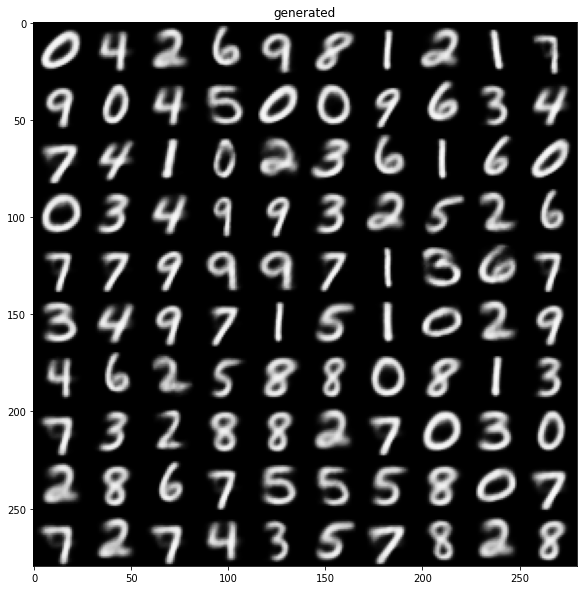

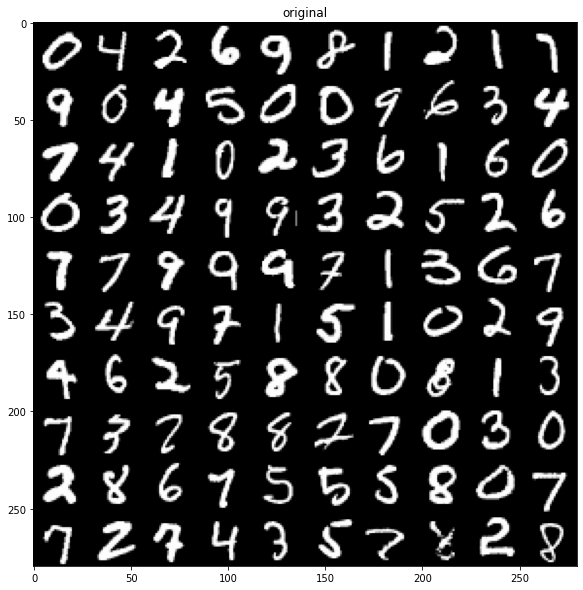

48000/48000 [==============================] - 2s 47us/sample - loss: 134.0593 - val_loss: 133.9909
Epoch 16/50
46848/48000 [============================>.] - ETA: 0s - loss: 133.7769

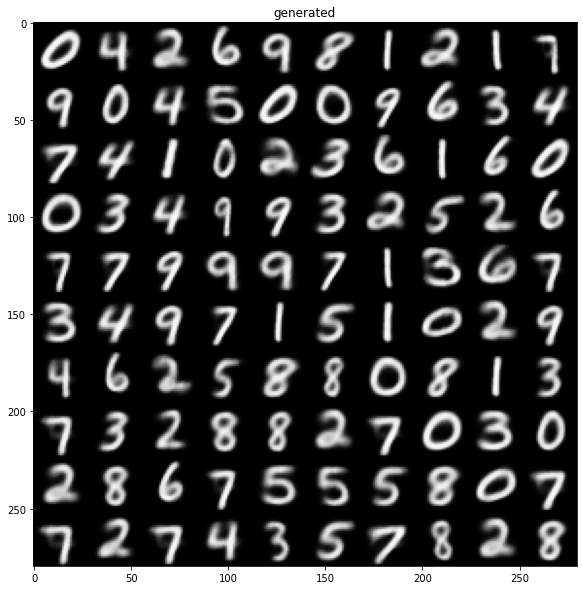

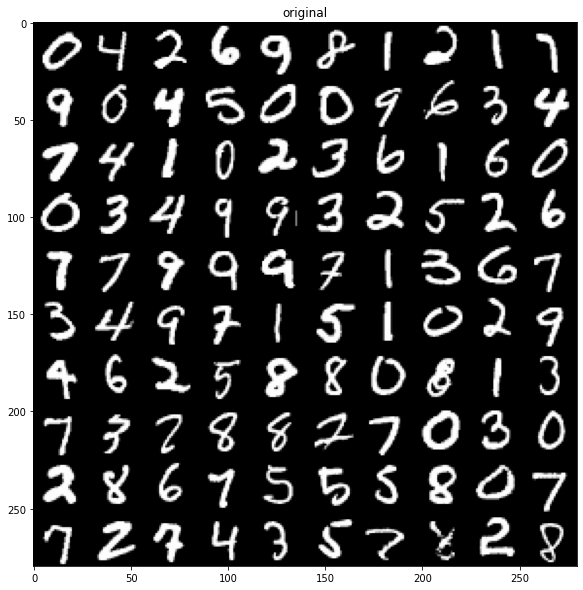

48000/48000 [==============================] - 2s 48us/sample - loss: 133.7586 - val_loss: 133.8474
Epoch 17/50
47104/48000 [============================>.] - ETA: 0s - loss: 133.5455

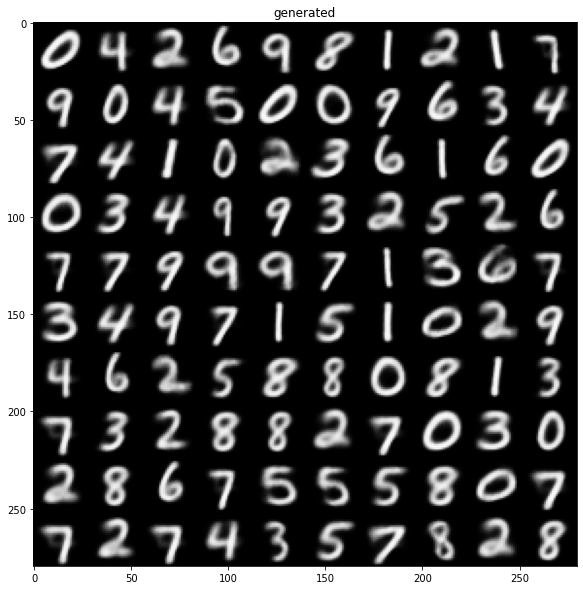

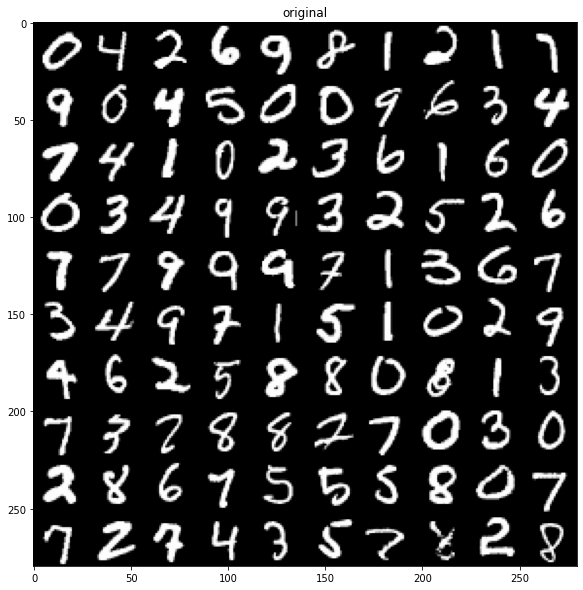

48000/48000 [==============================] - 3s 53us/sample - loss: 133.5082 - val_loss: 133.5112
Epoch 18/50
47104/48000 [============================>.] - ETA: 0s - loss: 133.2233

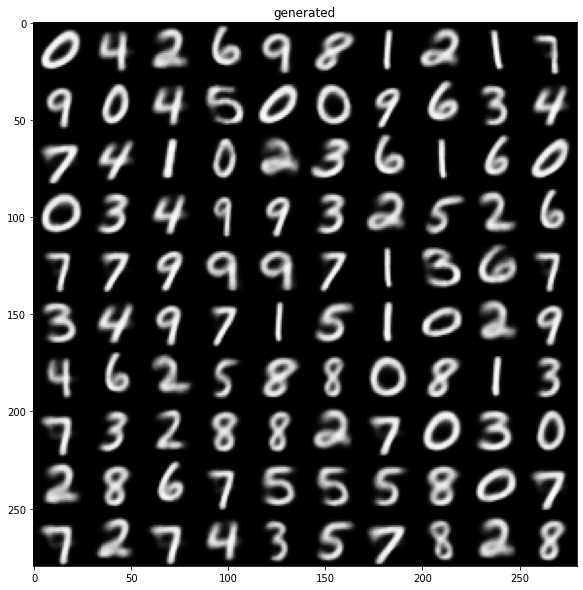

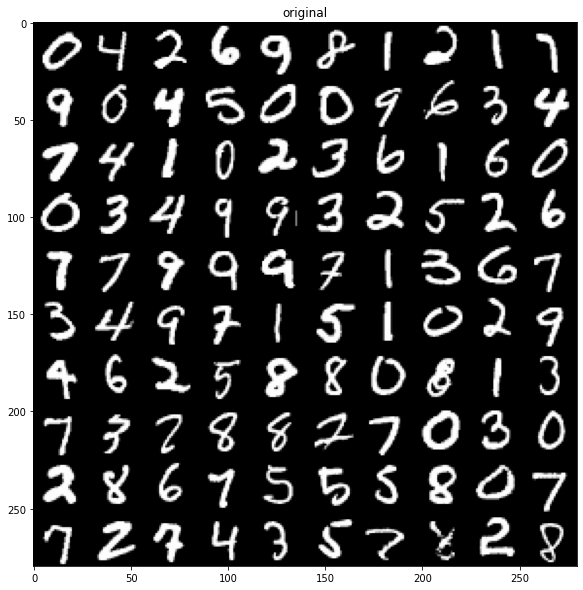

48000/48000 [==============================] - 2s 47us/sample - loss: 133.2340 - val_loss: 133.3930
Epoch 19/50
46080/48000 [===========================>..] - ETA: 0s - loss: 133.0335

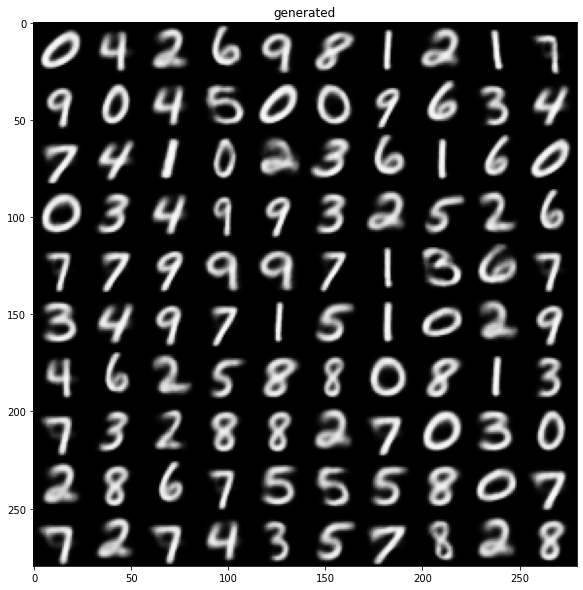

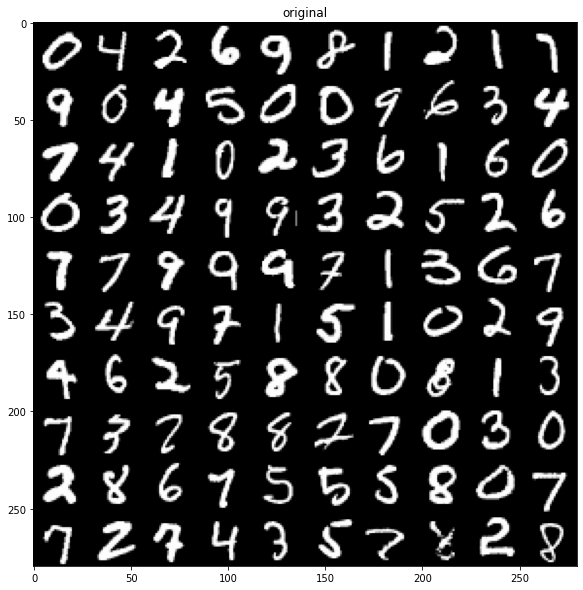

48000/48000 [==============================] - 2s 48us/sample - loss: 133.0000 - val_loss: 132.9525
Epoch 20/50
47104/48000 [============================>.] - ETA: 0s - loss: 132.8127

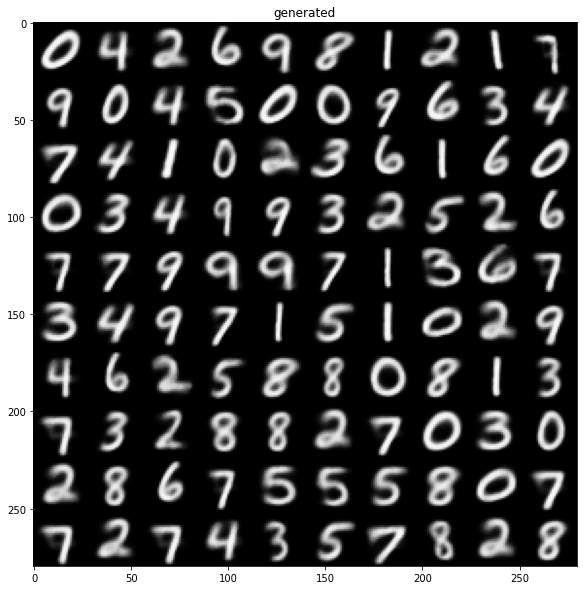

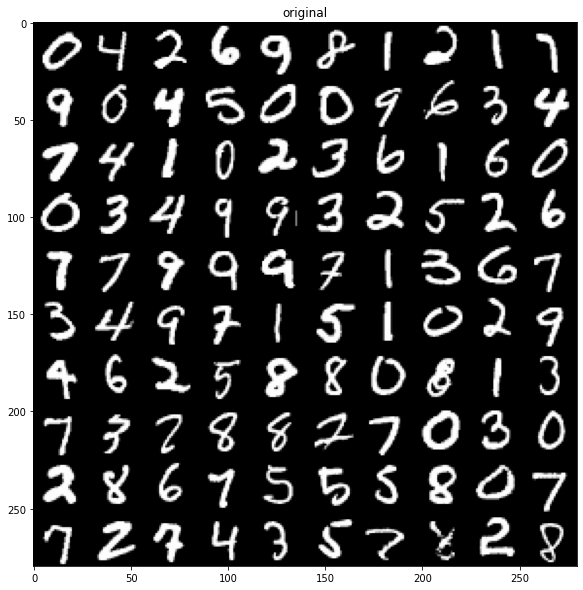

48000/48000 [==============================] - 2s 48us/sample - loss: 132.7929 - val_loss: 132.8242
Epoch 21/50
47104/48000 [============================>.] - ETA: 0s - loss: 132.6301

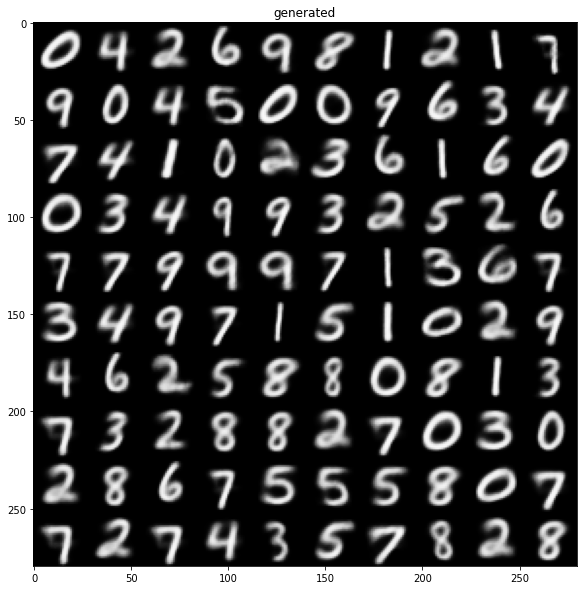

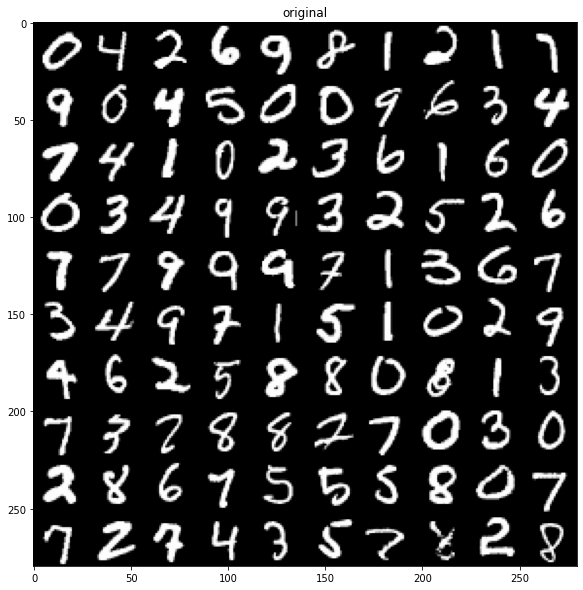

48000/48000 [==============================] - 2s 48us/sample - loss: 132.6098 - val_loss: 132.7379
Epoch 22/50
48000/48000 [==============================] - ETA: 0s - loss: 132.4074

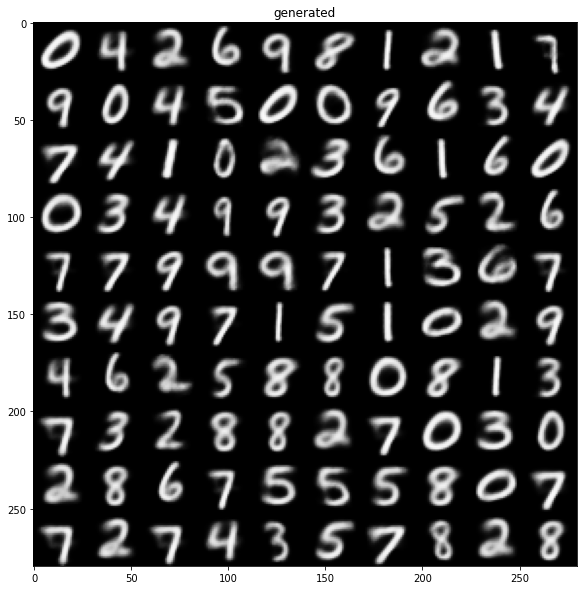

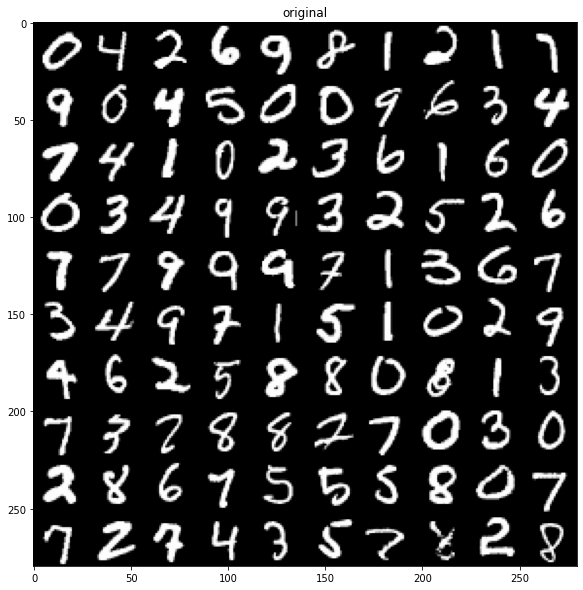

48000/48000 [==============================] - 2s 46us/sample - loss: 132.4074 - val_loss: 132.6282
Epoch 23/50
47872/48000 [============================>.] - ETA: 0s - loss: 132.2551

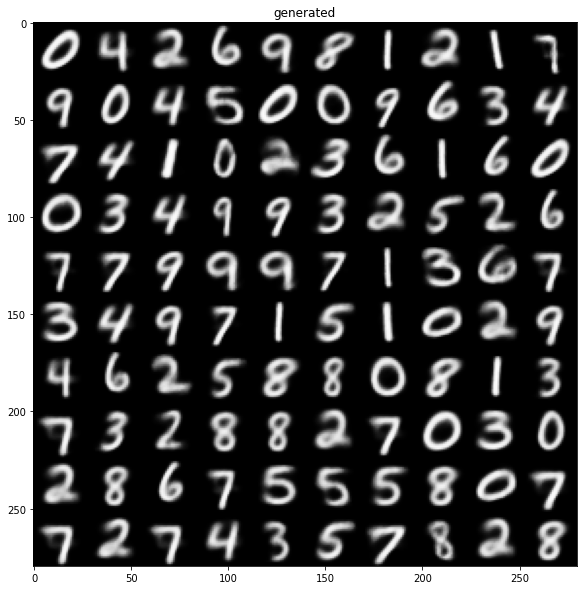

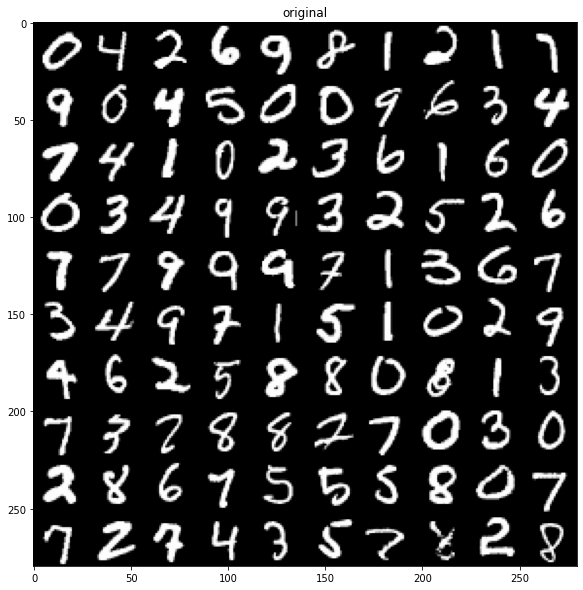

48000/48000 [==============================] - 2s 47us/sample - loss: 132.2430 - val_loss: 132.3594
Epoch 24/50
47104/48000 [============================>.] - ETA: 0s - loss: 132.1123

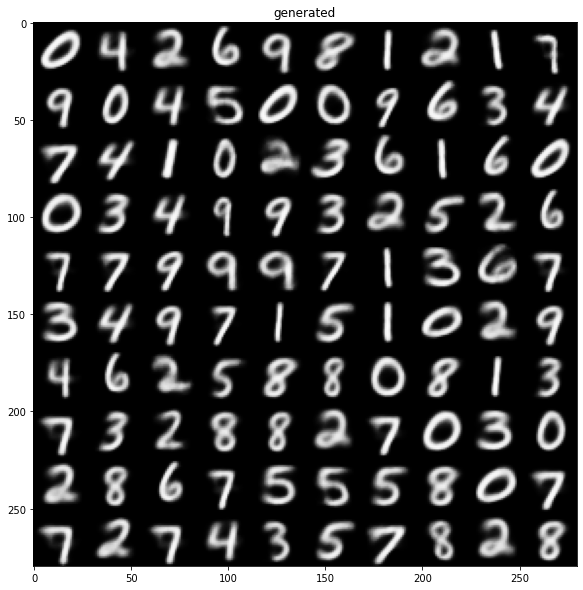

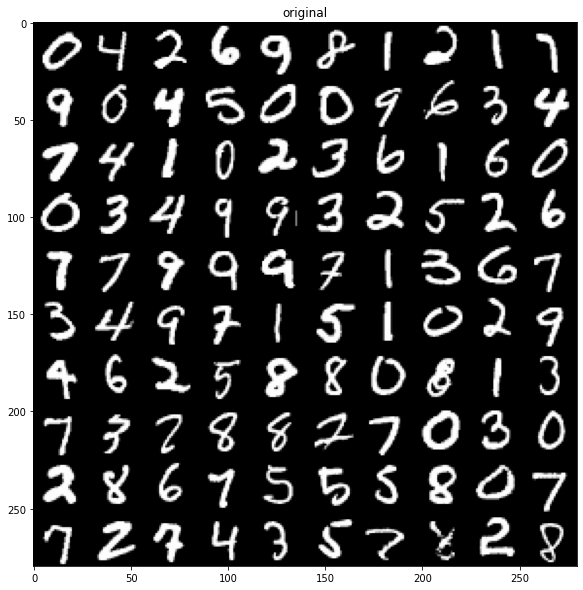

48000/48000 [==============================] - 2s 51us/sample - loss: 132.1052 - val_loss: 132.3886
Epoch 25/50
46848/48000 [============================>.] - ETA: 0s - loss: 131.9322

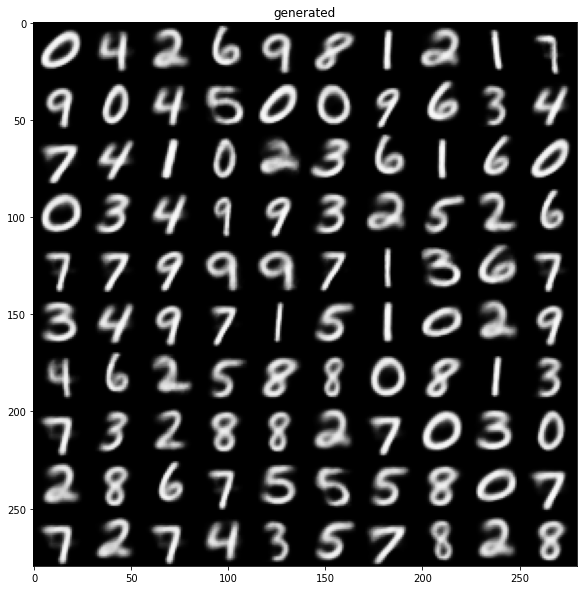

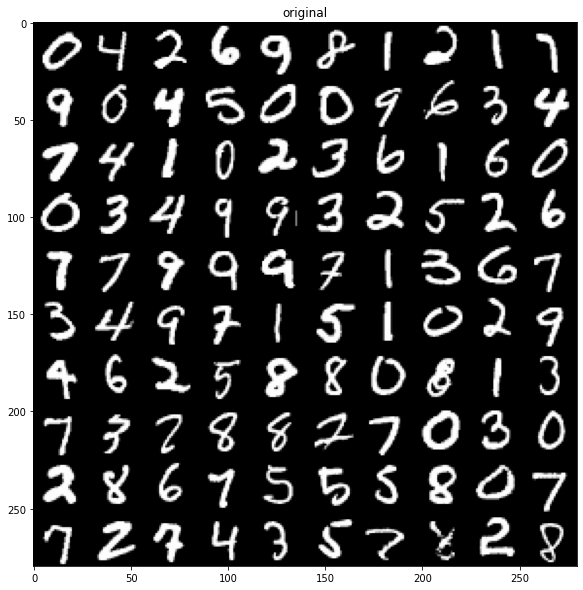

48000/48000 [==============================] - 3s 53us/sample - loss: 131.9356 - val_loss: 132.2095
Epoch 26/50
47360/48000 [============================>.] - ETA: 0s - loss: 131.8455

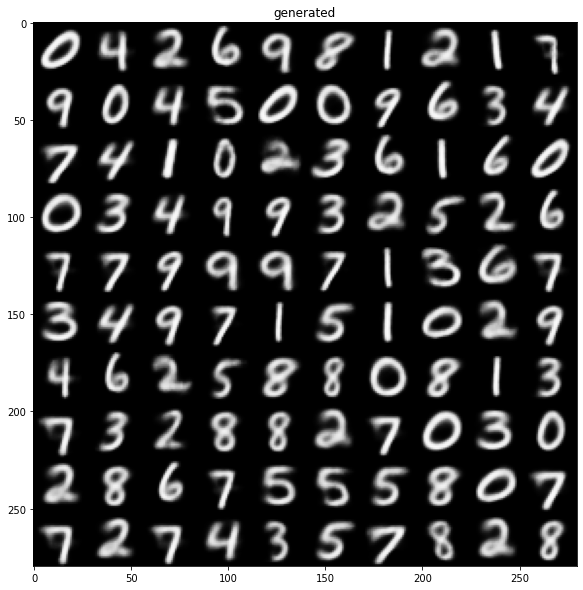

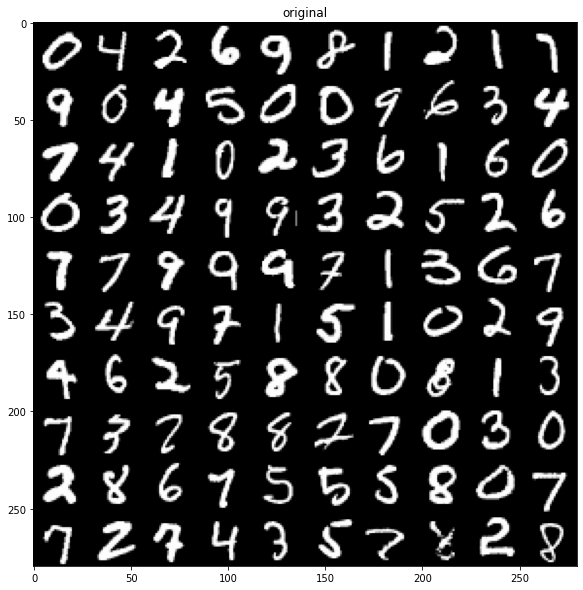

48000/48000 [==============================] - 2s 52us/sample - loss: 131.8226 - val_loss: 131.9765
Epoch 27/50
46848/48000 [============================>.] - ETA: 0s - loss: 131.6514

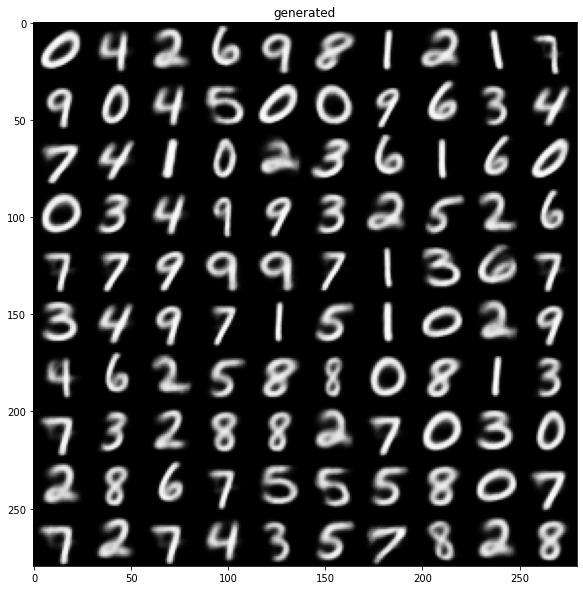

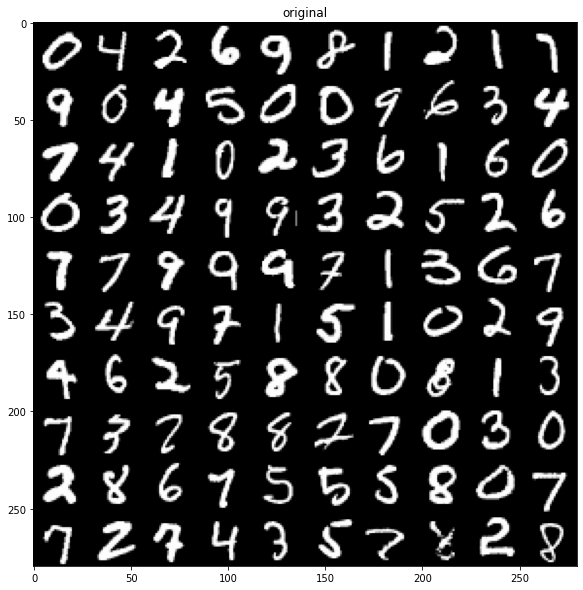

48000/48000 [==============================] - 3s 53us/sample - loss: 131.6878 - val_loss: 132.0174
Epoch 28/50
47616/48000 [============================>.] - ETA: 0s - loss: 131.5598

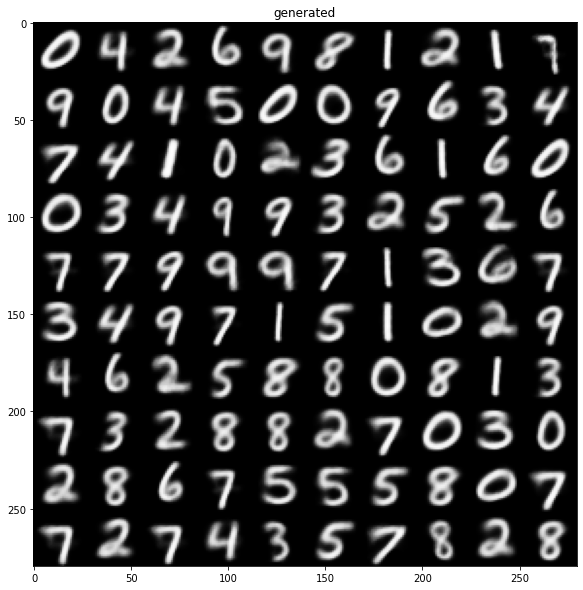

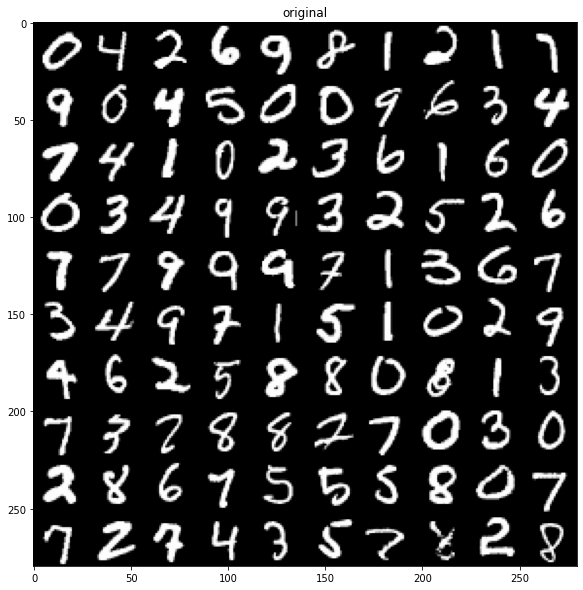

48000/48000 [==============================] - 2s 52us/sample - loss: 131.5569 - val_loss: 132.0583
Epoch 29/50
46336/48000 [===========================>..] - ETA: 0s - loss: 131.4318

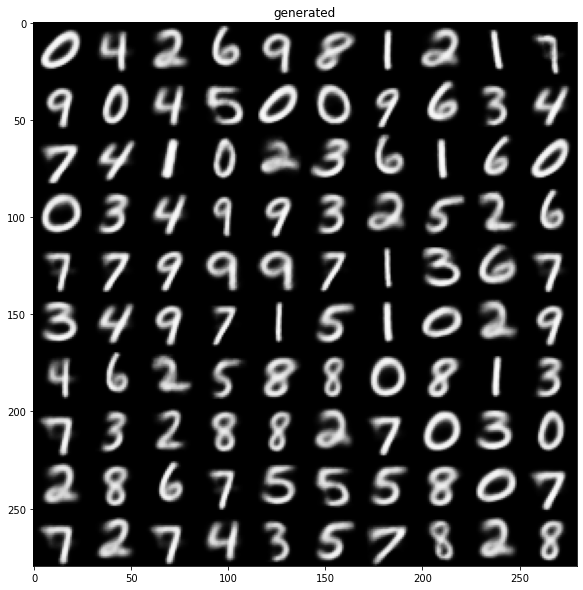

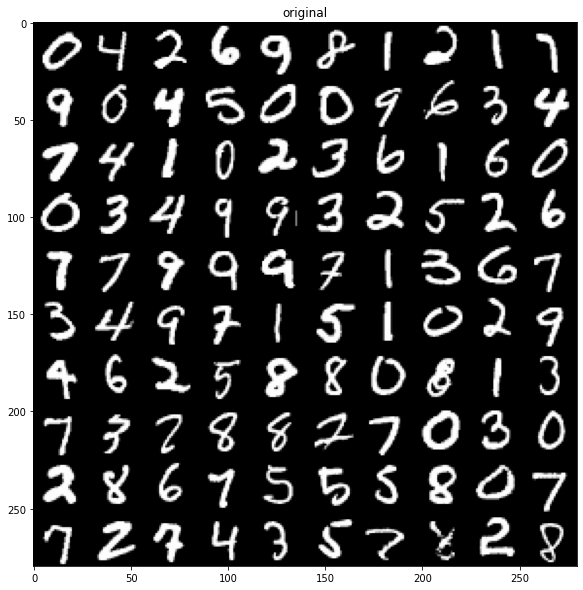

48000/48000 [==============================] - 2s 52us/sample - loss: 131.4329 - val_loss: 131.7426
Epoch 30/50
47104/48000 [============================>.] - ETA: 0s - loss: 131.3720

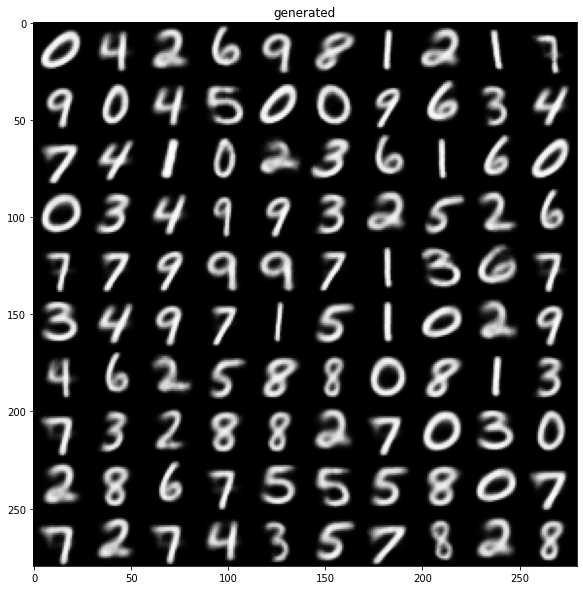

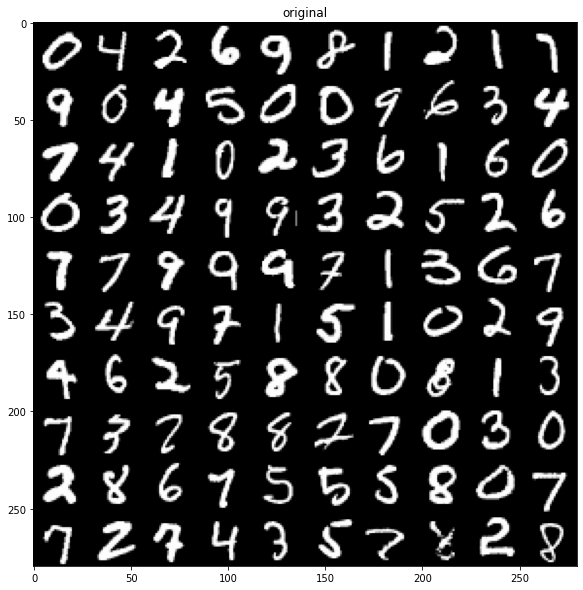

48000/48000 [==============================] - 3s 52us/sample - loss: 131.3064 - val_loss: 131.6045
Epoch 31/50
47616/48000 [============================>.] - ETA: 0s - loss: 131.2121

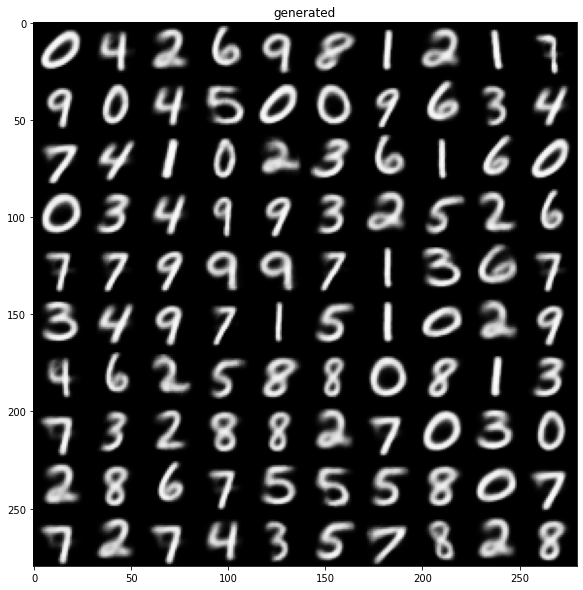

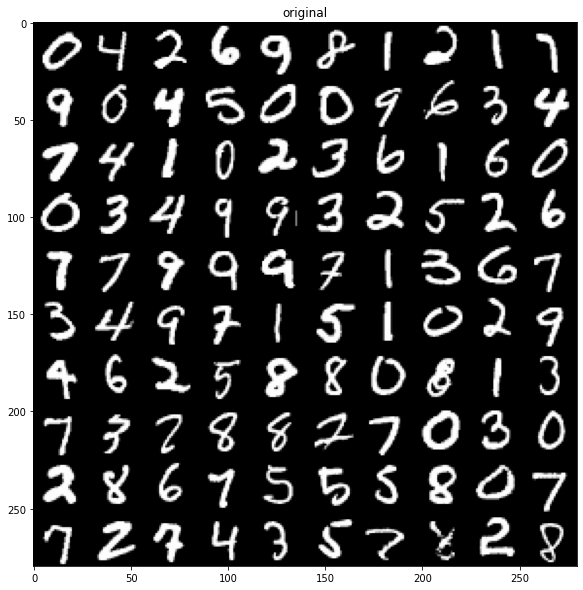

48000/48000 [==============================] - 2s 51us/sample - loss: 131.2021 - val_loss: 131.6401
Epoch 32/50
47360/48000 [============================>.] - ETA: 0s - loss: 131.0475

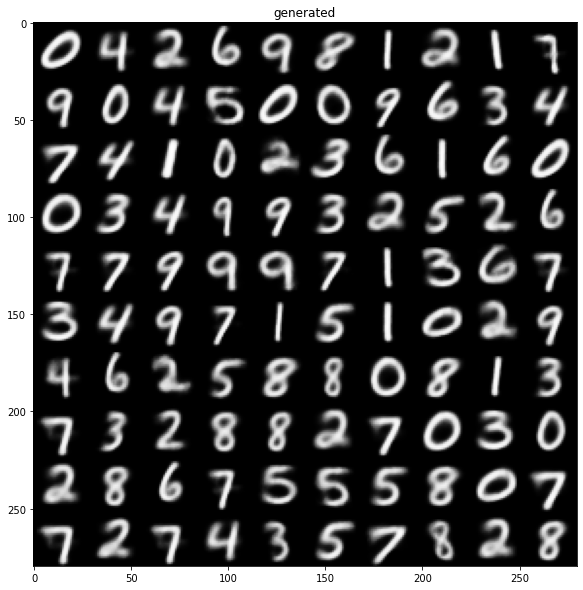

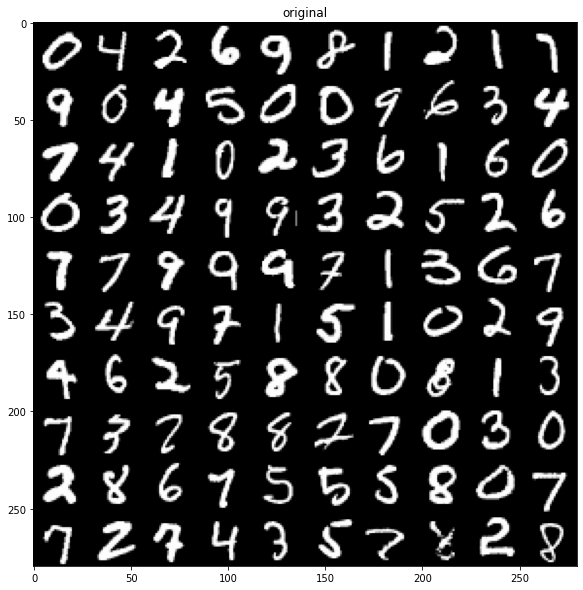

48000/48000 [==============================] - 3s 52us/sample - loss: 131.0926 - val_loss: 131.5187
Epoch 33/50
48000/48000 [==============================] - ETA: 0s - loss: 131.0114

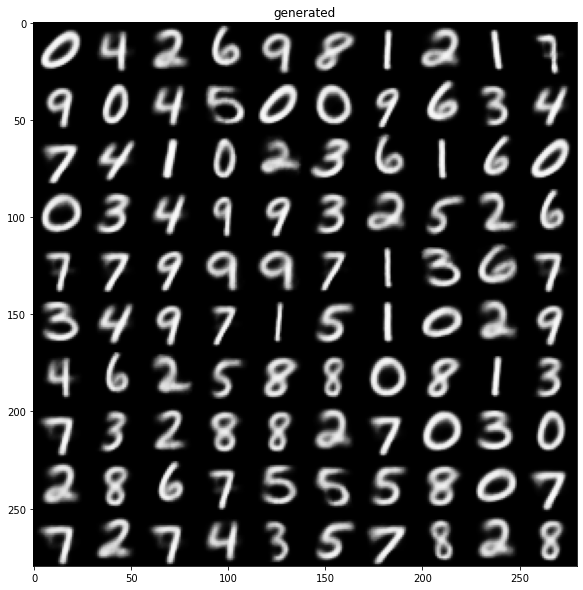

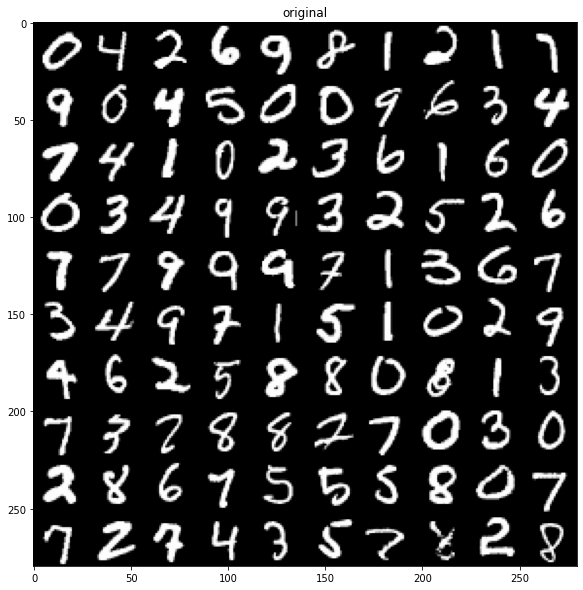

48000/48000 [==============================] - 2s 51us/sample - loss: 131.0114 - val_loss: 131.4300
Epoch 34/50
48000/48000 [==============================] - ETA: 0s - loss: 130.9186

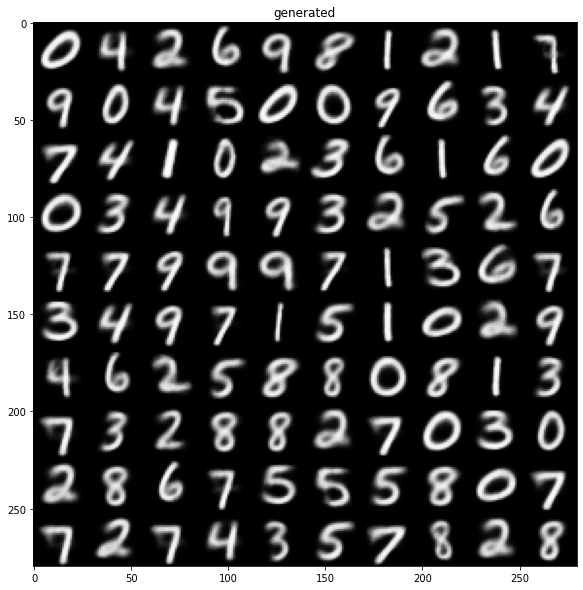

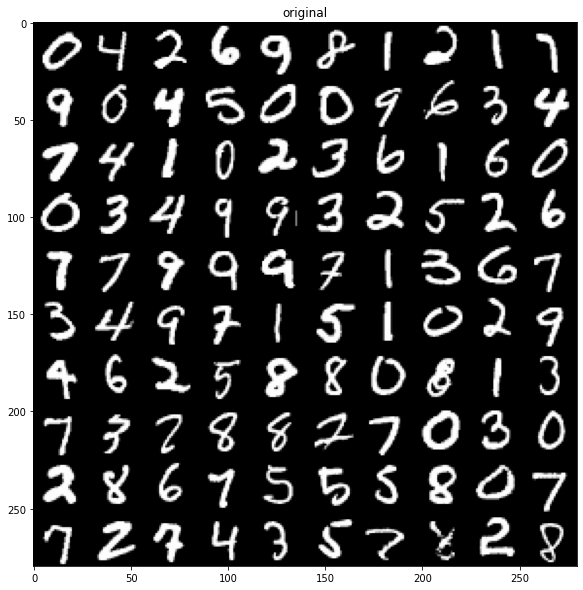

48000/48000 [==============================] - 2s 50us/sample - loss: 130.9186 - val_loss: 131.3391
Epoch 35/50
46336/48000 [===========================>..] - ETA: 0s - loss: 130.8565

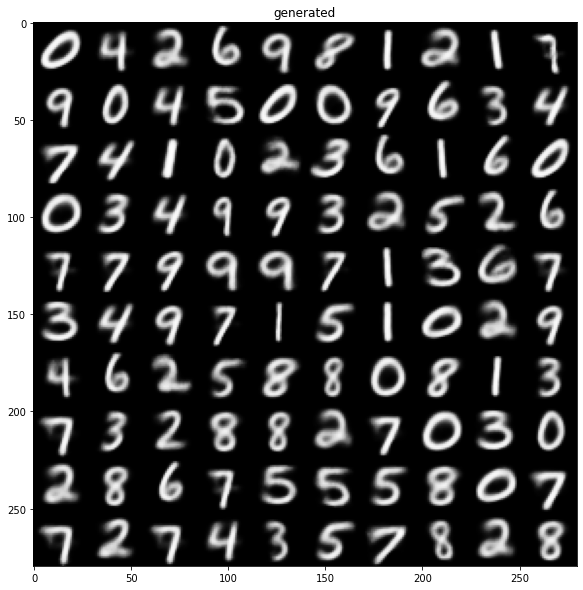

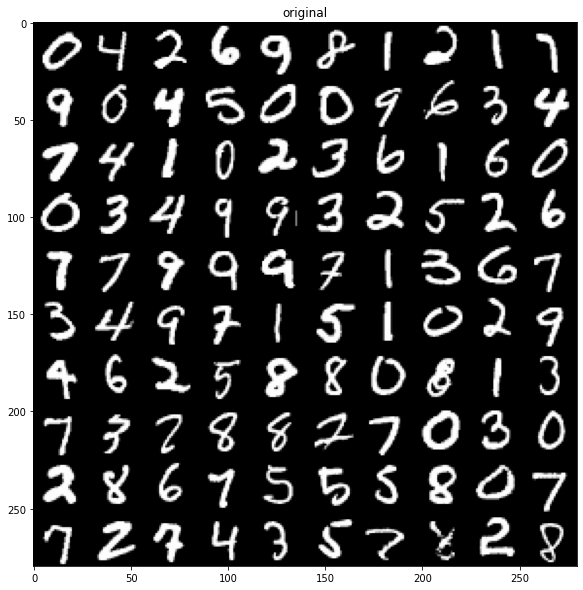

48000/48000 [==============================] - 2s 49us/sample - loss: 130.8340 - val_loss: 131.4461
Epoch 36/50
47616/48000 [============================>.] - ETA: 0s - loss: 130.7384

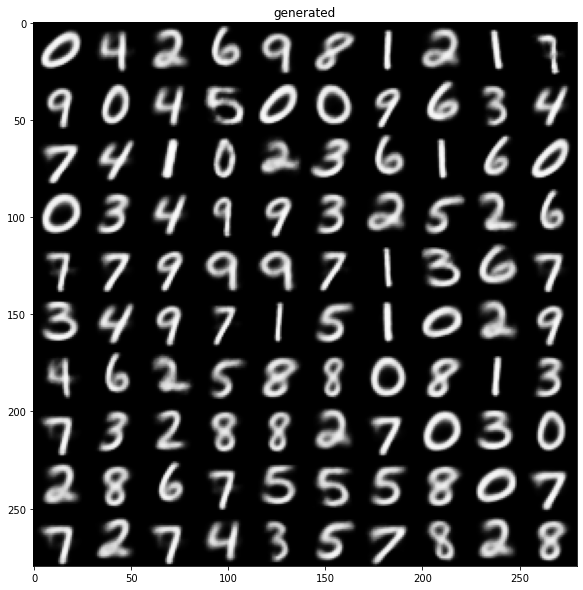

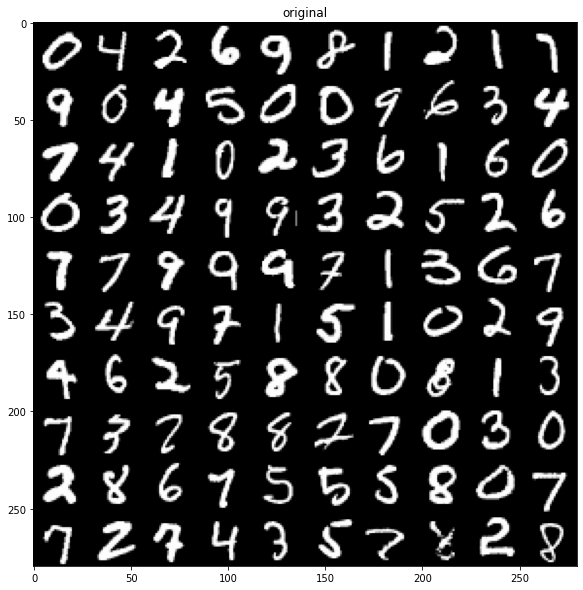

48000/48000 [==============================] - 2s 48us/sample - loss: 130.7512 - val_loss: 131.3620
Epoch 37/50
48000/48000 [==============================] - ETA: 0s - loss: 130.6825

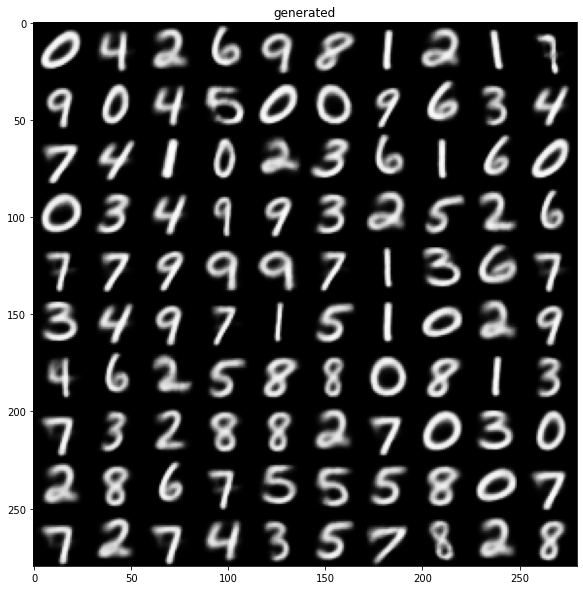

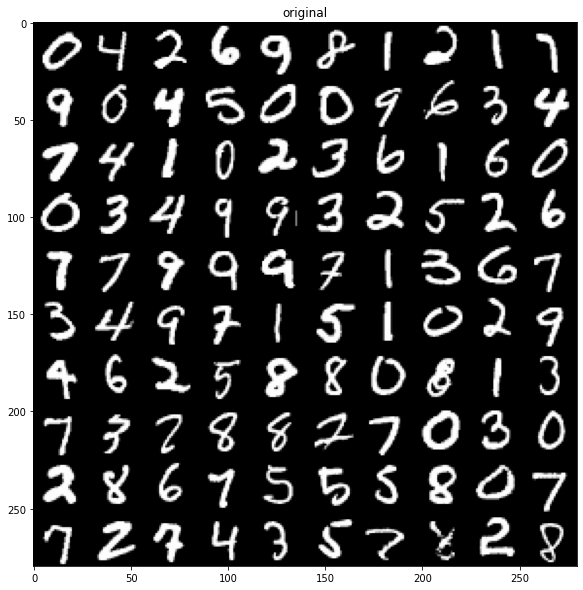

48000/48000 [==============================] - 2s 50us/sample - loss: 130.6825 - val_loss: 131.1420
Epoch 38/50
46848/48000 [============================>.] - ETA: 0s - loss: 130.5972

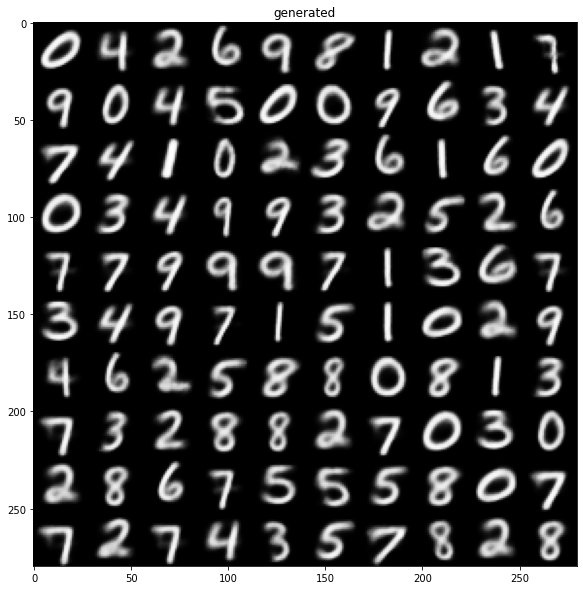

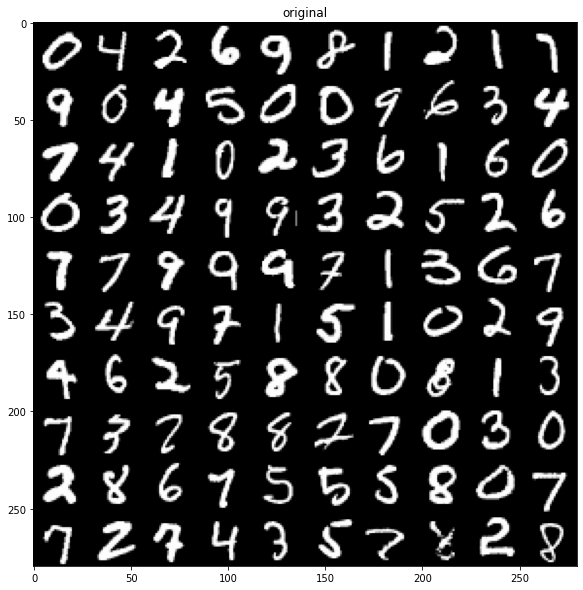

48000/48000 [==============================] - 2s 47us/sample - loss: 130.5995 - val_loss: 131.0797
Epoch 39/50
47872/48000 [============================>.] - ETA: 0s - loss: 130.5124

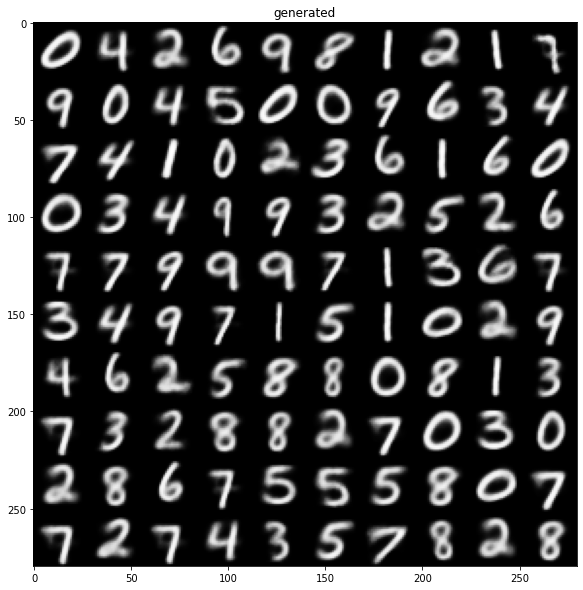

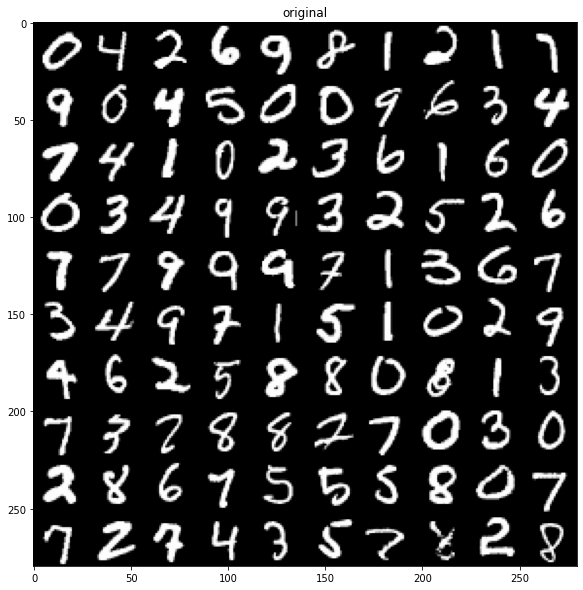

48000/48000 [==============================] - 2s 49us/sample - loss: 130.5211 - val_loss: 131.1770
Epoch 40/50
47360/48000 [============================>.] - ETA: 0s - loss: 130.4042

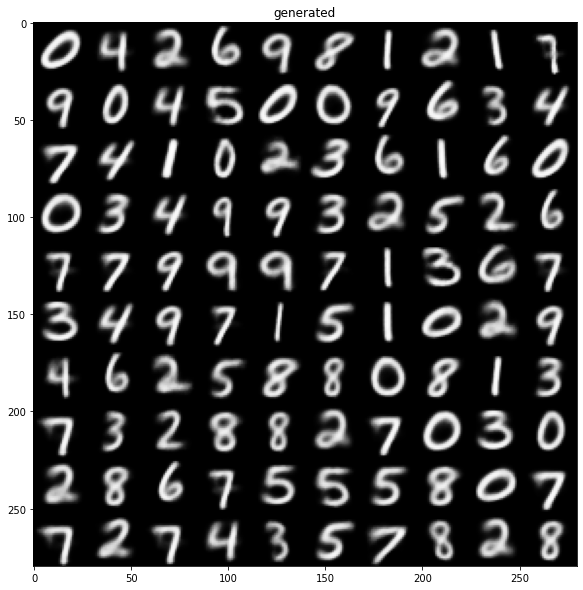

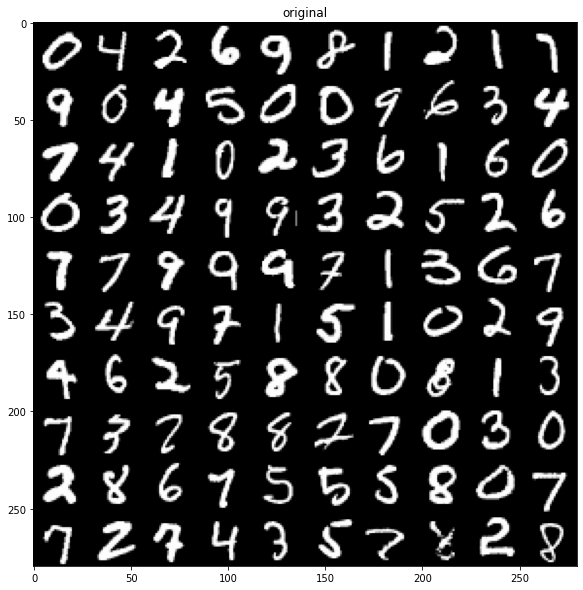

48000/48000 [==============================] - 3s 56us/sample - loss: 130.4160 - val_loss: 131.0993
Epoch 41/50
46080/48000 [===========================>..] - ETA: 0s - loss: 130.4794

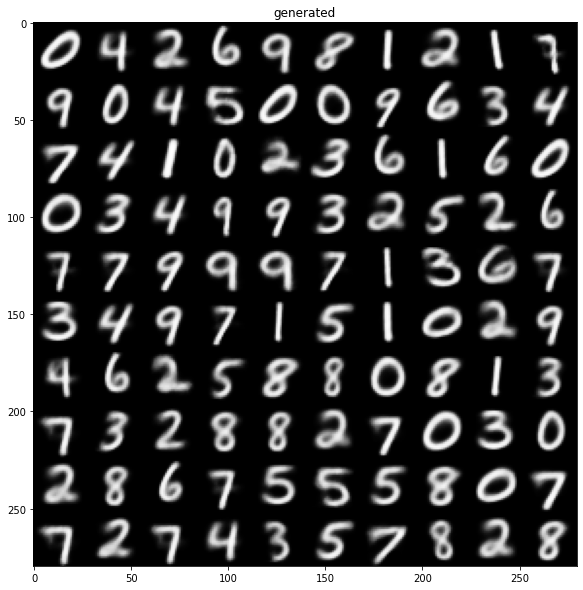

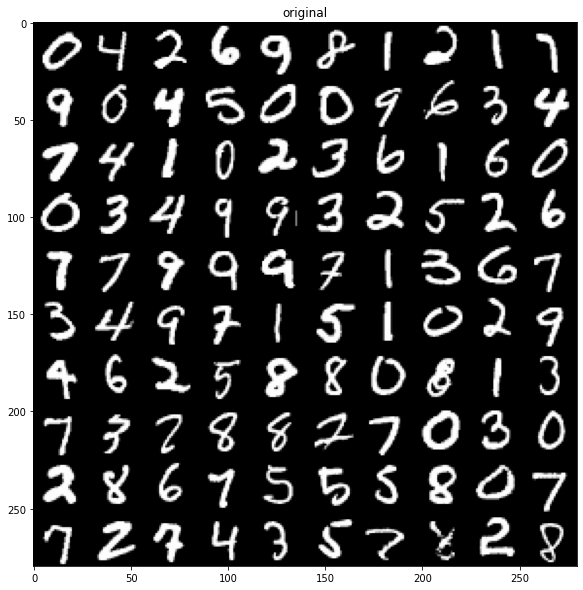

48000/48000 [==============================] - 2s 49us/sample - loss: 130.4055 - val_loss: 131.0632
Epoch 42/50
47872/48000 [============================>.] - ETA: 0s - loss: 130.2804

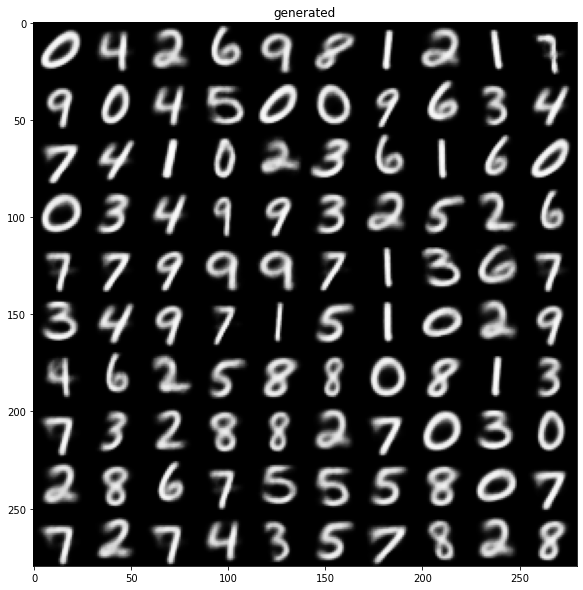

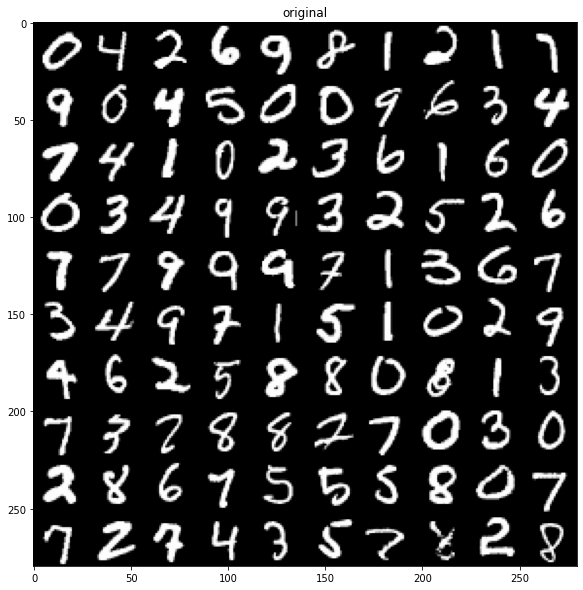

48000/48000 [==============================] - 2s 47us/sample - loss: 130.2769 - val_loss: 130.9544
Epoch 43/50
47360/48000 [============================>.] - ETA: 0s - loss: 130.2158

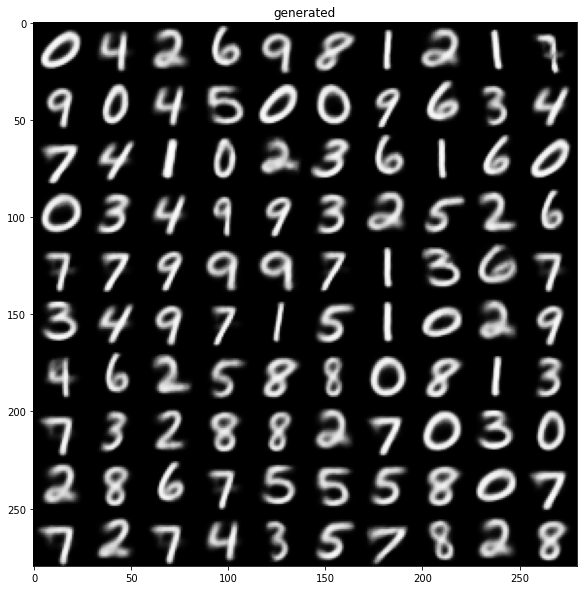

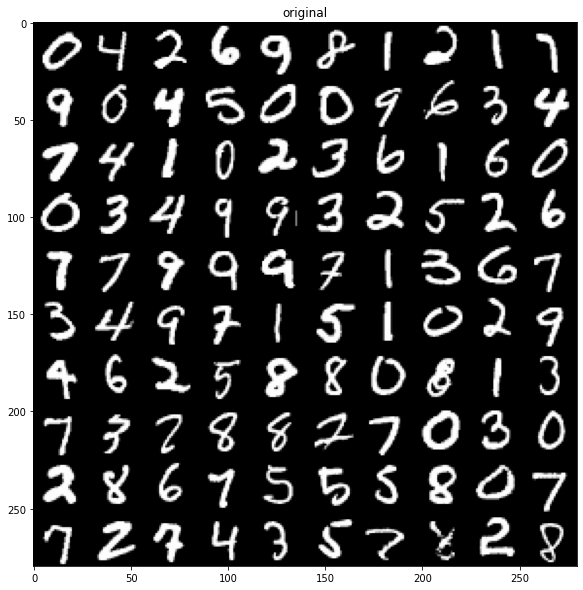

48000/48000 [==============================] - 2s 49us/sample - loss: 130.2257 - val_loss: 130.9659
Epoch 44/50
46592/48000 [============================>.] - ETA: 0s - loss: 130.0881

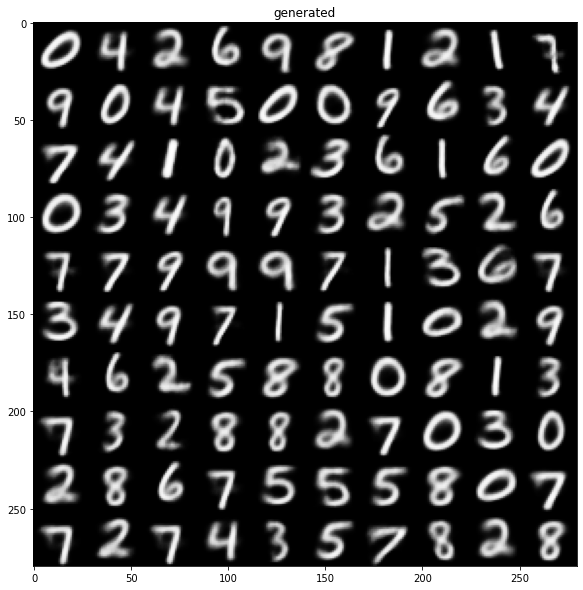

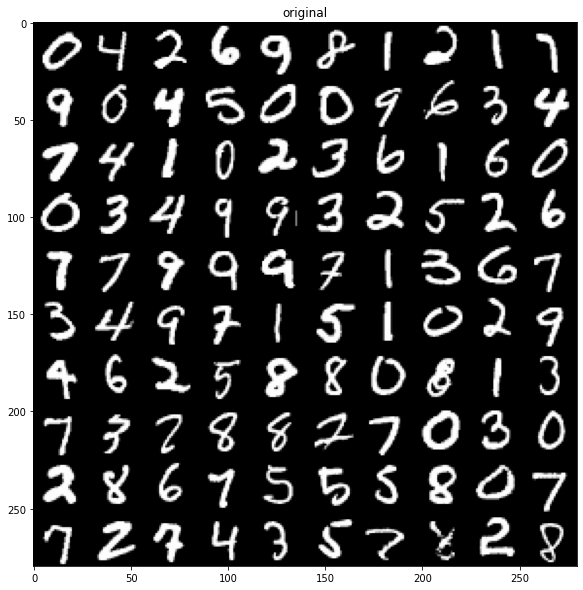

48000/48000 [==============================] - 2s 48us/sample - loss: 130.1622 - val_loss: 130.8817
Epoch 45/50
47616/48000 [============================>.] - ETA: 0s - loss: 130.0924

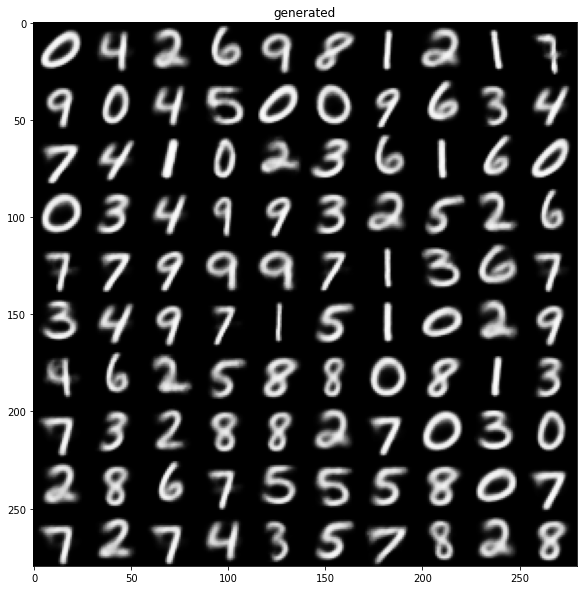

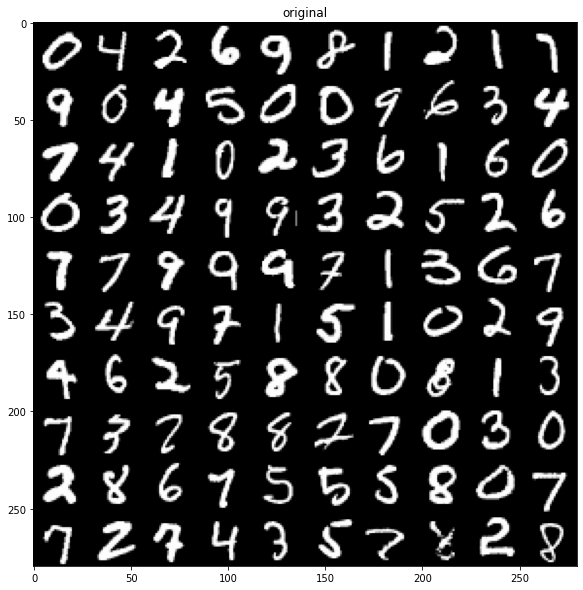

48000/48000 [==============================] - 2s 48us/sample - loss: 130.0983 - val_loss: 130.9069
Epoch 46/50
47104/48000 [============================>.] - ETA: 0s - loss: 130.0703

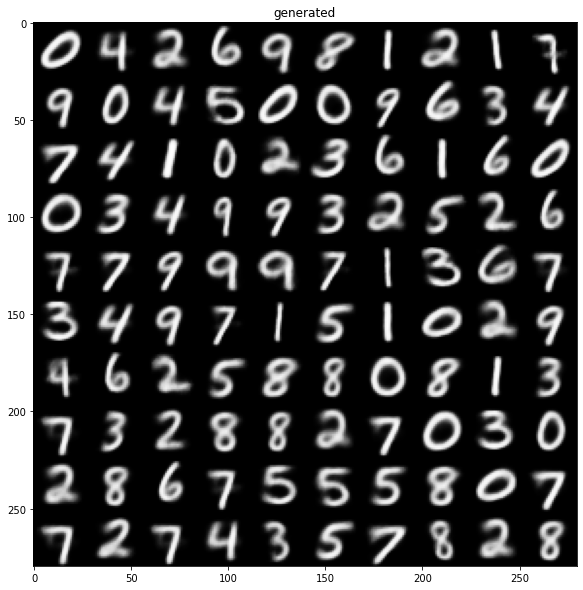

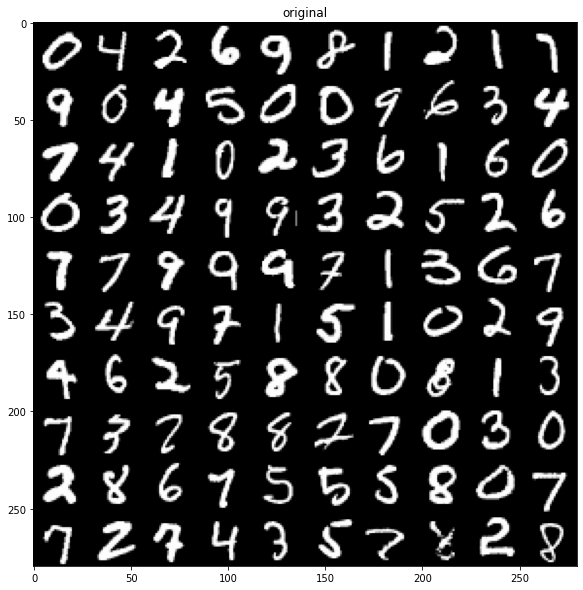

48000/48000 [==============================] - 2s 48us/sample - loss: 130.0209 - val_loss: 130.8057
Epoch 47/50
46336/48000 [===========================>..] - ETA: 0s - loss: 129.9723

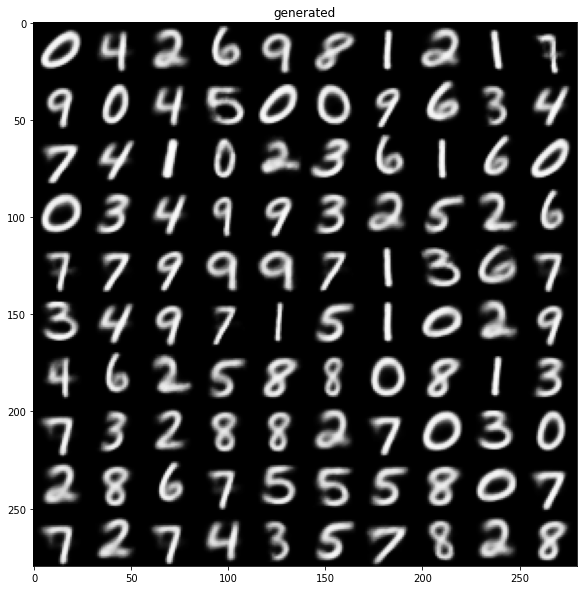

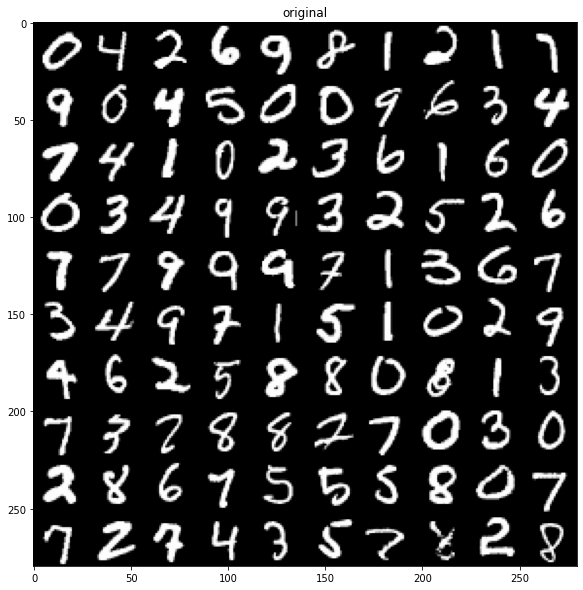

48000/48000 [==============================] - 2s 48us/sample - loss: 129.9889 - val_loss: 130.9329
Epoch 48/50
47360/48000 [============================>.] - ETA: 0s - loss: 129.9183

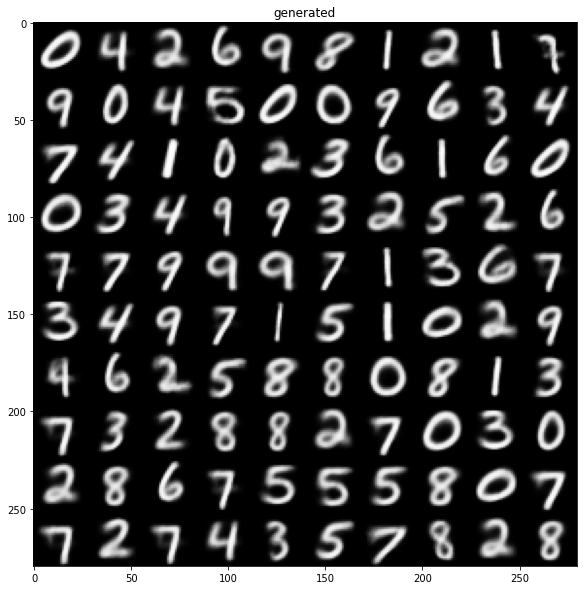

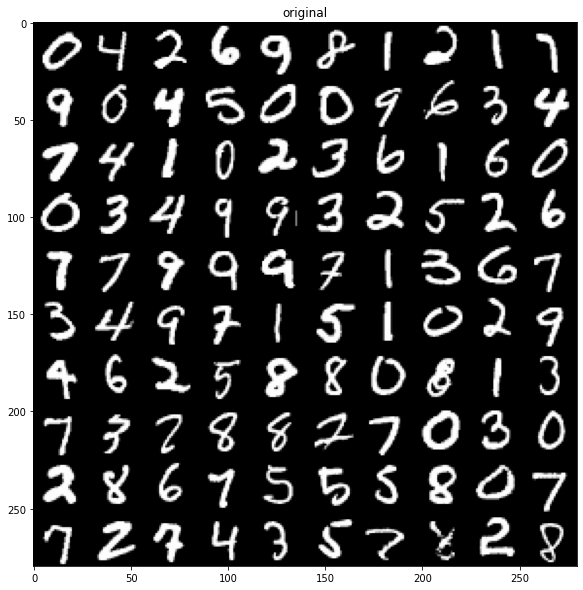

48000/48000 [==============================] - 2s 50us/sample - loss: 129.9299 - val_loss: 130.7922
Epoch 49/50
47360/48000 [============================>.] - ETA: 0s - loss: 129.8686

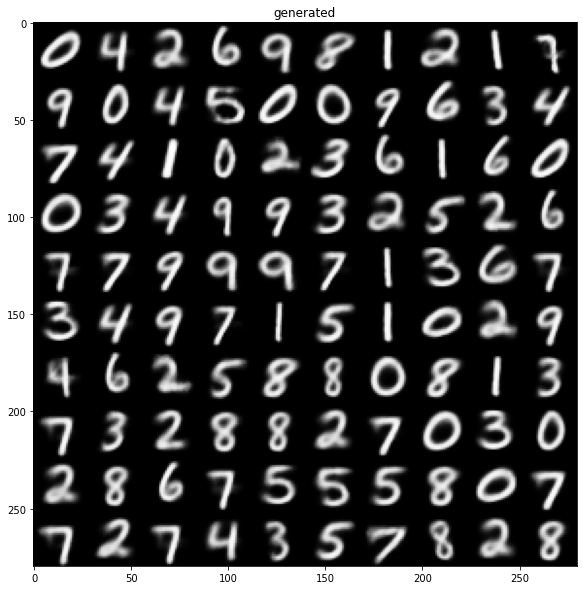

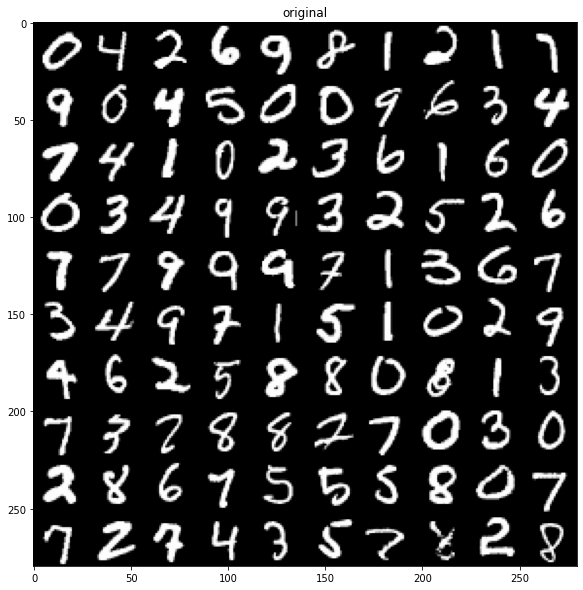

48000/48000 [==============================] - 2s 48us/sample - loss: 129.8414 - val_loss: 130.7673
Epoch 50/50
46336/48000 [===========================>..] - ETA: 0s - loss: 129.8487

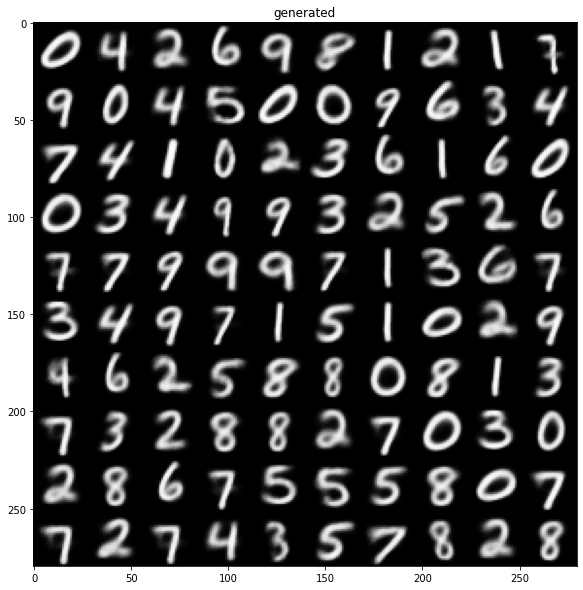

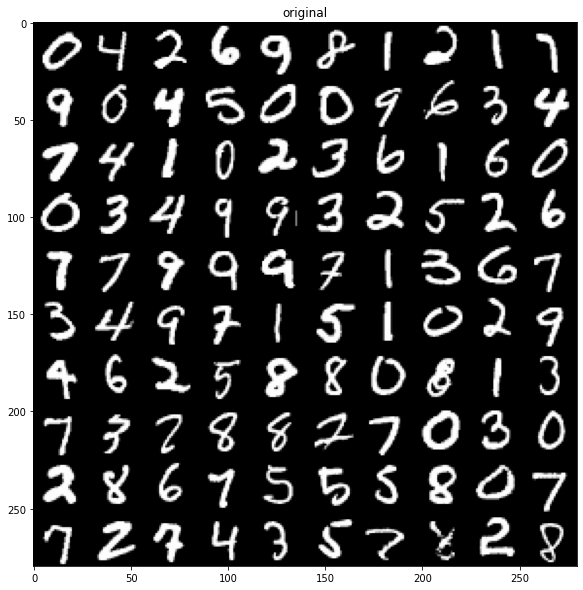

48000/48000 [==============================] - 2s 48us/sample - loss: 129.8177 - val_loss: 130.7622


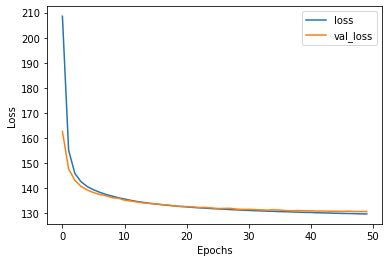

In [ ]:
C_VAE.compile(optimizer='adam', loss=kl_reconstruction_loss, experimental_run_tf_function=False)
Trained_model = C_VAE.fit([train_data, onehot_train_lable], train_data, epochs = 50, batch_size = 256, validation_split = 0.2, callbacks=[PerformanceCheck(True)])

history = Trained_model.history
losses=history['loss']
val_losses=history['val_loss']

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.plot(losses)
plt.plot(val_losses)
plt.legend(['loss','val_loss'])

## Visualizations
using the previous function for visualiztion, we first plotted the 2-D latent space of our model and then we plot a conditioned-sample of generated numbers using this architecture which is conditioned by number 4.

(60000, 2)
(60000,)


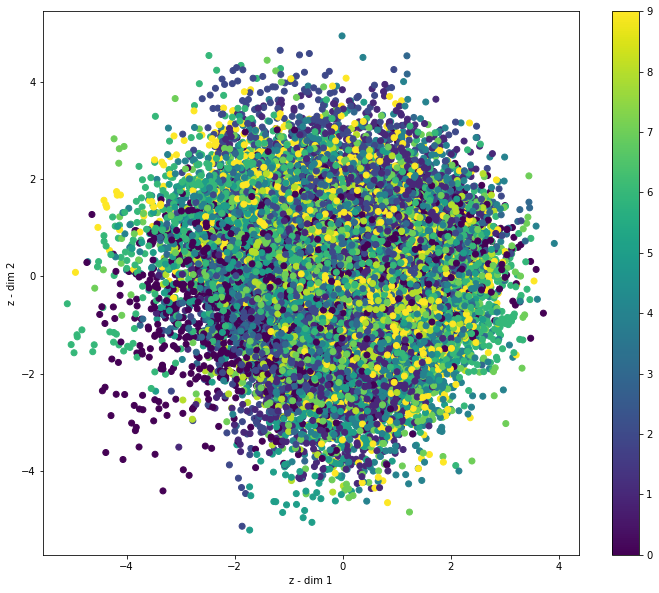

In [ ]:
vizualization_latent_space(encoder, [train_data, onehot_train_lable], train_lable)

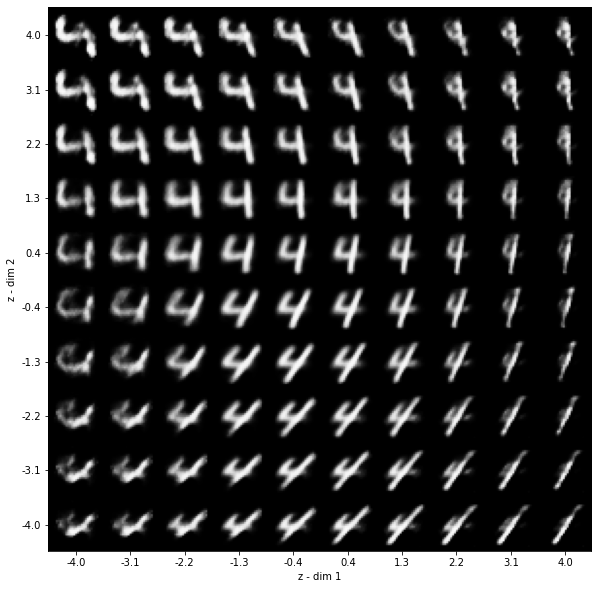

In [ ]:
vizualization_decoded(decoder, conditional=True, condition=4)